In [245]:
%load_ext autoreload
%autoreload 1
%autosave 60

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


Autosaving every 60 seconds


In [3]:
import sys
import pandas as pd
import numpy as np
import importlib
import matplotlib.pyplot as plt
import matplotlib.colors as clr
from scipy import stats
import sklearn
from sklearn.decomposition import PCA
from sklearn.mixture import GaussianMixture
import scanpy
from anndata import AnnData
import umap
import anndata
from matplotlib.colors import LogNorm, PowerNorm

In [4]:
scanpy.__version__

'1.8.1'

In [5]:
sys.path.append("/u/davidm/Documents/Master-thesis/Scripts/RNA-seq/python/")
# sys.path.append("/u/davidm/DoubletDetection/")

In [155]:
import rnaseq
importlib.reload(rnaseq)

<module 'rnaseq' from '/u/davidm/Documents/Master-thesis/Scripts/RNA-seq/python/rnaseq/__init__.py'>

In [433]:
sample = "Sample_N701_-_Not_Transfected"
sample = "Sample_N705_-_ER1"
# sample = "Sample_N707_-_ER2"
# sample = "Sample_N702_-_CTR1"
sample = "Sample_EV_N707_NEWsample"
# sample ="Sample_PMIG_N701"
# sample = "Sample_GRLH2_N712"
new_sample_name = "MCF7-labo-nt"
quant_params = "trimmed-reads-cutadapt/pc-decoys-k31-1.4.0/customWh-top-3000-noWh"
quant_params = "trimmed-reads-cutadapt/decoys-k31-1.4.0/customWh-top-3000-noWh"
quant_params = "trimmed-reads-cutadapt/pc-EGFP-decoys-k31-1.4.0/customWh-top-3000-noWh"

# quant_params = "trimmed-reads-cutadapt/decoys-k31-1.4.0/customWh-top-3000-noWh"

genref = "human/assembly__GRCh38-hg38/annotation__gencode/gencode_34"
project = "dsp779"
project = "dsp1090"
cell_line="MCF7"
cond = "nt"

### Plotting parameters

In [9]:
%matplotlib inline
plt.rcParams['figure.dpi'] = 110

### Gene lists

In [236]:
cell_cycle_genes = np.array(['MCM5', 'PCNA', 'TYMS', 'FEN1', 'MCM2', 'MCM4', 'RRM1', 'UNG',
       'GINS2', 'MCM6', 'CDCA7', 'DTL', 'PRIM1', 'UHRF1', 'HELLS', 'RFC2',
       'RPA2', 'NASP', 'RAD51AP1', 'GMNN', 'WDR76', 'SLBP', 'CCNE2',
       'UBR7', 'POLD3', 'MSH2', 'ATAD2', 'RAD51', 'RRM2', 'CDC45', 'CDC6',
       'EXO1', 'TIPIN', 'DSCC1', 'BLM', 'CASP8AP2', 'USP1', 'CLSPN',
       'POLA1', 'CHAF1B', 'BRIP1', 'E2F8', 'HMGB2', 'CDK1', 'NUSAP1',
       'UBE2C', 'BIRC5', 'TPX2', 'TOP2A', 'NDC80', 'CKS2', 'NUF2',
       'CKS1B', 'MKI67', 'TMPO', 'CENPF', 'TACC3', 'SMC4', 'CCNB2',
       'CKAP2L', 'CKAP2', 'AURKB', 'BUB1', 'KIF11', 'ANP32E', 'TUBB4B',
       'GTSE1', 'KIF20B', 'HJURP', 'CDCA3', 'CDC20', 'TTK', 'CDC25C',
       'KIF2C', 'RANGAP1', 'NCAPD2', 'DLGAP5', 'CDCA2', 'CDCA8', 'ECT2',
       'KIF23', 'HMMR', 'AURKA', 'PSRC1', 'ANLN', 'LBR', 'CKAP5', 'CENPE',
       'CTCF', 'NEK2', 'G2E3', 'GAS2L3', 'CBX5', 'CENPA'])

s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]

In [2457]:
apop_sig = "AIFM1,AKT1,AKT2,AKT3,APAF1,ATM,BAD,BAX,BCL2,BCL2L1,BID,BIRC2,BIRC3,CAPN1,CAPN2,CASP10,CASP3,CASP6,CASP7,CASP8,CASP9,CFLAR,CHP1,CHP2,CHUK,CSF2RB,CYCS,DFFA,DFFB,ENDOD1,ENDOG,EXOG,FADD,FAS,FASLG,IKBKB,IKBKG,IL1A,IL1B,IL1R1,IL1RAP,IL3,IL3RA,IRAK1,IRAK2,IRAK3,IRAK4,MAP3K14,MYD88,NFKB1,NFKBIA,NGF,NTRK1,PIK3CA,PIK3CB,PIK3CD,PIK3CG,PIK3R1,PIK3R2,PIK3R3,PIK3R5,PPP3CA,PPP3CB,PPP3CC,PPP3R1,PPP3R2,PRKACA,PRKACB,PRKACG,PRKAR1A,PRKAR1B,PRKAR2A,PRKAR2B,PRKX,RELA,RIPK1,TNF,TNFRSF10A,TNFRSF10B,TNFRSF10C,TNFRSF10D,TNFRSF1A,TNFSF10,TP53,TRADD,TRAF2,XIAP".split(',')

In [1791]:
pa_sig = "NEAT1,S100A10,GPRC5A,TMSB4X,VMP1,SH3BGRL3,RHOC,SOX4,RPS19,MALAT1,CDKN1A,FTH1,ID3,RPL13A,ACTG1,RPL34,BTG1,RPS18,RPL28,PCSK1N,FTL,RPS12,RPL32,ZFAS1,OCIAD2,RPL39,PNRC1,RPL11,TPT1,ZNF217,CLTB,RPL37,KRT80,PABPC1,RPL24,KRT7,RPLP1,ZFP36L2,PMEPA1,RPL35A,S100A6,RPL12,TNFRSF12A,CD24,EEF1A1,ANXA2,TMSB10,RPL26,KRT17,RPL30,RPL15,RPS15A,RAB32,MYH9,EEF2,BRI3".split(',')

In [2219]:
hallmark = pd.read_table("./hallmark.gmt", index_col=0, names=range(400))

In [361]:
loc = pd.read_table("./c1.all.v7.4.symbols.gmt", names=range(400), index_col=0)

In [2202]:
%%bash

pwd

/u/davidm/Documents/Master-thesis/Projects/scBC-Analysis/0_Preprocessing/1_Cells-filtering/dsp779


### Raw CB frequency

In [7]:
y = pd.read_table(f"/home/arion/davidm/Data/datasets/raw/private/RNA-seq/sc/{project}/quant/alevin/{genref}/{quant_params}/{sample}/alevin/raw_cb_frequency.txt", header=None)[1]

FileNotFoundError: [Errno 2] No such file or directory: '/home/arion/davidm/Data/datasets/raw/private/RNA-seq/sc/dsp779/quant/alevin/human/assembly__GRCh38-hg38/annotation__gencode/gencode_34/raw-reads/pc-decoys-k31-1.4.0/customWh-top-3000-noWh/Sample_N701_-_Not_Transfected/alevin/raw_cb_frequency.txt'

In [ ]:
plt.title(f"{new_sample_name} \n Raw library sizes distribution")
plt.ylim(0,2600);
plt.xlabel("# reads associated with a CB")
plt.ylabel("# cellular barcodes (CB)")
rnaseq.plotting.loghist(y, bins=300, color = "lightslategray")

In [ ]:
x = pd.read_table(f"/home/arion/davidm/Data/datasets/raw/private/RNA-seq/sc/{project}/quant/alevin/{genref}/{quant_params}/{sample}/alevin/featureDump.txt")

In [ ]:
plt.title(f"{new_sample_name} \n Library sizes distribution after CB correction")
plt.xlabel("# reads associated with a CCB")
plt.ylabel("# corrected cellular barcodes (CCB)")
rnaseq.plotting.loghist(x["CorrectedReads"], bins=150, color = "lightslategray")

In [ ]:
plt.title(f"{new_sample_name} \n Library sizes distribution after CB correction \n and mapping")
plt.xlabel("# mapped reads associated with a CCB")
plt.ylabel("# corrected cellular barcodes (CCB)")
rnaseq.plotting.loghist(x["MappedReads"], bins=100, color = "lightslategray")

In [ ]:
plt.title(f"{new_sample_name} \n Library sizes distribution after CB correction, \n mapping and UMI deduplication")
plt.xlabel("# UMIs associated with a CCB")
plt.ylabel("# corrected cellular barcodes (CCB)")
rnaseq.plotting.loghist(x["DeduplicatedReads"], bins=150, color = "lightslategray")

In [ ]:
plt.title(f"{new_sample_name} \n Deduplication rate")
plt.xlabel("# UMIs associated with a CCB")
plt.ylabel("# corrected cellular barcodes (CCB)")
plt.hist(x["DedupRate"], bins=150, color = "lightslategray");

In [ ]:
i = x["DedupRate"]<0.5
plt.title(f"{new_sample_name} \n Library sizes distribution after CB correction, \n mapping and UMI deduplication")
plt.xlabel("# UMIs associated with a CCB")
plt.ylabel("# corrected cellular barcodes (CCB)")
rnaseq.plotting.loghist(x["DeduplicatedReads"][~i], bins=150, color = "lightslategray")

### Loading raw count matrix

In [156]:
from scipy.sparse import csr_matrix
# umiDedup-NoDedup.mtx
solo_path = "/home/arion/davidm/Data/datasets/raw/private/RNA-seq/sc/dsp779/quant/star_solo/human/assembly__GRCh38-hg38/annotation__gencode/gencode_34/trimmed-reads/Dedup_1MM_Directional_UMItools/Sample_N705_-_ER1/Solo.out/Gene/raw"
x = csr_matrix(rnaseq.readwrite.read_mtx(f"{solo_path}/umiDedup-1MM_Directional_UMItools.mtx").T)
genes = pd.read_table(f"{solo_path}/features.tsv", header=None)
cb = pd.read_table(f"{solo_path}/barcodes.tsv", header=None)

sc = rnaseq.setup.AnnData(X = x, obs = {"CB":cb[0].values}, var = {"ensembl_gene_id" : genes[0].values, "external_gene_name" : genes[1].values})
rnaseq.setup.setup_anndata(sc, cdna="3' tag")
sc.var["ensembl_gene_id"] = [g.split(".")[0] for g in sc.var["ensembl_gene_id"]]

Using BioMart Ensembl Genes 100 hsapiens_gene_ensembl for gene annotations.


In [157]:
sc.layers["no_dedup"] = csr_matrix(rnaseq.readwrite.read_mtx(f"{solo_path}/umiDedup-NoDedup.mtx").T)
sc.obs["dedup_per_cell"] = 1 - (sc.layers["raw"].toarray().sum(1)/ sc.layers["no_dedup"].toarray().sum(1))
sc.var["dedup_per_gene"] = 1 - (sc.layers["raw"].toarray().sum(0)/ sc.layers["no_dedup"].toarray().sum(0))

solo_path = "/home/arion/davidm/Data/datasets/raw/private/RNA-seq/sc/dsp779/quant/star_solo/human/assembly__GRCh38-hg38/annotation__gencode/gencode_34/trimmed-reads/Dedup_1MM_Directional_UMItools/Sample_N705_-_ER1/Solo.out/Velocyto/raw"
sc.layers["unspliced"] = csr_matrix(rnaseq.readwrite.read_mtx(f"{solo_path}/unspliced.mtx").T)
sc.obs["tot_unspliced"] = sc.layers["unspliced"].toarray().sum(1)
sc.layers["spliced"] = csr_matrix(rnaseq.readwrite.read_mtx(f"{solo_path}/spliced.mtx").T)
sc.obs["tot_spliced"] = sc.layers["spliced"].toarray().sum(1)

/tmp/ipykernel_53977/3401289595.py:2: RuntimeWarning: invalid value encountered in true_divide
  sc.obs["dedup_per_cell"] = 1 - (sc.layers["raw"].toarray().sum(1)/ sc.layers["no_dedup"].toarray().sum(1))
/tmp/ipykernel_53977/3401289595.py:3: RuntimeWarning: invalid value encountered in true_divide
  sc.var["dedup_per_gene"] = 1 - (sc.layers["raw"].toarray().sum(0)/ sc.layers["no_dedup"].toarray().sum(0))


In [434]:
sc = rnaseq.readwrite.read_raw(project_id  = project, quant_tool = "alevin", samples = sample, genes_id = "ensembl_gene_id", quant_params = quant_params, genref = genref, cdna = "3' tag", exp = "sc")
# sc._inplace_subset_obs(np.argsort(sc.obs["raw_cb_freq"].values)[::-1][:1000])
sc.obs_names = sc.obs["CB"]

Using BioMart Ensembl Genes 100 hsapiens_gene_ensembl for gene annotations.


In [ ]:
# rnaseq.utils.show_biomart(sc.uns["biomart_server"], sc.uns["biomart_dataset"])

In [161]:
rnaseq.setup.annotate_genes(sc, "gene_biotype")

Annotating gene_biotype using Biomart (Ensembl Genes 100, 'hsapiens_gene_ensembl')...


In [2830]:
# sc._inplace_subset_var([not g.startswith('RP') for g in sc.var["external_gene_name"]]);

In [3237]:
# sc._inplace_subset_var([b == "protein_coding" for b in sc.var["gene_biotype"]]);

In [ ]:
np.unique(sc.var["gene_biotype"])

In [435]:
# rnaseq.setup.annotate_samples(sc, samples_annot_name = "conditions", samples_annot = cond)
# rnaseq.setup.annotate_samples(sc, samples_annot_name = "cell_lines", samples_annot = cell_line)
# rnaseq.setup.annotate_samples(sc, samples_annot_name = "source", samples_annot = "labo")
rnaseq.setup.annotate_samples(sc, samples_annot_name = "samples", samples_annot = new_sample_name, ow = True)

# rnaseq.setup.load_layer(sc,"raw")
rnaseq.setup.annotate_samples(sc, samples_annot_name = "total_UMIs", samples_annot = sc.X.toarray().sum(1).ravel())
rnaseq.setup.annotate_samples(sc, samples_annot_name = "#_genes", samples_annot = (sc.X.toarray() != 0).sum(1).ravel())
rnaseq.setup.annotate_samples(sc, samples_annot_name = "max_corr")
rnaseq.setup.annotate_samples(sc, samples_annot_name = "mt_frac")
rnaseq.setup.annotate_samples(sc, samples_annot_name = "rp_frac")

Annotating samples...
Annotating total_UMIs...
Annotating #_genes...
Annotating max_corr...
Normalization by total UMIs...
Log2 + 1 tranformation...
Annotating mt_frac...
Annotating chromosome_name using Biomart (Ensembl Genes 100, 'hsapiens_gene_ensembl')...
Annotating rp_frac...
Annotating external_gene_name using Biomart (Ensembl Genes 100, 'hsapiens_gene_ensembl')...


In [562]:
from Levenshtein import distance as levenshtein_distance

barcodes = sc.obs_names

neighbors_mtx = np.empty((len(barcodes), len(barcodes)))  
for i in range(len(neighbors_mtx)) :
    barcode1 = sc.obs["CB"].values[i]
    neighbors_mtx[i] = [barcode2 != barcode1 and (hammingDist(barcode1, barcode2) == 2 \
                            or (levenshtein_distance(barcode1[:-1], barcode2) == 1) \
                            or (levenshtein_distance(barcode1, barcode2[:-1]) == 1)) for barcode2 in sc.obs_names]
neighbors_mtx = pd.DataFrame(neighbors_mtx, columns = barcodes, index = barcodes, dtype=int)

In [563]:
sc.obs["nn"] = neighbors_mtx.sum(1)

In [439]:
sc._inplace_subset_obs(sc.obs["total_UMIs"]>400)

In [458]:
sc._inplace_subset_obs(sc.obs["MappingRate"]>0.6)

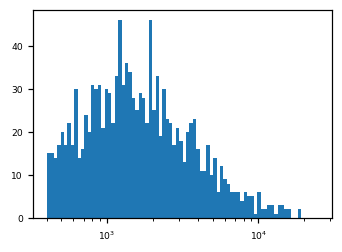

In [440]:
rnaseq.plotting.loghist(sc.obs["total_UMIs"][sc.obs["total_UMIs"]!=0]);

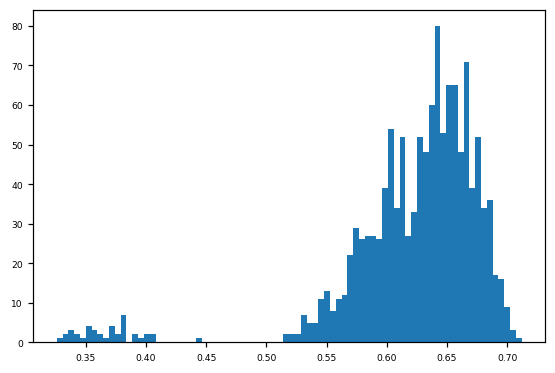

In [520]:
plt.hist(sc.obs["DedupRate"],bins=80);

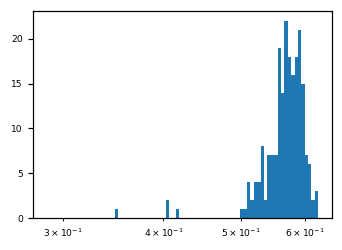

In [418]:
rnaseq.plotting.loghist(sc.obs["MappingRate"]);

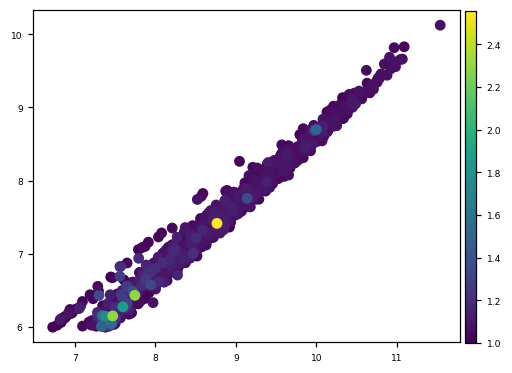

In [559]:
rnaseq.plotting.scatter(np.log(sc.obs["CorrectedReads"]), np.log(sc.obs["total_UMIs"]), s = 50,\
                        color = sc.obs["CorrectedReads"]/sc.obs["raw_cb_freq"],\
                        order_color  = "ascending", figsize=(5,4), linewidth=0)
# plt.colorbar()
# plt.title("rp frac")
# plt.xscale('log')
# plt.yscale('log')
# plt.xlabel("reads")
# plt.ylabel("umis")
# plt.ylim(300,50000)

(300, 30000)

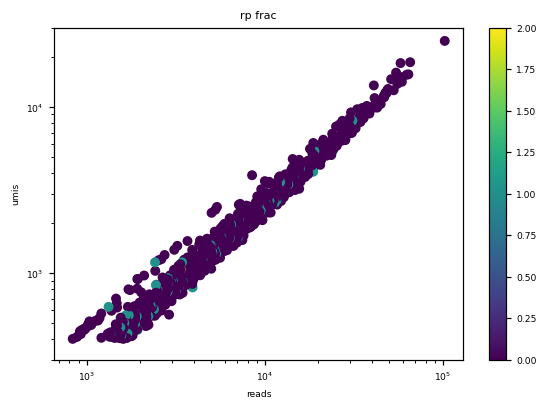

In [564]:
plt.scatter(sc.obs["CorrectedReads"], sc.obs["total_UMIs"], s = 30, c = sc.obs["nn"])
plt.colorbar()
plt.title("rp frac")
plt.xscale('log')
plt.yscale('log')
plt.xlabel("reads")
plt.ylabel("umis")
plt.ylim(300,30000)

In [559]:
# sc.obs["lnc_frac"] = sc.X.toarray()[:,sc.var["gene_biotype"] == "lncRNA"].sum(1) / sc.obs["total_UMIs"]

In [1599]:
from sklearn.mixture import GaussianMixture
from sklearn.linear_model import LogisticRegressionCV


# rnaseq.pp.filter_cells(sc, n_counts_min = 100, inplace = True)

gm_umis = GaussianMixture(2)
gm_umis.fit(sc.obs["total_UMIs"].values.reshape(-1,1))

gm_mt = GaussianMixture(2)
gm_mt.fit(sc.obs["mt_frac"].values.reshape(-1,1))

GaussianMixture(n_components=2)

In [1512]:
probs_umis = gm_umis.predict_proba(sc.obs["total_UMIs"].values.reshape(-1,1)).T
prob_umis_low = probs_umis[np.argmin(gm_umis.means_.ravel())]
th_umi_low = gm_umis.weights_[np.argmin(gm_umis.means_.ravel())]
prob_umis_high = probs_umis[np.argmax(gm_umis.means_.ravel())]
th_umi_high = gm_umis.weights_[np.argmax(gm_umis.means_.ravel())]

probs_mt = gm_mt.predict_proba(sc.obs["mt_frac"].values.reshape(-1,1)).T
prob_mt_low = probs_mt[np.argmax(gm_mt.means_.ravel())]
th_mt_low = gm_mt.weights_[np.argmax(gm_mt.means_.ravel())]
prob_mt_high = probs_mt[np.argmin(gm_mt.means_.ravel())]
th_mt_high = gm_mt.weights_[np.argmin(gm_mt.means_.ravel())]

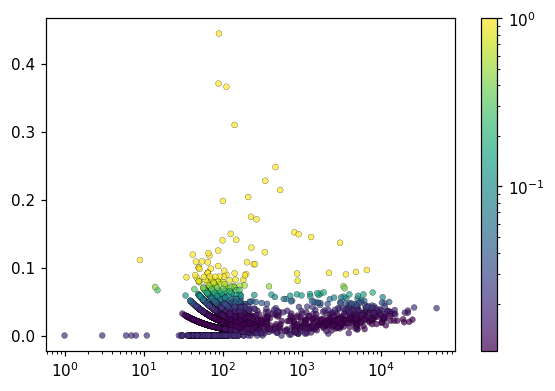

In [1279]:
x = sc.obs["total_UMIs"].values
y = sc.obs["mt_frac"].values

plt.scatter(x, y, s=15, c=prob_mt_low, cmap = my_cmap, norm=LogNorm(), linewidths = 0.15, edgecolor="black")
plt.xscale('log')
plt.colorbar()

In [289]:
gm_mt.weights_

array([0.73152184, 0.26847816])

In [290]:
gm_umis.weights_

array([0.61276218, 0.38723782])

In [1182]:
# import math

# prop_umi_low = gm_umis.weights_[np.argmin(gm_umis.means_.ravel())] - 0.1
# num_umi_low = math.ceil(len(sc.obs)*prop_umi_low)
# prop_umi_high = gm_umis.weights_[np.argmax(gm_umis.means_.ravel())] - 0.1
# num_umi_high = math.ceil(len(sc.obs)*prop_umi_high)

# prop_mt_low = gm_mt.weights_[np.argmax(gm_mt.means_.ravel())] - 0.1
# num_mt_low = math.ceil(len(sc.obs)*prop_mt_low)
# prop_mt_high = gm_mt.weights_[np.argmin(gm_mt.means_.ravel())] - 0.1
# num_mt_high = math.ceil(len(sc.obs)*prop_mt_high)

In [1183]:
# umis_high = sc.obs["CB"][np.argsort(sc.obs["total_UMIs"].values)[::-1][:num_umi_high]].values
# umis_low = sc.obs["CB"][np.argsort(sc.obs["total_UMIs"].values)[:num_umi_low]].values

# mt_high = sc.obs["CB"][np.argsort(sc.obs["mt_frac"].values)[:num_mt_high]].values
# mt_low = sc.obs["CB"][np.argsort(sc.obs["mt_frac"].values)[::-1][:num_mt_low]].values

In [1184]:
# qual = []

# for cb in sc.obs["CB"] :
#     if cb in mt_high :
#         qual.append("high")
#     elif cb in mt_low :
#         qual.append("low")
#     else :
#         qual.append("ambiguous")

# qual = np.array(qual)
# sc.obs["quality"] = qual

In [1364]:
qual = []

for i in range(len(sc.obs)) :
    if prob_umis_high[i] > 0.95 and prob_mt_high[i] > 0.95 :
        qual.append("high")
    elif prob_umis_low[i] > 0.95 or prob_mt_low[i] > 0.95 :
        qual.append("low")
    else :
        qual.append("ambiguous")
        
qual = np.array(qual)
sc.obs["quality"] = qual

In [1322]:
np.unique(qual, return_counts=True)

(array(['ambiguous', 'high', 'low'], dtype='<U9'), array([ 502,   86, 1716]))

In [1325]:
sc.var["highly_variable"].values

array([False, False, False, ..., False,  True, False])

In [1332]:
rnaseq.pp.log_norm(sc)

Dataset already log-normalized.


In [1309]:
# from sklearn.neighbors import KNeighborsClassifier

# neigh = KNeighborsClassifier(n_neighbors=5)
# i = [q in ["high", "low"] for q in qual]
# neigh.fit(sc.X.toarray()[i], qual[i])
# i = [q == "ambiguous" for q in sc.obs["quality"]]
# sc.obs["quality"].loc[i] = neigh.predict(sc.X.toarray()[i])

/u/davidm/VirtualEns/python_3.9.5/lib/python3.9/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [1310]:
# np.unique(sc.obs["quality"].values, return_counts=True)

(array(['high', 'low'], dtype=object), array([ 585, 1719]))

In [1365]:
scanpy.pp.highly_variable_genes(sc)

In [1366]:
lr = LogisticRegressionCV(Cs = 2, class_weight="balanced")
i = [q in ["high", "low"] for q in qual]
hv = sc.var["highly_variable"].values
lr.fit(sc.X.toarray()[i][:,hv], qual[i])

i = [q == "ambiguous" for q in sc.obs["quality"]]
sc.obs["quality"].loc[i] = lr.predict(sc.X.toarray()[i][:,hv])

/u/davidm/VirtualEns/python_3.9.5/lib/python3.9/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [1367]:
np.unique(sc.obs["quality"].values, return_counts=True)

(array(['high', 'low'], dtype=object), array([ 453, 1851]))

In [1331]:
sc.X.shape

(2304, 20305)

In [1368]:
i = sc.obs["quality"] == "high"
sc._inplace_subset_obs(i)

Text(0.5, 1.0, 'NT')

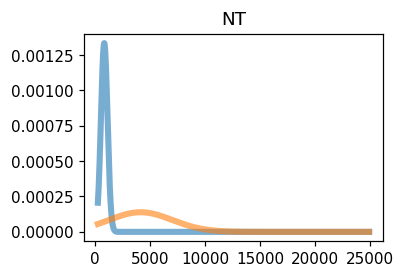

In [105]:
from scipy.stats import norm

_,ax = plt.subplots(figsize=(3.5,2.5))

# rnaseq.plotting.loghist(sc.obs["DeduplicatedReads"].values, bins = 70, color = "white", \
#                         edgecolor = 'black', linewidth = 0.7, ax=ax);
# plt.xlabel("mt_frac");
# plt.ylabel("densité");

x_axis = np.arange(np.min(sc.obs["total_UMIs"]), np.max(sc.obs["total_UMIs"]), 10)
plt.plot(x_axis, norm.pdf(x_axis, gm_umis.means_[0][0], np.sqrt(gm_umis.covariances_[0][0])), alpha = 0.6, linewidth=4)
plt.plot(x_axis, norm.pdf(x_axis, gm_umis.means_[1][0], np.sqrt(gm_umis.covariances_[1][0])), alpha=0.6, linewidth=4)

plt.title("NT")
# plt.yscale("squareroot")
# plt.ylim(0,50)
# plt.xlim(0,1.01)
# plt.xticks([0.2,0.4,0.6,0.8,1.0])
# plt.savefig(f"./figs/{prefix}_distrib_dedup.pdf")

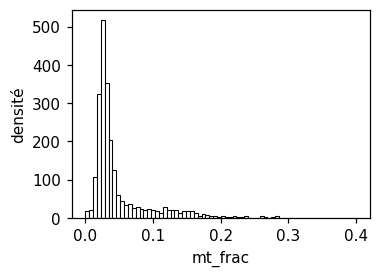

In [194]:
from scipy.stats import norm

plt.subplots(figsize=(3.5,2.5))

plt.hist(np.log1p(sc.obs["mt_frac"].values), bins = 70, color = "white", edgecolor = 'black', linewidth = 0.7);
plt.xlabel("mt_frac");
plt.ylabel("densité");

# x_axis = np.arange(-0.05, 1, 0.0001)
# plt.plot(x_axis, norm.pdf(x_axis, gm_mt.means_[0][0], np.sqrt(gm_mt.covariances_[0][0])), alpha = 0.6, linewidth=4)
# plt.plot(x_axis, norm.pdf(x_axis, gm_mt.means_[1][0], np.sqrt(gm_mt.covariances_[1][0])), alpha=0.6, linewidth=4)

# plt.title("NT")
# plt.yscale("squareroot")
# plt.ylim(0,50)
# plt.xlim(0,1.01)
# plt.xticks([0.2,0.4,0.6,0.8,1.0])
# plt.savefig(f"./figs/{prefix}_distrib_dedup.pdf")

In [592]:
# i = np.argmin(gm_umis.means_.ravel())
# j = np.argmax(gm_umis.means_.ravel())
# knee = np.mean([gm_umis.means_.ravel()[i] + np.sqrt(gm_umis.covariances_[i][0][0]), gm_umis.means_.ravel()[j] - np.sqrt(gm_umis.covariances_[j][0][0])])
knee = np.mean(gm_umis.means_.ravel())
umi_high_qual_th = np.mean([gm_umis.means_.ravel().max(), knee])

sc.obs["quality"] = ["low" if l < gm_umis.means_.ravel().min() or mt > gm_mt.means_.ravel().max() else "ambiguous" for l,mt in zip(sc.obs["total_UMIs"], sc.obs["mt_frac"])]
sc.obs["quality"] = ["high" if sc.obs["total_UMIs"][i] > umi_high_qual_th and sc.obs["mt_frac"][i] < gm_mt.means_.ravel().min() else sc.obs["quality"][i] for i in range(len(sc.obs["total_UMIs"]))]



lr = LogisticRegressionCV(Cs = 2)
i = [q in ["high", "low"] for q in sc.obs["quality"]]
lr.fit(sc.X.toarray()[i], sc.obs["quality"][i].values)

i = [q == "ambiguous" for q in sc.obs["quality"]]
qual = lr.predict(sc.X.toarray()[i])

sc.obs["quality"][sc.obs["quality"] == "ambiguous"] = qual
# sc._inplace_subset_obs(sc.obs["quality"] == "high")

/u/davidm/VirtualEns/python_3.9.5/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/u/davidm/VirtualEns/python_3.9.5/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_mo

In [593]:
sc._inplace_subset_obs(sc.obs["quality"] == "high")

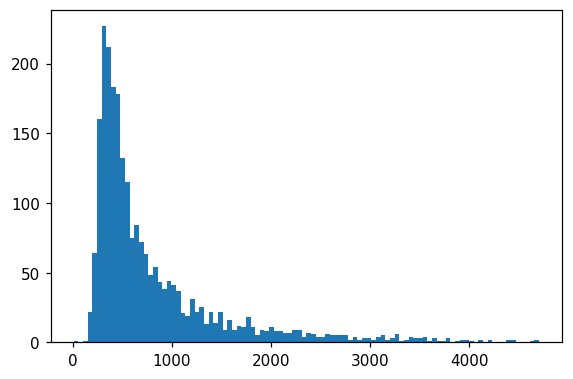

In [369]:
plt.hist(sc.obs["NumGenesExpressed"], bins=100);

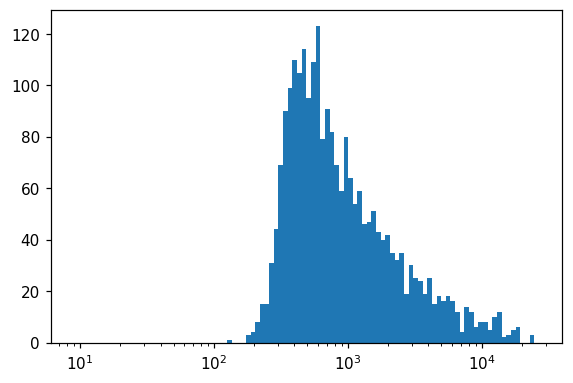

In [372]:
rnaseq.plotting.loghist(sc.obs["total_UMIs"], bins=100)

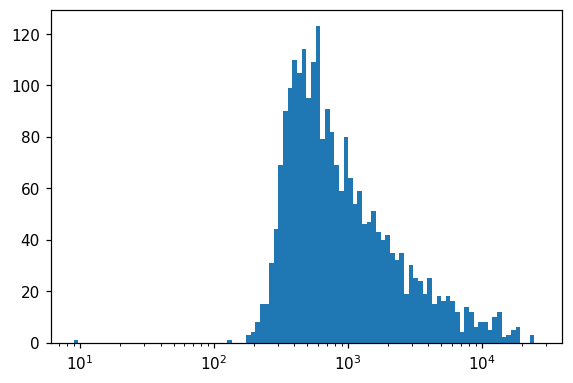

In [345]:
rnaseq.plotting.loghist(sc.obs["DeduplicatedReads"], bins=100)

In [40]:
sc._inplace_subset_obs(sc.obs["CorrectedReads"] > 10**4)

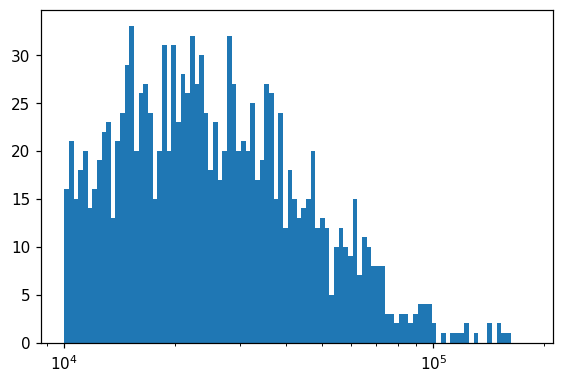

In [41]:
rnaseq.plotting.loghist(sc.obs["CorrectedReads"], bins=100)

### EmptyDrops

In [1132]:
rnaseq.pp.filter_genes(sc)
sc.X.shape

(2380, 13942)

Normalization by total UMIs...
Log2 + 1 tranformation...


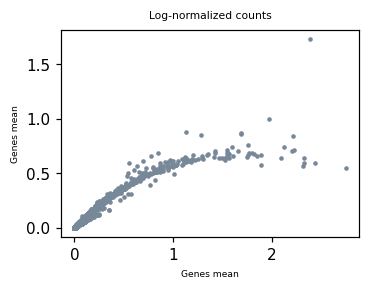

In [1172]:
rnaseq.pp.log_norm(sc, plot=True, inplace=True, ow = True)

In [1157]:
rnaseq.setup.load_layer(sc, "raw")

In [1170]:
sc.X = sc.X

In [1178]:
from emptydrops import find_nonambient_barcodes
from emptydrops.matrix import CountMatrix

matrix = CountMatrix.from_anndata(sc)
barcodes = sc.obs_names[sc.obs["quality"]=="high"].astype(bytes)


find_nonambient_barcodes(
    matrix,          # Full expression matrix
    barcodes,   # (iterable of str): Strings of initially-called cell barcodes
    min_umi_frac_of_median=0.005,
    min_umis_nonambient=100,
    max_adj_pvalue=0.01
)

Median UMIs of initial cell calls: 145.5
Min UMIs: 100
Number of candidate bcs: 2092
Range candidate bc umis: 112, 581


In [ ]:
matrix.

### QC distributions

In [125]:
def density_estimation(m1, m2):
    X, Y = np.mgrid[np.min(m1):np.max(m1):100j, np.min(m2):np.max(m2):100j]                                                     
    positions = np.vstack([X.ravel(), Y.ravel()])                                                       
    values = np.vstack([m1, m2])                                                                        
    kernel = stats.gaussian_kde(values)                                                                 
    Z = np.reshape(kernel(positions).T, X.shape)
    return X, Y, Z

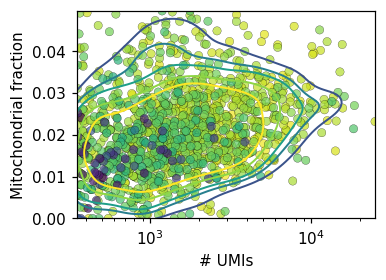

In [2511]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
from matplotlib.colors import ListedColormap


fig, ax1 = plt.subplots(figsize=(3.5,2.5))
# plt.xlim(10,28000)
# plt.ylim(-0.01, 0.51)

cmap = plt.cm.viridis
my_cmap = cmap(np.arange(cmap.N))
my_cmap[:,-1] = np.repeat(0.7, cmap.N)
my_cmap = ListedColormap(my_cmap)


x = sc.obs["total_UMIs"].values
y = sc.obs["mt_frac"].values

xy = np.vstack([x,y])
z = gaussian_kde(xy)(xy)

ax1.scatter(x, y, s=30, c=sc.obs["DedupRate"], cmap = my_cmap, norm=LogNorm(), linewidths = 0.15, edgecolor="black")
ax1.set_xscale('log')

X,Y,Z = density_estimation(np.log(x), y)
X = np.exp(X)
# Y = np.where(Y == 0, -1e-8, Y)
ax1.contour(X, Y, Z, alpha = 1, linewidths=1.3, vmax = 7, vmin = 1e-5, levels=[1.8, 3, 3.9, 5.8, 7.6])

# plt.axvline(1500); 
# plt.axhline(0.07); 
plt.xlabel("# UMIs")
plt.ylabel("Mitochondrial fraction")
plt.savefig("./test.svg", transparent=True)

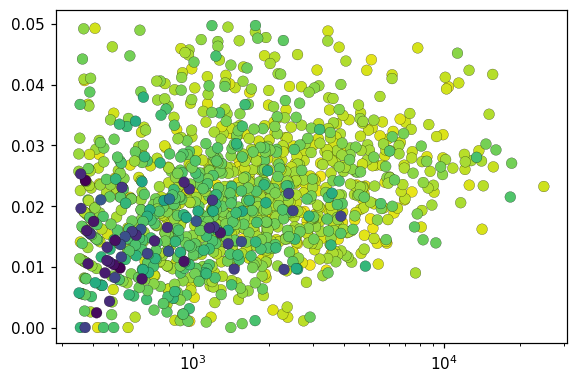

In [2512]:
plt.scatter(x, y, s=50, c=sc.obs["DedupRate"],  norm=LogNorm(), linewidths = 0.15, edgecolor="black")
plt.xscale("log")

In [188]:
(sc.obs["total_UMIs"]>1000).sum()

321

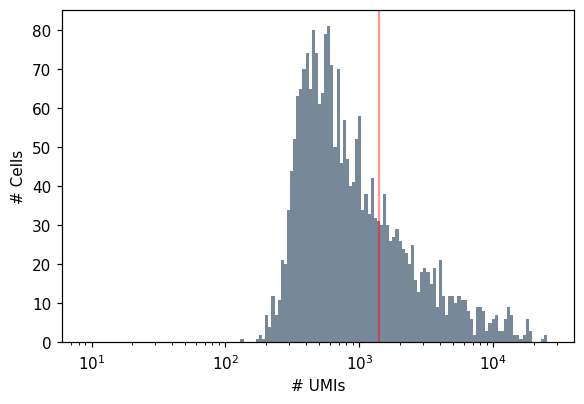

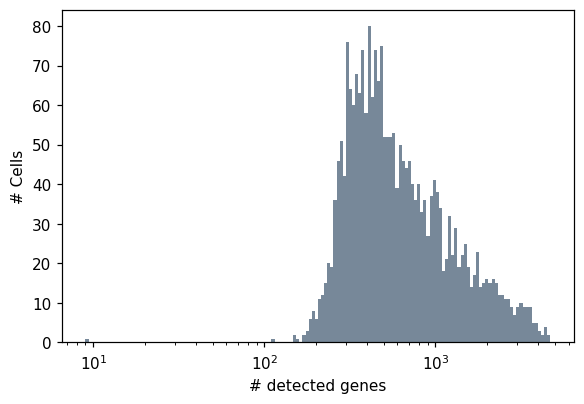

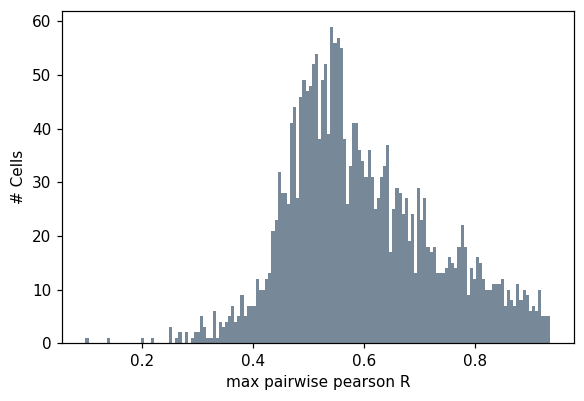

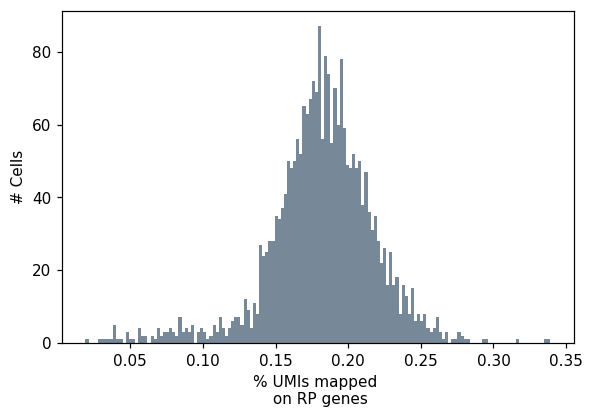

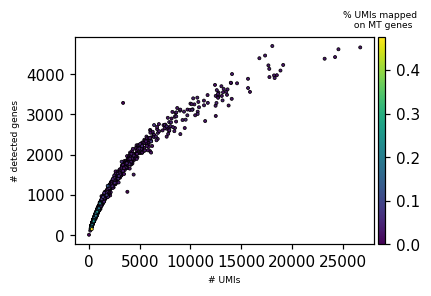

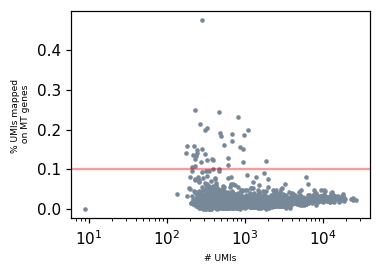

In [286]:
rnaseq.pp.plot_qc(sc, n_counts_min = 1400, mt_max = 0.1, n_bins=150, save_path = "./figs/ns")

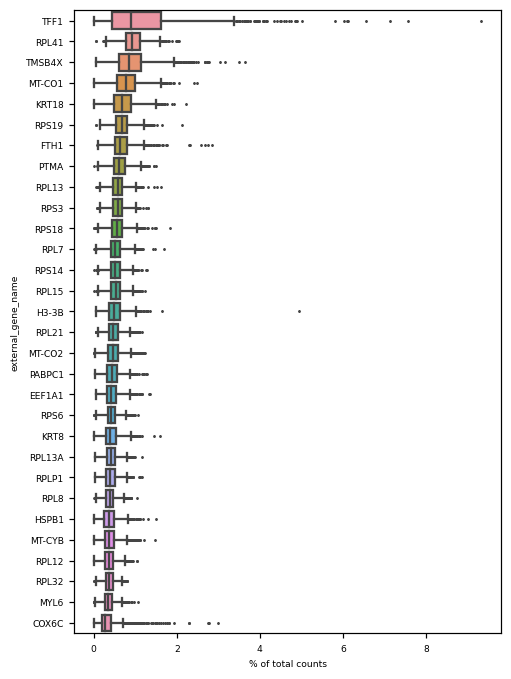

In [879]:
sc.var_names = sc.var["external_gene_name"]
scanpy.pl.highest_expr_genes(sc, n_top=30)

In [1466]:
# from scipy.sparse import csr_matrix
# sc.layers["test_norm"] = csr_matrix(np.log1p(10 * sc.layers["raw"].toarray().T/np.log1p(sc.obs["total_UMIs"].values)).T)

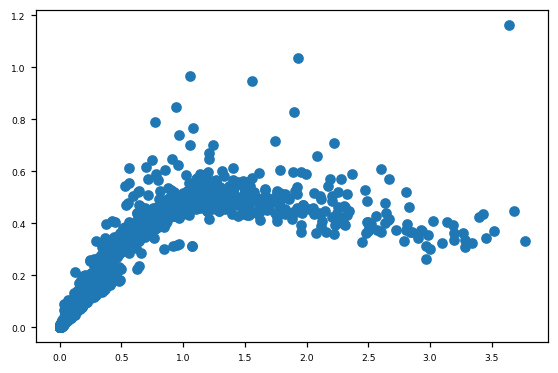

In [1464]:
# plt.scatter(x.mean(1), x.var(1))

### Non-stringent filtering

#### Filtering cells

In [2615]:
# rnaseq.pp.filter_cells(sc, n_counts_min = 1300, inplace = True)
# rnaseq.pp.filter_cells(sc, n_counts_min = 1300, mt_max=0.1, inplace = True)
rnaseq.pp.filter_cells(sc, n_counts_min = 300, inplace = True)

In [3170]:
rnaseq.pp.filter_cells(sc, mt_max=0.05, inplace = True)

#### Number of cells after non-stringent filtering

In [2568]:
sc.X.shape

(0, 60669)

#### QC after filtering

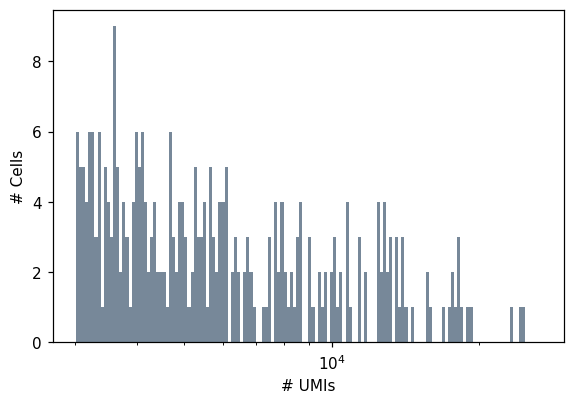

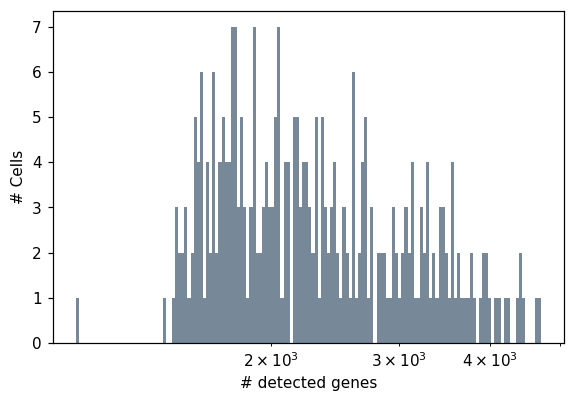

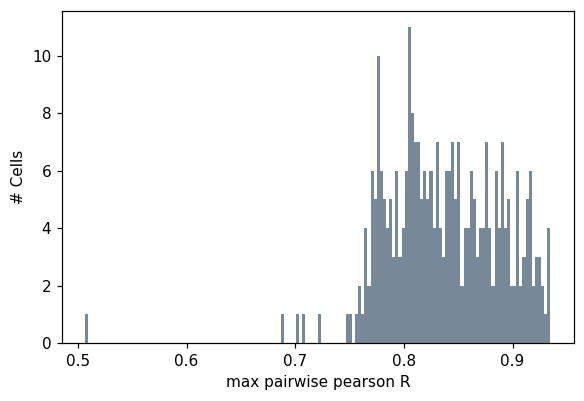

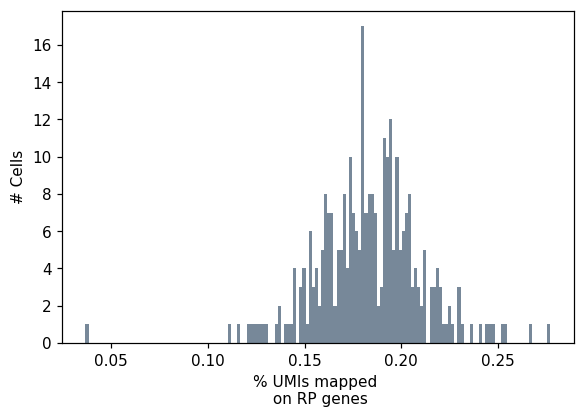

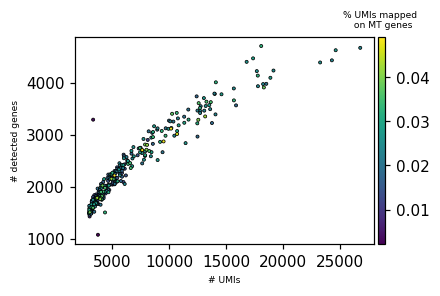

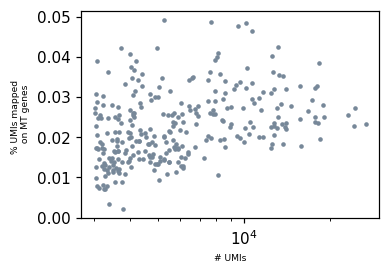

In [336]:
rnaseq.pp.plot_qc(sc)

#### Normalize

In [3357]:
sc._inplace_subset_obs(sc.obs["mt_frac"]<0.05)

In [276]:
sc._inplace_subset_obs(sc.obs["DedupRate"]>0.5)

In [3315]:
# sc._inplace_subset_var(sc.var["dedup_per_gene"]>0.95)

In [3247]:
# sc._inplace_subset_obs(sc.obs["total_UMIs"]<25000)

In [441]:
rnaseq.pp.filter_genes(sc, n_counts=5)
sc.X.shape

(1264, 11513)

In [ ]:
np.unique(sc.var["gene_biotype"])

Normalization by total UMIs...
Log2 + 1 tranformation...


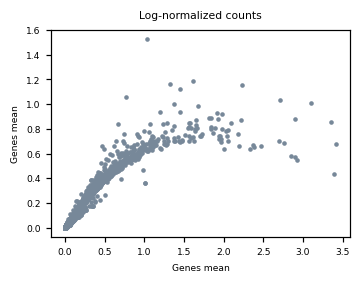

In [442]:
rnaseq.pp.log_norm(sc, plot=True, inplace=True, ow = True)

#### Umap qc

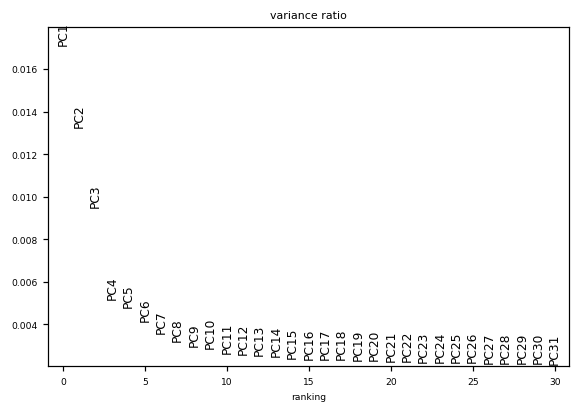

In [443]:
scanpy.pp.pca(sc, n_comps=50)
scanpy.pl.pca_variance_ratio(sc)

In [2155]:
sc.obsm["X_pca"] = sc.obsm["X_pca"][:,1:]

In [447]:
scanpy.pp.neighbors(sc, n_pcs = 15, n_neighbors = 10)
scanpy.tl.umap(sc, n_components=2)

In [ ]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["phase"], \
    s = 10, norm = LogNorm(), palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

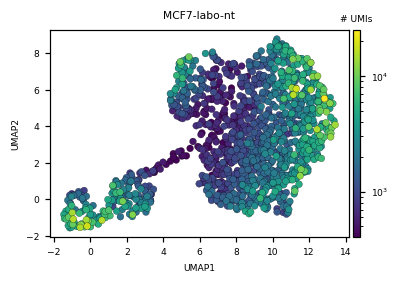

In [450]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["total_UMIs"], \
    s = 20, norm = LogNorm(), palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, order_color = "ascending", save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

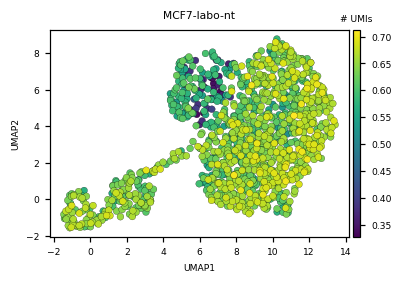

In [451]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["DedupRate"], \
    s = 20, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, order_color = "ascending", save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

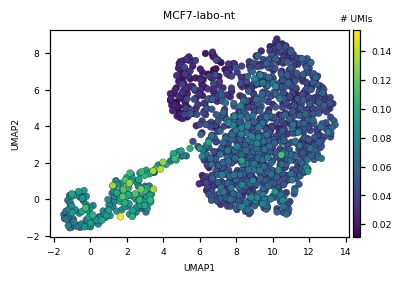

In [453]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["rp_frac"], \
    s = 20,palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, order_color = "ascending", save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

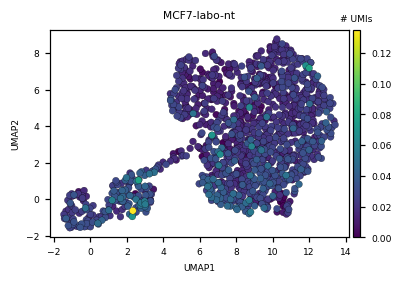

In [455]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["mt_frac"], \
    s = 20, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, order_color = "ascending", save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

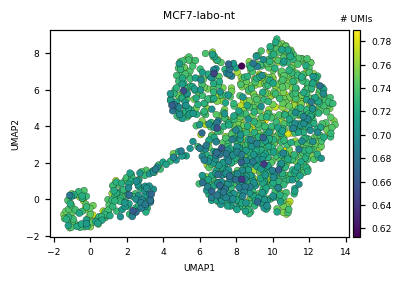

In [459]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["MappingRate"], \
    s = 20, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, order_color = "descending", save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

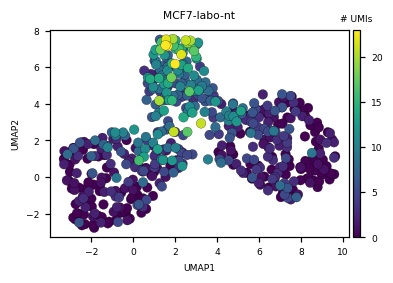

In [178]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["tot_unspliced"], \
    s = 40, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, order_color = "ascending", save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

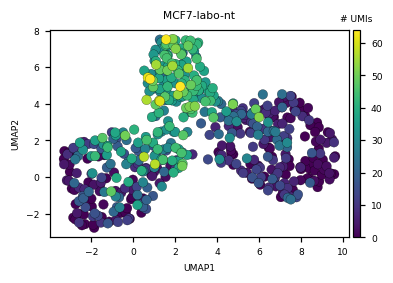

In [179]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["tot_spliced"], \
    s = 40, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, order_color = "ascending", save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

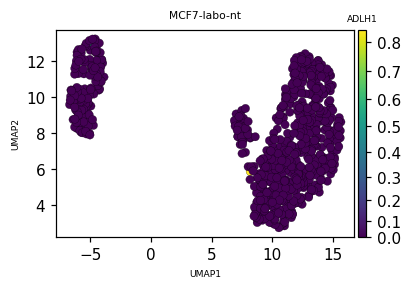

In [2168]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "TFF1"], \
    s = 30, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, norm=PowerNorm(gamma=1.2))

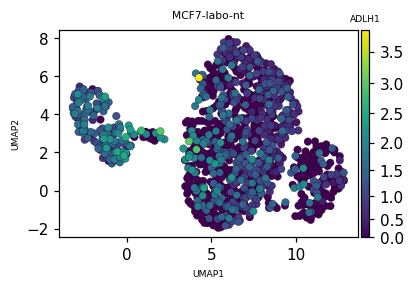

In [2410]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "COX6A1"], \
    s = 25, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1", order_color = "ascending",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, norm=PowerNorm(gamma=1.2))

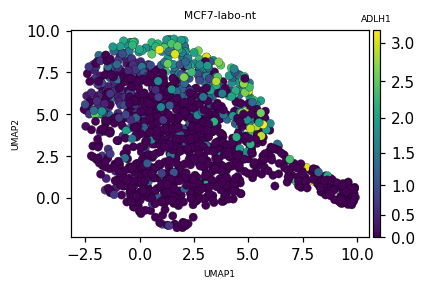

In [1837]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "CCNB1"], \
    s = 30, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, norm=PowerNorm(gamma=1.2))

In [ ]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["max_corr"], \
    s = 20, norm = LogNorm(), palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

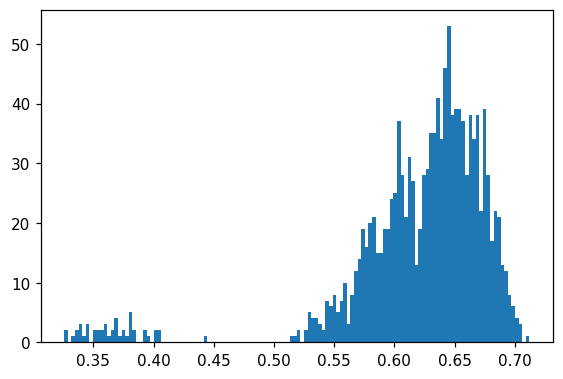

In [2514]:
plt.hist(sc.obs["DedupRate"], bins=130);

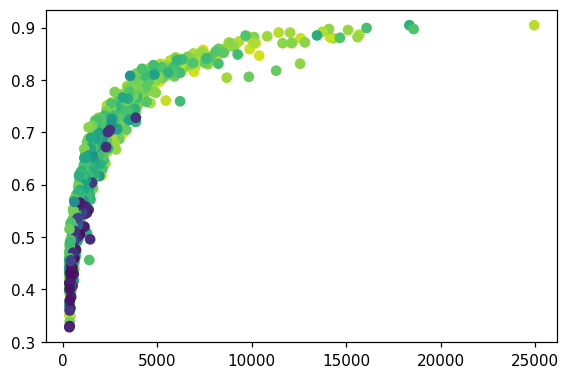

In [2515]:
sc.obs_names = sc.obs["CB"]

plt.scatter(sc.obs["total_UMIs"], sc.obs["max_corr"], c=sc.obs["DedupRate"]);

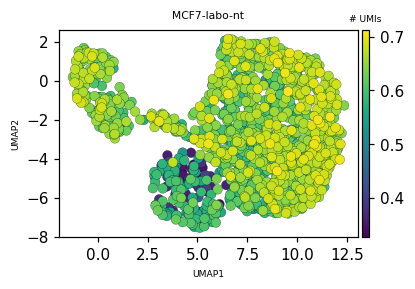

In [2516]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["DedupRate"], \
    s = 40, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15, order_color="ascending")

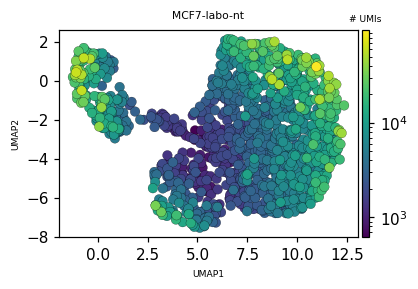

In [2517]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["raw_cb_freq"], \
    s = 40, norm = LogNorm(), palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15, order_color="ascending")

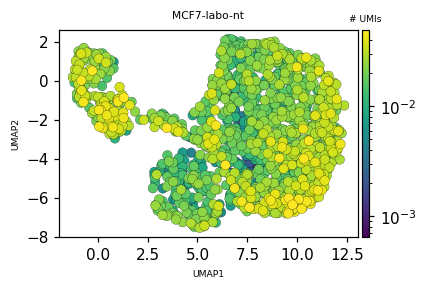

In [2519]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["mt_frac"], \
    s = 40, norm = LogNorm(), palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15, order_color="ascending")

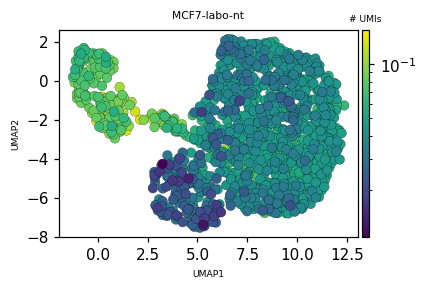

In [2520]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["rp_frac"], \
    s = 40, norm = LogNorm(), palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15, order_color="descending")

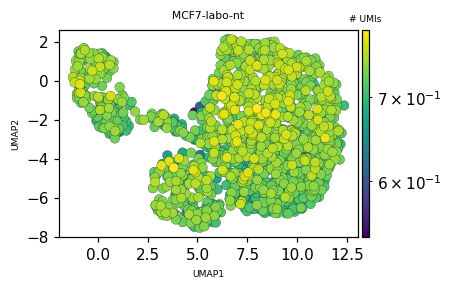

In [2522]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["MappingRate"], \
    s = 40, norm = LogNorm(), palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15, order_color="ascending")

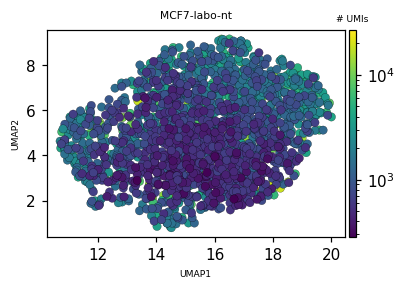

In [1111]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["total_UMIs"], \
    s = 30, norm = LogNorm(), palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

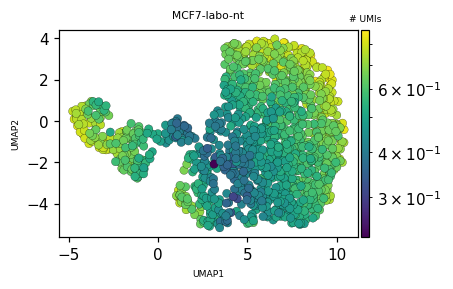

In [1891]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["max_corr"], \
    s = 30, norm = LogNorm(), palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

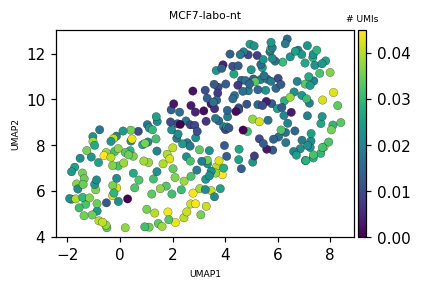

In [429]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["mt_frac"], \
    s = 30, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

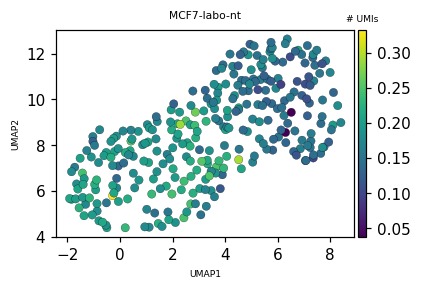

In [430]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["rp_frac"], \
    s = 30, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

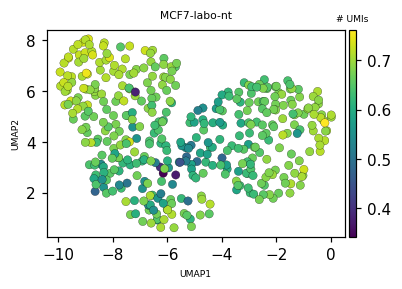

In [1032]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["MappingRate"], \
    s = 30, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

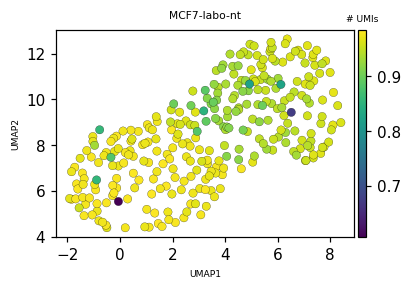

In [451]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["DedupRate"], \
    s = 30, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

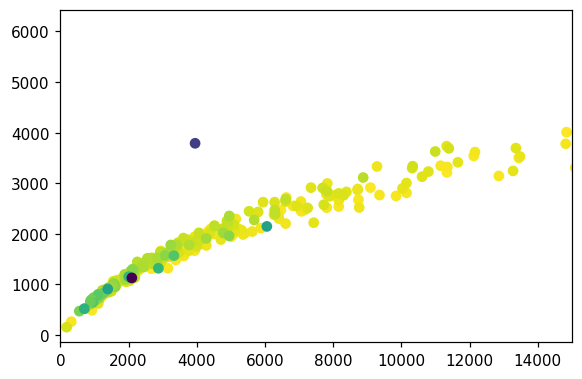

In [477]:
plt.scatter(sc.obs["total_UMIs"], sc.obs["#_genes"], c=sc.obs["DedupRate"])
plt.xlim(0,15000);

In [ ]:
rnaseq.plotting.scatter(sc.obsm["X_pca"][:,0], sc.obsm["X_pca"][:,1], color = sc.obs["cnv_leiden"], \
    s = 10, norm = LogNorm(), palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

In [1047]:
sc.obs["keep"] = ((sc.obs["MappingRate"] > 0.6) & (sc.obs["total_UMIs"] > 1900)).astype(str)

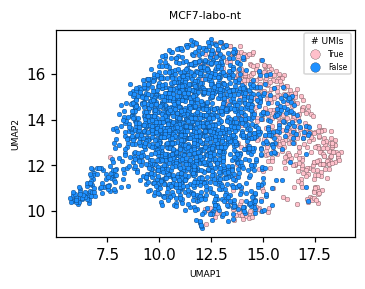

In [293]:
rnaseq.pp.filter_cells(sc, n_counts_min = 2000, mt_max=0.05, inplace = False)
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["keep"], \
    s = 10, norm = LogNorm(), xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15, palette = {"True":"pink", "False":"dodgerblue"}, order_color=["True","False"])

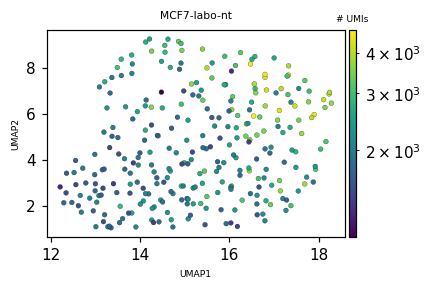

In [449]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["NumGenesExpressed"], \
    s = 10, norm = LogNorm(), palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

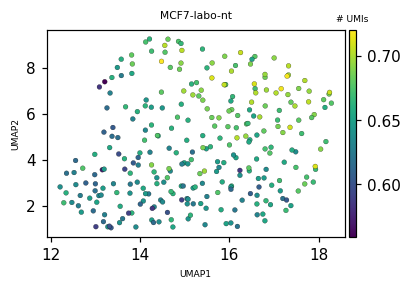

In [450]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["MappingRate"], \
    s = 10, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

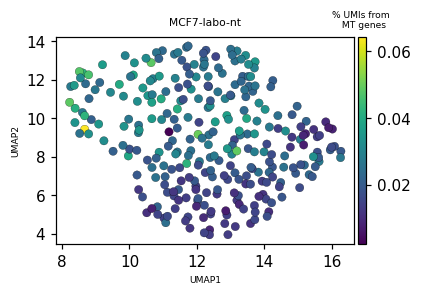

In [599]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["mt_frac"],\
    s = 30, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "% UMIs from \n MT genes",\
    title = new_sample_name, save = "./figs/ns_umap_mt.pdf", linewidth=0.15)

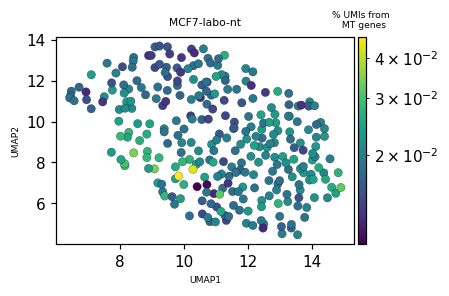

In [580]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["lnc_frac"],\
    s = 30, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "% UMIs from \n MT genes",\
    title = new_sample_name, save = "./figs/ns_umap_mt.pdf", linewidth=0.15, norm=LogNorm())

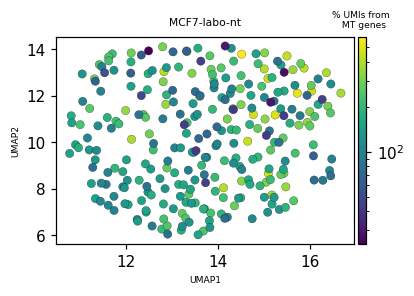

In [491]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["introns"],\
    s = 30, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "% UMIs from \n MT genes",\
    title = new_sample_name, save = "./figs/ns_umap_mt.pdf", linewidth=0.15, norm=LogNorm())

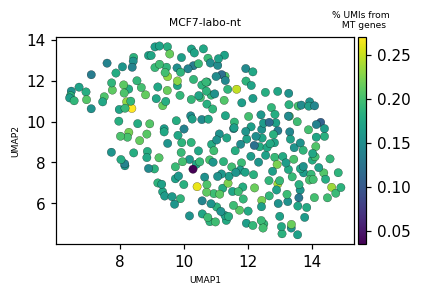

In [581]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["rp_frac"],\
    s = 30, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "% UMIs from \n MT genes",\
    title = new_sample_name, save = "./figs/ns_umap_mt.pdf", linewidth=0.15)

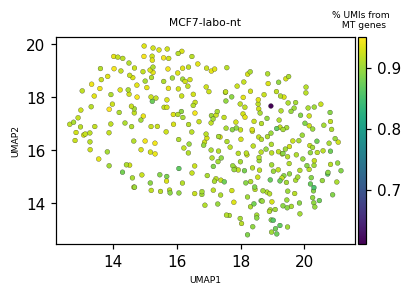

In [329]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["DedupRate"],\
    s = 10, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "% UMIs from \n MT genes",\
    title = new_sample_name, save = "./figs/ns_umap_mt.pdf", linewidth=0.15)

#### Umap single genes

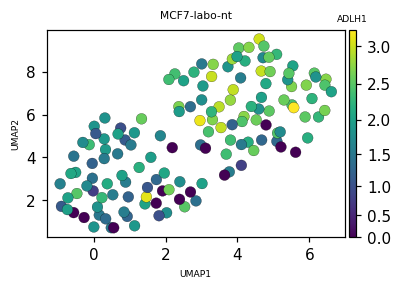

In [3124]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "PPP1CA"], \
    s = 50, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, norm=PowerNorm(gamma=1.2))

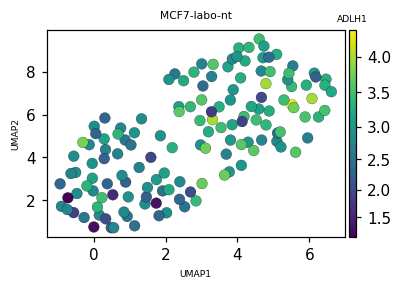

In [3107]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "PFN1"], \
    s = 50, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, norm=PowerNorm(gamma=1.2))

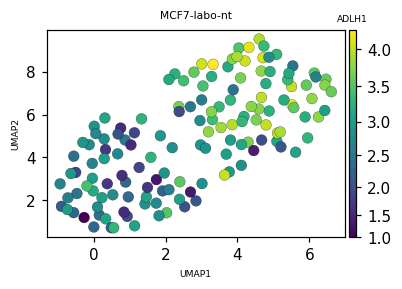

In [3106]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "SLC25A5"], \
    s = 50, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, norm=PowerNorm(gamma=1.2))

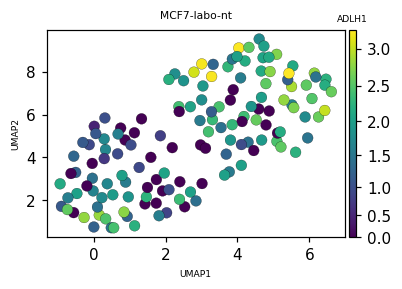

In [3128]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "ANXA2"], \
    s = 50, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, norm=PowerNorm(gamma=1.2))

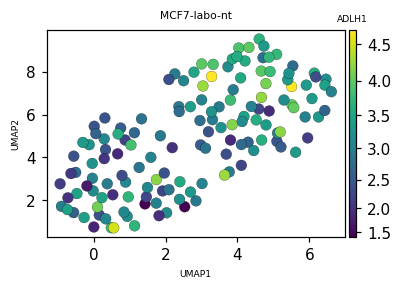

In [3104]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "SPTSSB"], \
    s = 50, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, norm=PowerNorm(gamma=1.2))

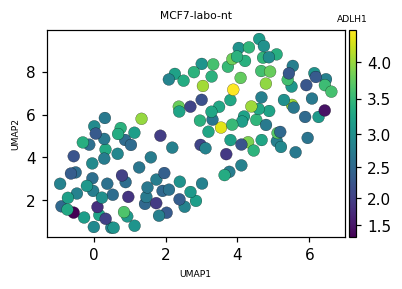

In [3103]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "UBB"], \
    s = 60, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, norm=PowerNorm(gamma=1.2))

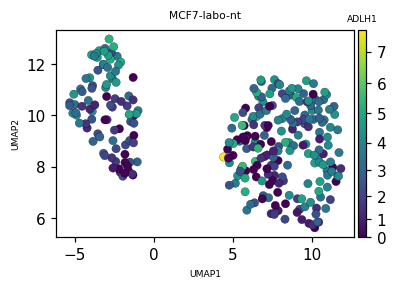

In [3401]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "TFF1"], \
    s = 30, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, norm=PowerNorm(gamma=1.2))

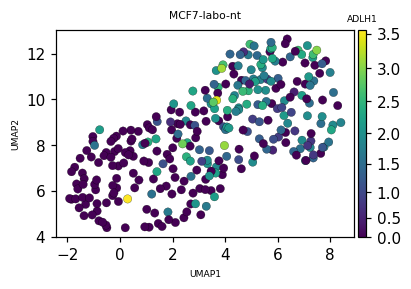

In [449]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "AP000350.4"], \
    s = 30, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, norm=PowerNorm(gamma=1.2))

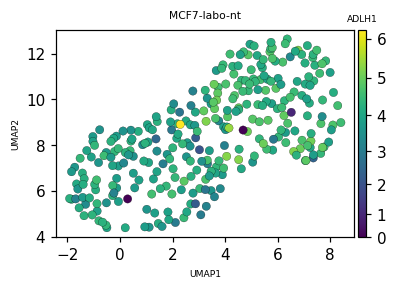

In [448]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "RPS3"], \
    s = 30, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, norm=PowerNorm(gamma=1.2))

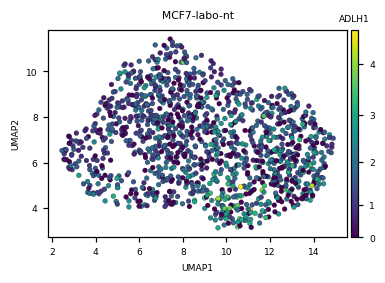

In [2052]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "MTRNR2L12"], \
    s = 10, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, norm=PowerNorm(gamma=1.2))

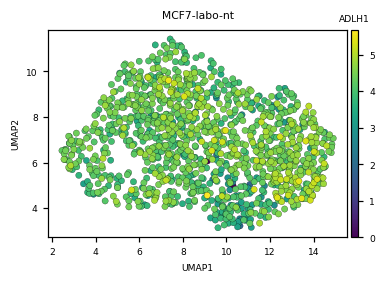

In [2053]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "RPL15"], \
    s = 17, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = "ascending")

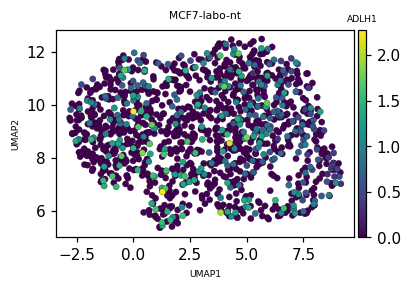

In [84]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "VHL"], \
    s = 17, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = "ascending")

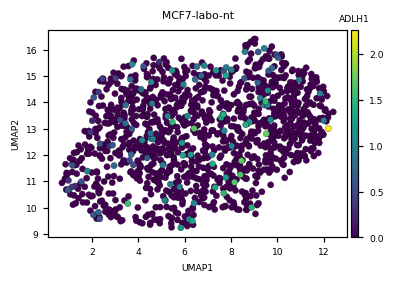

In [453]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "CASP7"], \
    s = 17, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = "ascending")

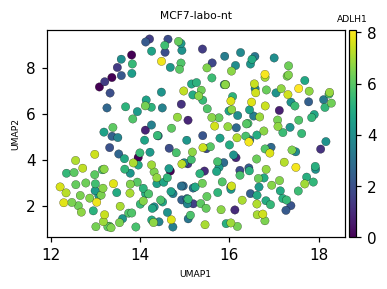

In [446]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "TFF1"], \
    s = 30, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = "ascending")

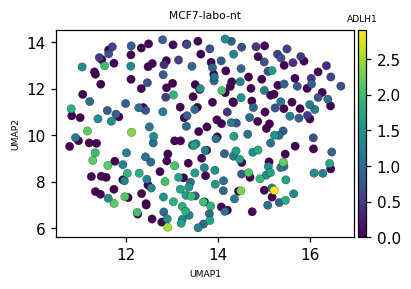

In [511]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "TRIM28"], \
    s = 30, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = "ascending")

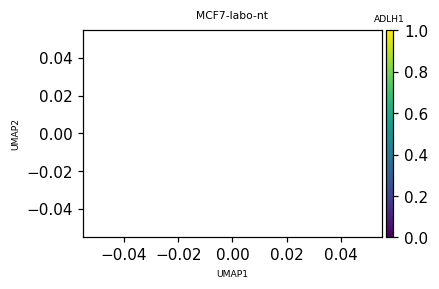

In [525]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "ERO1B"], \
    s = 30, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = "ascending")

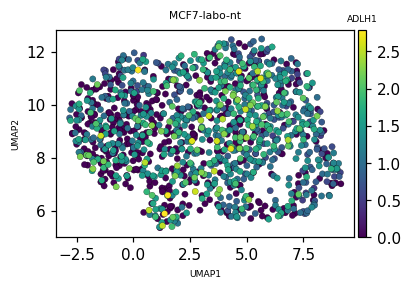

In [85]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "KPNB1"], \
    s = 17, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = "ascending")

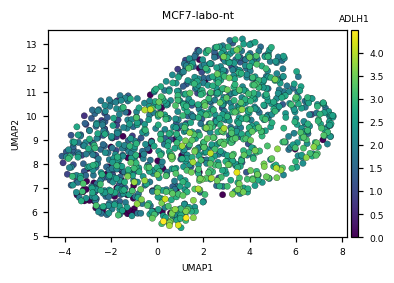

In [312]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "HNRNPA2B1"], \
    s = 17, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = "ascending")

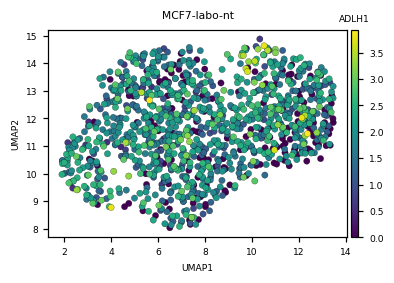

In [630]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "CCND1"], \
    s = 17, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = "ascending")

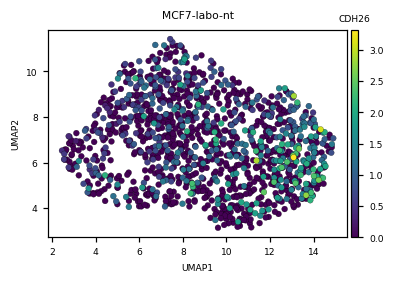

In [2055]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "CITED2"], \
    s = 15, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = g,\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = 'ascending')

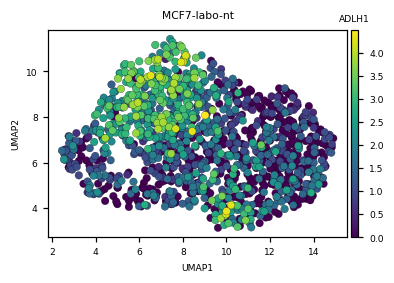

In [2056]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == "H4C3"], \
    s = 25, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color='ascending')

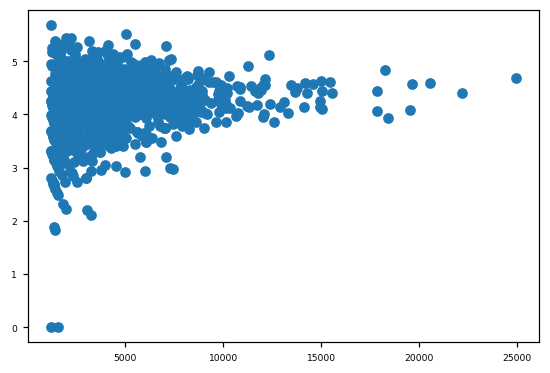

In [2057]:
plt.scatter(sc.obs["total_UMIs"], sc.X.toarray()[:, sc.var["external_gene_name"].values == "RPL15"])

#### Umap signatures

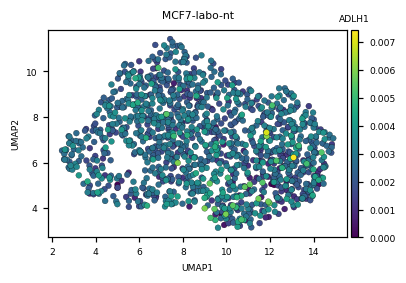

In [2058]:
sc.var_names = sc.var["external_gene_name"]
sc.var_names_make_unique()
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc[:, np.intersect1d(apop_sig,sc.var_names)].layers["raw"].toarray().sum(1)/sc.obs["total_UMIs"], \
    s = 15, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = "ascending")

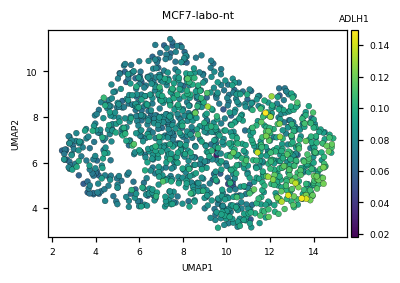

In [2196]:
# sc.var_names = sc.var["external_gene_name"]
# sc.var_names_make_unique()
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc[:, np.intersect1d(pa_sig,sc.var_names)].layers["raw"].toarray().sum(1)/sc.obs["total_UMIs"], \
    s = 15, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "ADLH1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = "ascending")

/u/davidm/Documents/Master-thesis/Scripts/RNA-seq/python/rnaseq/plotting.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, _ = plt.subplots(figsize = figsize)


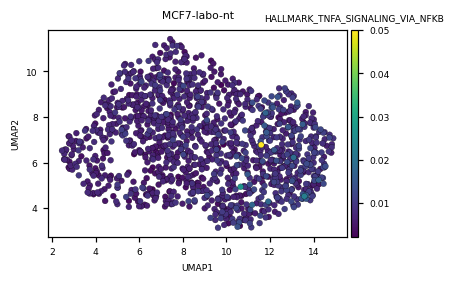

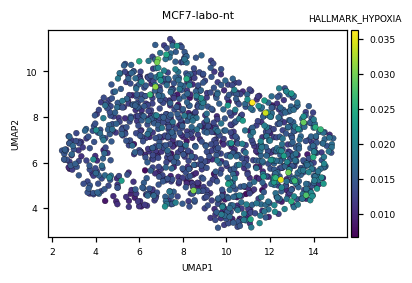

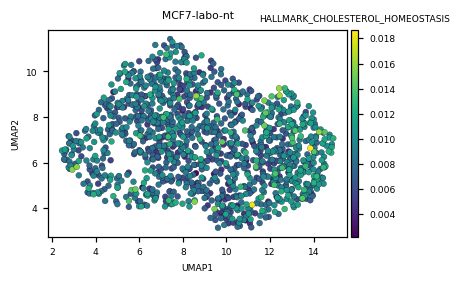

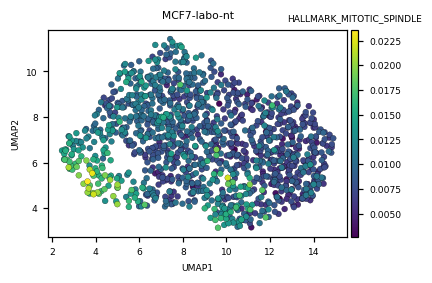

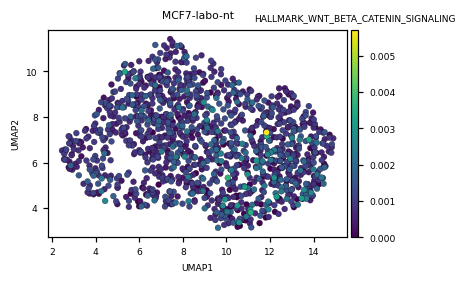

...

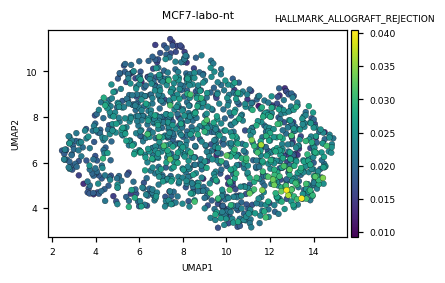

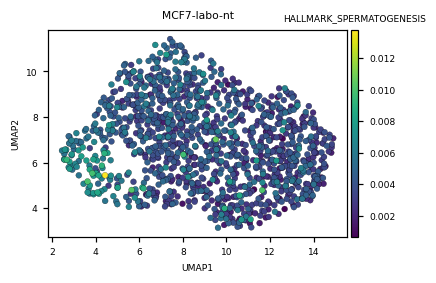

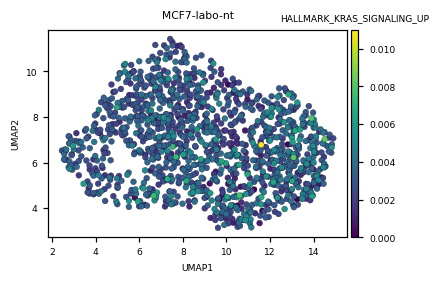

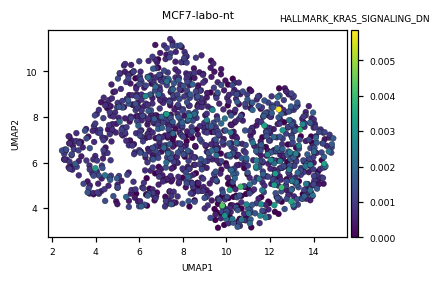

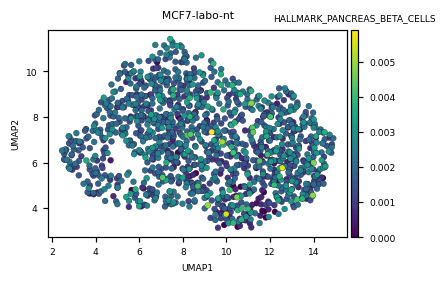

In [2220]:
for sig in hallmark.index :

    rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc[:, np.intersect1d(hallmark.loc[sig][1:].dropna().values,sc.var_names)].layers["raw"].toarray().sum(1)/sc.obs["total_UMIs"], \
        s = 15, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = sig,\
        title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = "ascending")

In [2225]:
plt.close("all")

In [2246]:
np.intersect1d(loc.loc["chr1p34"].dropna().values[1:], sc.var_names)

array(['ADPRS', 'AGO1', 'AGO3', 'AGO4', 'AKIRIN1', 'AKR1A1', 'ARMH1',
       'ARTN', 'ATP6V0B', 'B4GALT2', 'BEST4', 'BMP8A', 'BMP8B',
       'C1orf109', 'C1orf122', 'C1orf210', 'C1orf216', 'C1orf50', 'CAP1',
       'CCDC163', 'CCDC17', 'CCDC24', 'CCDC30', 'CDC20', 'CDCA8',
       'CFAP57', 'CITED4', 'CLDN19', 'CLSPN', 'COL9A2', 'CTPS1', 'DLGAP3',
       'DMAP1', 'DPH2', 'EBNA1BP2', 'EDN2', 'EIF2B3', 'ELOVL1', 'EPHA10',
       'ERI3', 'ERMAP', 'EVA1B', 'EXO5', 'FAM183A', 'FHL3', 'FOXJ3',
       'GJB3', 'GNL2', 'GPBP1L1', 'HECTD3', 'HIVEP3', 'HPCAL4', 'HPDL',
       'HYI', 'INPP5B', 'IPO13', 'IPP', 'KCNQ4', 'KDM4A', 'KIAA0319L',
       'KIF2C', 'LSM10', 'LURAP1', 'MACF1', 'MANEAL', 'MAP7D1', 'MAST2',
       'MEAF6', 'MED8', 'MFSD2A', 'MMACHC', 'MRPS15', 'MTF1', 'MUTYH',
       'MYCBP', 'MYCL', 'NASP', 'NCDN', 'NDUFS5', 'NFYC', 'OSCP1', 'P3H1',
       'P3R3URF-PIK3R3', 'PABPC4', 'PIK3R3', 'PLK3', 'POMGNT1', 'PPCS',
       'PPIE', 'PPIH', 'PPT1', 'PRDX1', 'PSMB2', 'PTPRF', 'RAD54L',
      

In [2249]:
np.intersect1d(loc.loc["chr20p13"].dropna().values[1:], sc.var_names)

array(['AP5S1', 'ATRN', 'C20orf194', 'C20orf27', 'C20orf96', 'CDC25B',
       'CENPB', 'CSNK2A1', 'DDRGK1', 'EBF4', 'FAM110A', 'FASTKD5',
       'FKBP1A', 'IDH3B', 'ITPA', 'LZTS3', 'MAVS', 'MRPS26', 'NOP56',
       'NRSN2', 'NSFL1C', 'PANK2', 'PCED1A', 'PRNP', 'PSMF1', 'PTPRA',
       'RBCK1', 'RNF24', 'SDCBP2', 'SIRPA', 'SLC23A2', 'SLC4A11',
       'SLC52A3', 'SMOX', 'SNRPB', 'SOX12', 'SRXN1', 'STK35', 'TBC1D20',
       'TRIB3', 'UBOX5', 'VPS16', 'ZCCHC3', 'ZNF343'], dtype=object)

In [362]:
for sig in loc.index[[ch.startswith("chr2") for ch in loc.index]] :

    signature = np.intersect1d(loc.loc[sig][260:].dropna().values,sc.var_names)
    if len(signature) > 0 :
        rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc[:, signature].layers["raw"].toarray().sum(1)/sc.obs["total_UMIs"], \
            s = 15, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = sig,\
            title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = "ascending")

InvalidIndexError: Reindexing only valid with uniquely valued Index objects

In [2257]:
plt.close("all")

In [363]:
signature = np.intersect1d(loc.loc["chr20q13"][260:].dropna().values,sc.var_names)
if len(signature) > 0 :
    rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc[:, signature].layers["raw"].toarray().sum(1)/sc.obs["total_UMIs"], \
        s = 15, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = sig,\
        title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = "ascending")

InvalidIndexError: Reindexing only valid with uniquely valued Index objects

In [360]:
signature = np.intersect1d(loc.loc["chr1p34"][260:].dropna().values,sc.var_names)
if len(signature) > 0 :
    rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc[:, signature].layers["raw"].toarray().sum(1)/sc.obs["total_UMIs"], \
        s = 15, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "chr1p34",\
        title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = "ascending")

NameError: name 'loc' is not defined

#### Umap chromosomes

In [2067]:
ch = 'X'

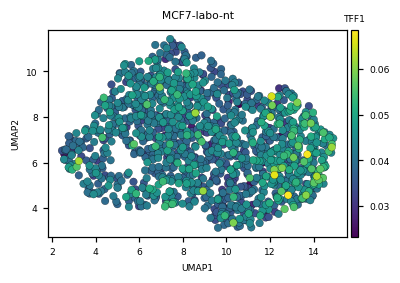

In [2069]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.layers['raw'].toarray()[:, sc.var["chromosome_name"].values == str(ch)].sum(1)/sc.obs["total_UMIs"], \
    s = 25, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "TFF1", \
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color='ascending')

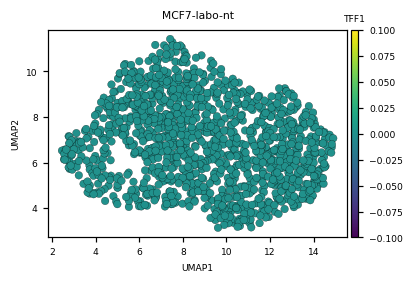

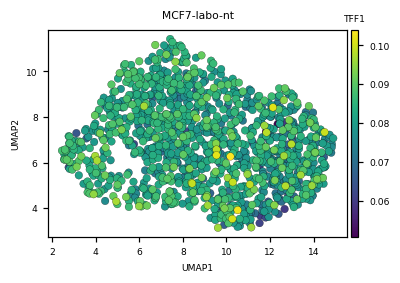

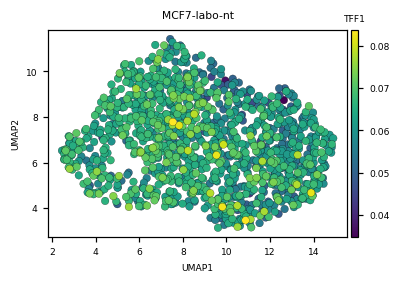

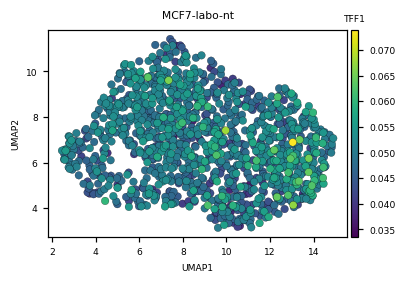

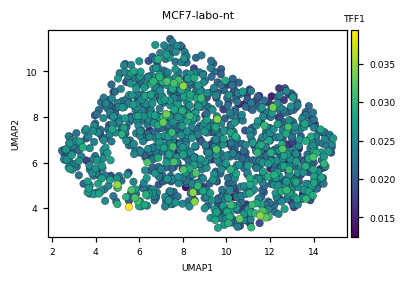

...

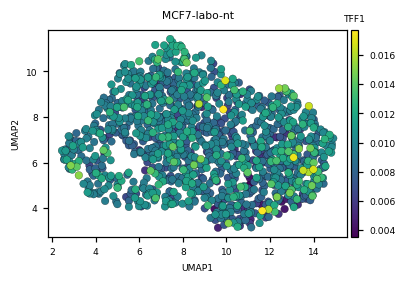

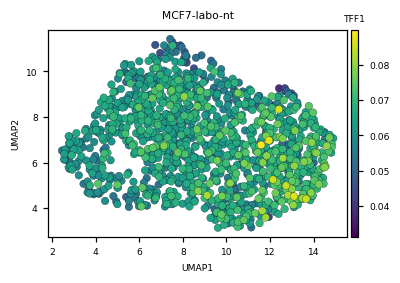

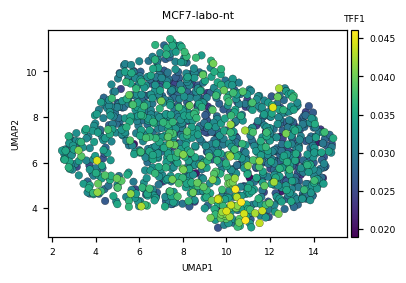

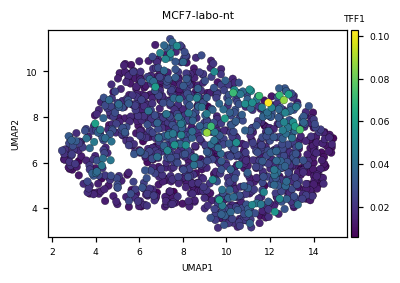

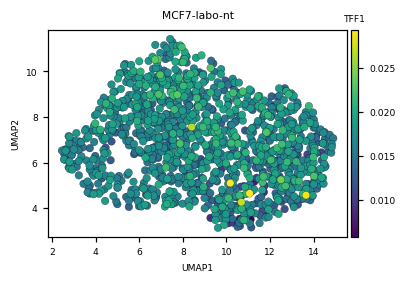

In [2071]:
for ch in range(23) :
    rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.layers['raw'].toarray()[:, sc.var["chromosome_name"].values == str(ch)].sum(1)/sc.obs["total_UMIs"], \
        s = 25, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "TFF1", \
        title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color='ascending')

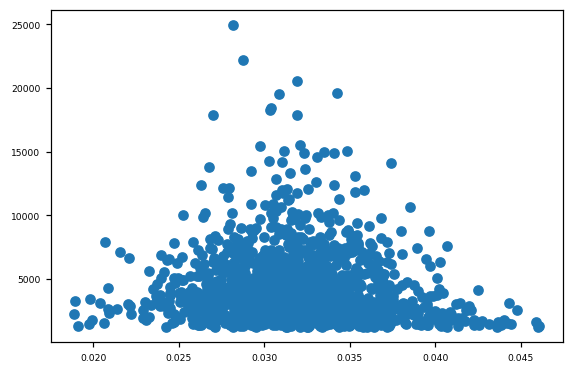

In [2065]:
plt.scatter(sc.layers['raw'].toarray()[:, sc.var["chromosome_name"].values == str(ch)].sum(1)/sc.obs["total_UMIs"], sc.obs["total_UMIs"])

In [358]:
ch = '20'

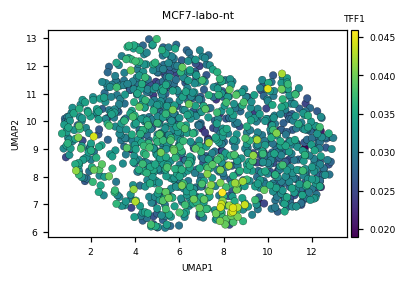

In [359]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.layers['raw'].toarray()[:, sc.var["chromosome_name"].values == str(ch)].sum(1)/sc.obs["total_UMIs"], \
    s = 25, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "TFF1", \
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color='ascending')

In [2072]:
annot_path = "/home/arion/davidm/Data/references/human/assembly__GRCh38-hg38/annotation__gencode/gencode_34"
rnaseq.setup.annotate_genes(sc, "exon_chrom_end", save_path = annot_path + "/biomart_ens100")
rnaseq.setup.annotate_genes(sc, "exon_chrom_start", save_path = annot_path + "/biomart_ens100")

exon_chrom_end already annotated. Set ow = True if you want to overwrite.
Annotating exon_chrom_start using Biomart (Ensembl Genes 100, 'hsapiens_gene_ensembl')...


In [2073]:
sc.var.loc[sc.var_names[sc.var["chromosome_name"] == "20"]]["exon_chrom_end"].values.astype(int).max()

64255870

In [2079]:
sc.var.loc[sc.var_names[sc.var["chromosome_name"] == "20"]]["exon_chrom_start"].values.astype(int).max()

64255741

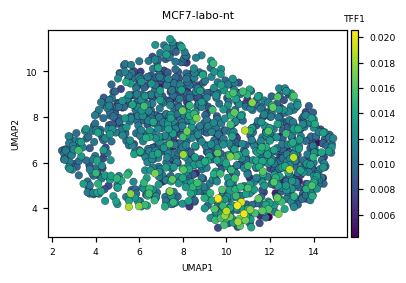

In [2097]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.layers['raw'].toarray()[:, \
            (sc.var["chromosome_name"].values == str(ch)) & (sc.var["exon_chrom_end"].values.astype(int) > 50000000) & \
            (sc.var["exon_chrom_end"].values.astype(int) < 60000000) & (sc.var["exon_chrom_start"].values.astype(int) > 50000000) & \
            (sc.var["exon_chrom_start"].values.astype(int) < 60000000)].sum(1)/sc.obs["total_UMIs"], \
    s = 25, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "TFF1", \
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color='ascending')

/u/davidm/Documents/Master-thesis/Scripts/RNA-seq/python/rnaseq/plotting.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, _ = plt.subplots(figsize = figsize)


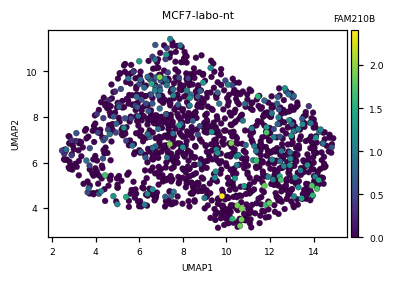

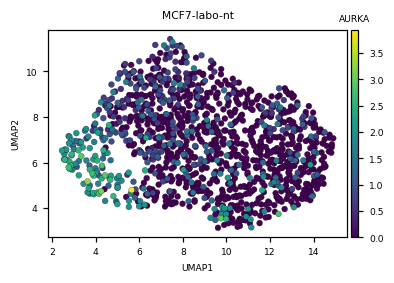

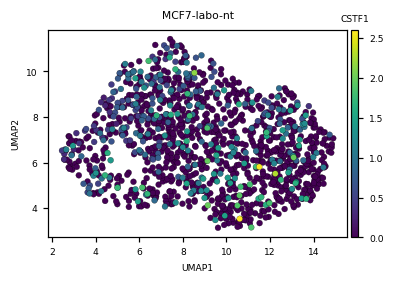

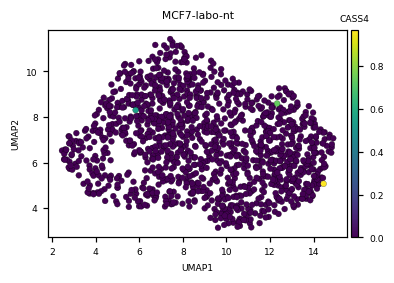

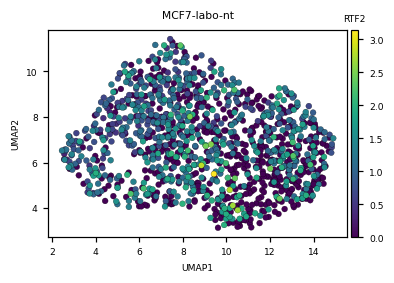

...

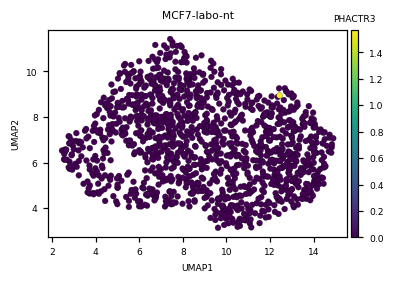

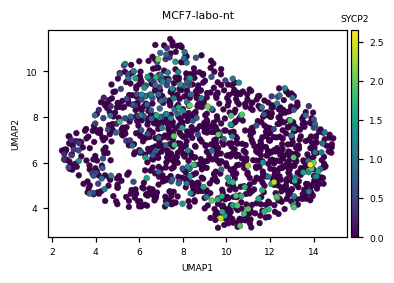

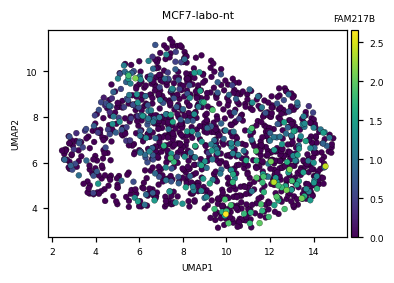

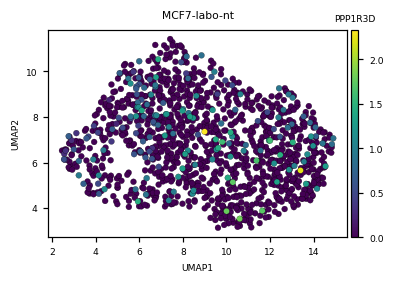

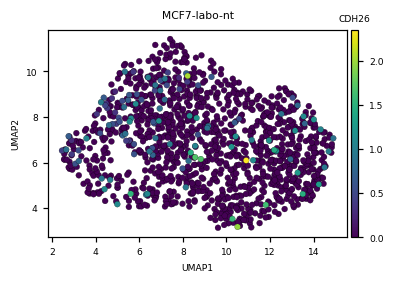

In [2064]:
genes = sc.var_names[(sc.var["chromosome_name"].values == str(ch)) & (sc.var["exon_chrom_end"].values.astype(int) > 55000000) & (sc.var["exon_chrom_end"].values.astype(int) < 60000000)]
for g in genes :
    rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"].values == g], \
    s = 15, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = g,\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15, order_color = 'ascending')

#### louvain

In [3196]:
sc._inplace_subset_obs(sc.X.toarray()[:,sc.var["external_gene_name"]=="TFF1"]>2)

In [47]:
cl = []
for r in range(10,210,1):
    scanpy.tl.leiden(sc, key_added="leiden", resolution = r/100, directed=False)
    cl.append(len(np.unique(sc.obs["leiden"])))

In [48]:
np.unique(cl, return_counts=True)

(array([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15]),
 array([ 1, 21, 13, 14, 17, 22, 18,  5,  9, 42, 30,  5,  3]))

In [1639]:
scanpy.pp.neighbors(sc, n_pcs = 15, n_neighbors = 15)
scanpy.tl.umap(sc, n_components=2)

In [2455]:
np.unique(sc.var["gene_biotype"])

array(['TR_C_gene', 'polymorphic_pseudogene', 'protein_coding'],
      dtype=object)

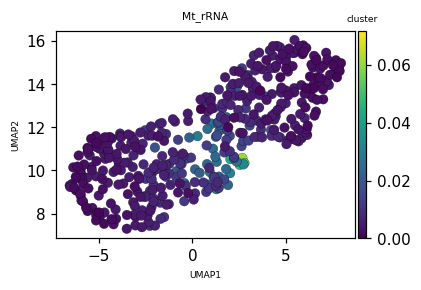

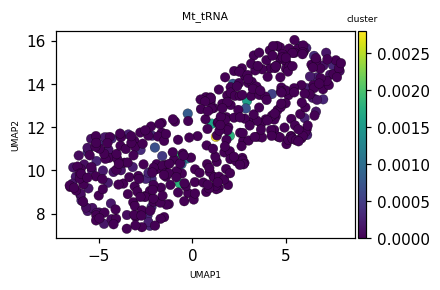

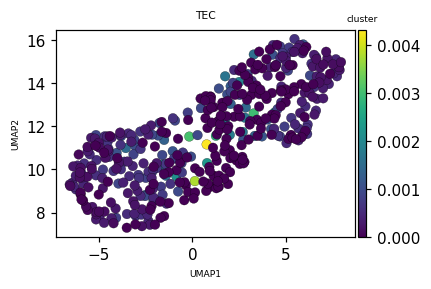

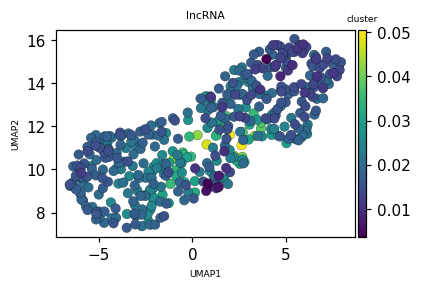

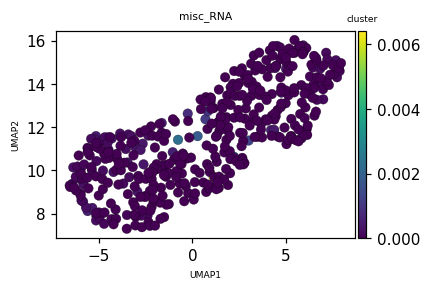

...

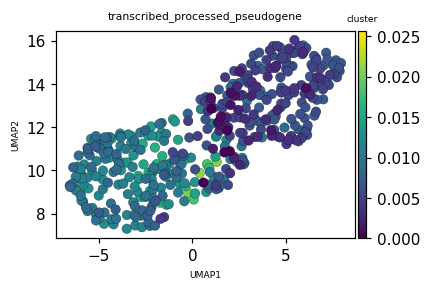

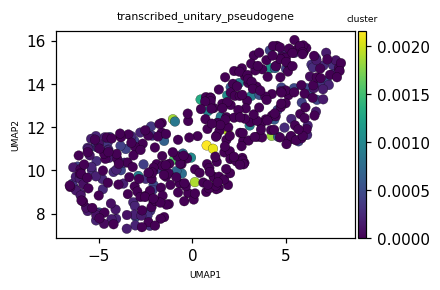

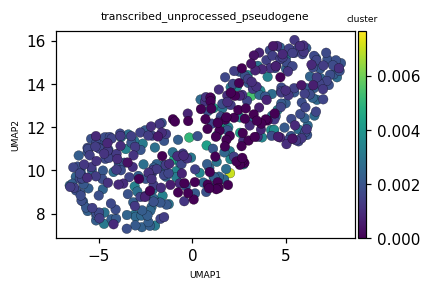

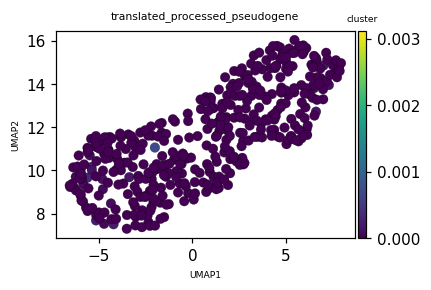

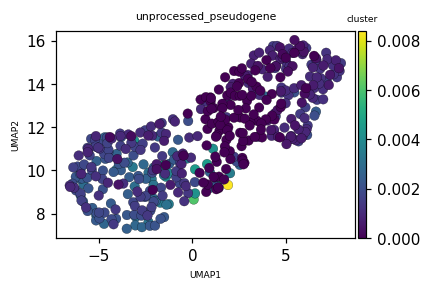

In [2876]:
for ch in np.unique(sc.var["gene_biotype"]) :
    x = sc.layers["raw"].toarray()[:, sc.var["gene_biotype"] == ch]
    sc.obs["biotype"] = x.sum(1) / sc.obs["total_UMIs"]
    rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["biotype"], \
    s = 40, xlabel="UMAP1", ylabel="UMAP2", color_title = "cluster", title = ch, linewidth=0.15, order_color = "descending")

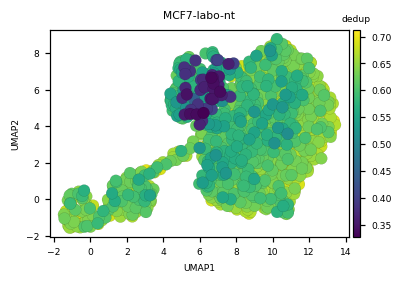

In [508]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["DedupRate"], \
    s = 60, xlabel="UMAP1", ylabel="UMAP2", color_title = "dedup", title = new_sample_name, linewidth=0.05, order_color = "descending")

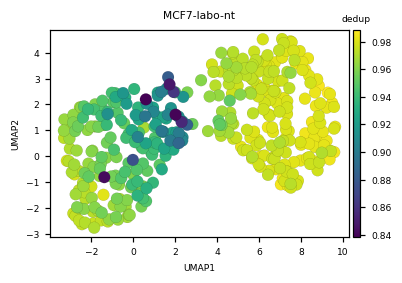

In [247]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["dedup_per_cell"], \
    s = 60, xlabel="UMAP1", ylabel="UMAP2", color_title = "dedup", title = new_sample_name, linewidth=0.05, order_color = "descending")

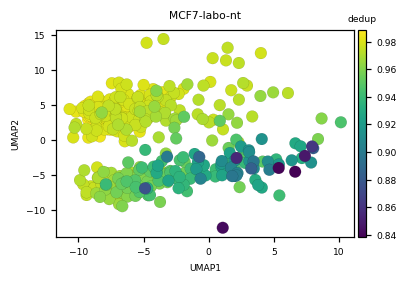

In [248]:
rnaseq.plotting.scatter(sc.obsm["X_pca"][:,0], sc.obsm["X_pca"][:,1], color = sc.obs["dedup_per_cell"], \
    s = 60, xlabel="UMAP1", ylabel="UMAP2", color_title = "dedup", title = new_sample_name, linewidth=0.05, order_color = "descending")

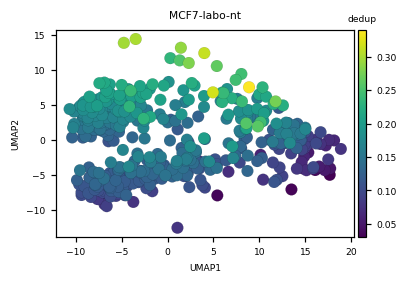

In [182]:
rnaseq.plotting.scatter(sc.obsm["X_pca"][:,0], sc.obsm["X_pca"][:,1], color = sc.obs["rp_frac"], \
    s = 60, xlabel="UMAP1", ylabel="UMAP2", color_title = "dedup", title = new_sample_name, linewidth=0.05, order_color = "ascending")

In [190]:
a = sc.var["external_gene_name"].values[np.argsort([stats.pearsonr(g, sc.obsm["X_pca"][:,1])[0] for g in sc.X.toarray().T])[::-1][:100]]

In [147]:
b = sc.var["external_gene_name"].values[np.argsort(sc.var["dedup_per_gene"].values)[::-1][:100]]

In [148]:
np.intersect1d(a,b)

array([], dtype=object)

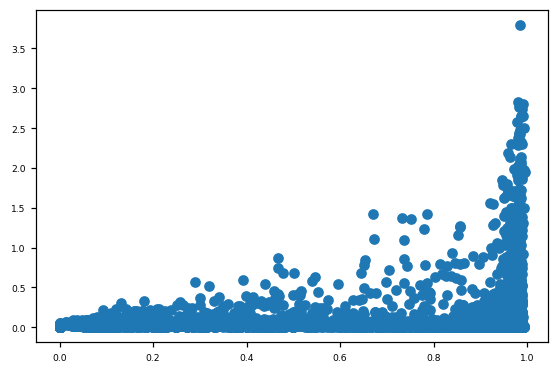

In [183]:
plt.scatter(sc.var["dedup_per_gene"], sc.X.toarray().mean(0))
# plt.yscale("log");

In [149]:
sc._inplace_subset_var(sc.X.toarray().mean(0)>0.5)

In [ ]:
x = sc.layers["raw"].toarray()[:, [g in apop_sig for g in sc.var["external_gene_name"]]]
sc.obs["biotype"] = np.log1p(1e5 * x.sum(1) / sc.obs["total_UMIs"])
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["biotype"], \
s = 40, xlabel="UMAP1", ylabel="UMAP2", color_title = "cluster", title = ch, linewidth=0.15, order_color = "ascending")

In [2758]:
# sc.var["external_gene_name"][sc.var["dedup_per_gene"]<0.7].to_csv("./genes.csv", header=None, index=None)

In [2829]:
nrp = np.sum([s.startswith("RP") for s in sc.var["external_gene_name"]])
ld = np.sum([d<0.5 for d in sc.var["dedup_per_gene"]])

np.sum(["ribosomal" in s.split(" ") or "ribosome" in s.split(" ") or n.startswith("RP") and d<0.5 for s,d,n in zip(sc.var["description"], sc.var["dedup_per_gene"], sc.var["external_gene_name"])]) / ld

0.7917485265225933

In [2813]:
np.unique(sc.var["gene_biotype"][sc.var["dedup_per_gene"]<0.7], return_counts=True)

(array(['Mt_tRNA', 'TEC', 'lncRNA', 'processed_pseudogene',
        'protein_coding', 'transcribed_processed_pseudogene',
        'transcribed_unprocessed_pseudogene', 'unprocessed_pseudogene'],
       dtype=object),
 array([   4,    3,   20, 1054,   53,   50,    6,   12]))

In [2915]:
np.unique(sc.var["gene_biotype"][sc.var["dedup_per_gene_1"]<0.7], return_counts=True)

(array(['Mt_tRNA', 'TEC', 'lncRNA', 'polymorphic_pseudogene',
        'processed_pseudogene', 'protein_coding',
        'transcribed_processed_pseudogene',
        'transcribed_unprocessed_pseudogene', 'unprocessed_pseudogene'],
       dtype=object),
 array([   4,    2,   28,    1, 1549,   80,   75,    6,   23]))

In [2822]:
sc.var_names = sc.var["external_gene_name"]
sc.var["description"][(sc.var["dedup_per_gene"]<0.7) & (sc.var["gene_biotype"] == "processed_pseudogene")][-10:]

external_gene_name
FTH1P8        ferritin heavy chain 1 pseudogene 8 [Source:HG...
BX322650.1                     nucleolar protein 11, pseudogene
XRCC6P2       X-ray repair cross complementing 6 pseudogene ...
RPL18AP16     ribosomal protein L18a pseudogene 16 [Source:H...
HMGN1P37      high mobility group nucleosome binding domain ...
EIF4A1P2      eukaryotic translation initiation factor 4A1 p...
KRT18P10      keratin 18 pseudogene 10 [Source:HGNC Symbol;A...
RPL26P37      ribosomal protein L26 pseudogene 37 [Source:HG...
ATP5PFP1      ATP synthase peripheral stalk subunit F6 pseud...
PSMA6P1       proteasome subunit alpha 6 pseudogene 1 [Sourc...
Name: description, dtype: object

In [ ]:
sc.var["tot_umis_per_gene"] = sc.layers["raw"].toarray().sum(0)
plt.scatter(sc.var["exonic_length"][[s.startswith("RP") for s in sc.var["external_gene_name"]]], sc.var["dedup_per_gene"][[s.startswith("RP") for s in sc.var["external_gene_name"]]])
plt.xscale('log');

In [2789]:
stats.pearsonr(np.log(sc.var["exonic_length"][sc.var["tot_umis_per_gene"]>10]), sc.var["dedup_per_gene"][sc.var["tot_umis_per_gene"]>10])

(0.7040246157386884, 0.0)

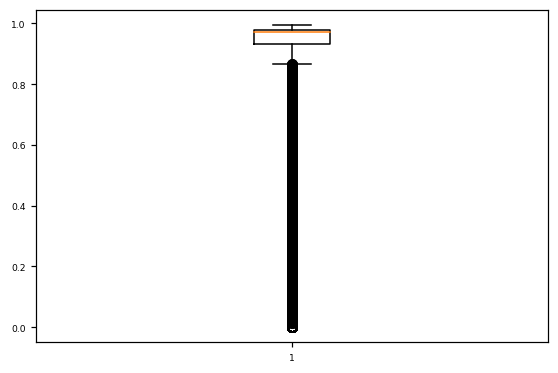

In [184]:
plt.boxplot(sc.var["dedup_per_gene"][~np.isnan(sc.var["dedup_per_gene"].values)]);

In [ ]:
sc.obs["dedup_per_cell"] = 1 - (sc.layers["raw"].toarray().sum(1)/ sc.layers["no_dedup"].toarray().sum(1))
sc.var["dedup_per_gene"] = 1 - (sc.layers["raw"].toarray().sum(0)/ sc.layers["no_dedup"].toarray().sum(0))

sc.var["dedup_per_gene_0"] = 1 - (sc.layers["raw"].toarray()[sc.obs["cnv_leiden"].values=="0"].sum(0)/ sc.layers["no_dedup"].toarray()[sc.obs["cnv_leiden"].values=="0"].sum(0))
sc.var["dedup_per_gene_1"] = 1 - (sc.layers["raw"].toarray()[sc.obs["cnv_leiden"].values=="1"].sum(0)/ sc.layers["no_dedup"].toarray()[sc.obs["cnv_leiden"].values=="1"].sum(0))
plt.boxplot([sc.var["dedup_per_gene_0"][[d>0.9 and t>100 for d,t in zip(sc.var["dedup_per_gene"], sc.var["tot_umis_per_gene"])]], sc.var["dedup_per_gene_1"][[d>0.9 and t>100 for d,t in zip(sc.var["dedup_per_gene"], sc.var["tot_umis_per_gene"])]]]);

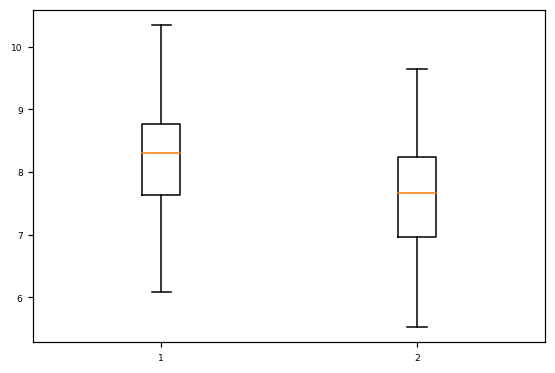

In [189]:
plt.boxplot([np.log(sc.obs["total_UMIs"][sc.obs["cnv_leiden"] == '0']), np.log(sc.obs["total_UMIs"][sc.obs["cnv_leiden"] == '1'])]);

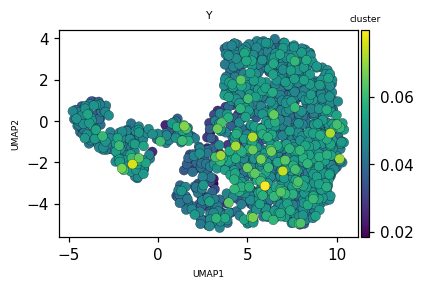

In [1946]:
# x = sc.layers["raw"].toarray()[:, (sc.var["chromosome_name"] == '19') & ([not s.startswith("RP") for s in sc.var["external_gene_name"]])]
# sc.obs["biotype"] = x.sum(1) / sc.obs["total_UMIs"]
# rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["biotype"], \
# s = 40, xlabel="UMAP1", ylabel="UMAP2", color_title = "cluster", title = ch, linewidth=0.15, order_color = "ascending")

Annotating exonic_length using /home/arion/davidm/Data/references/human/assembly__GRCh38-hg38/annotation__gencode/gencode_34/biomart_ens100/ensembl_gene_id-to-exonic_length.csv...


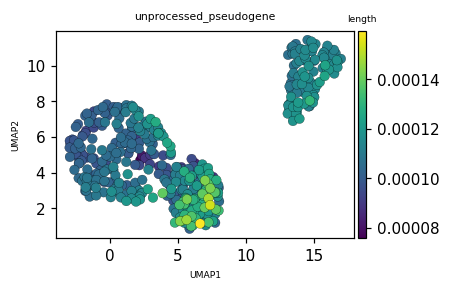

In [3388]:
rnaseq.setup.annotate_genes(sc, genes_annot_name = "exonic_length", compute_length = {"start" : "exon_chrom_start", "stop" : "exon_chrom_end"}, save_path = annot_path + "/biomart_ens100", ow=True)

x = sc.layers["raw"].toarray() * sc.var["exonic_length"].values.astype(float)
sc.obs["len"] = x.sum(1) / (sc.obs["total_UMIs"]*sc.var["exonic_length"].values.astype(float).sum())
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["len"], \
s = 40, xlabel="UMAP1", ylabel="UMAP2", color_title = "length", title = ch, linewidth=0.15, order_color = "ascending")

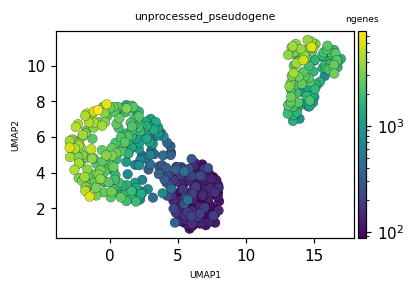

In [3387]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["#_genes"], \
s = 40, norm=LogNorm(), xlabel="UMAP1", ylabel="UMAP2", color_title = "ngenes", title = ch, linewidth=0.15, order_color = "ascending")

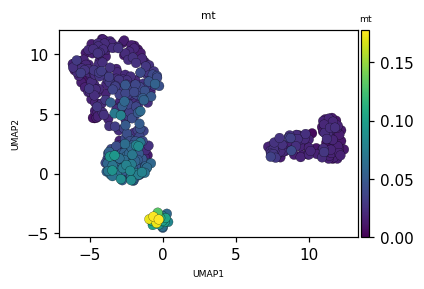

In [62]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["mt_frac"], \
s = 40, xlabel="UMAP1", ylabel="UMAP2", color_title = "mt", title = "mt", linewidth=0.15, order_color = "ascending")

In [2445]:
# sc._inplace_subset_var([not g.startswith('RP') for g in sc.var["external_gene_name"]]);

percentage_gene_gc_content already annotated. Set ow = True if you want to overwrite.


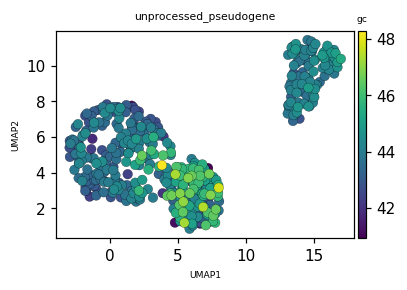

In [3384]:
rnaseq.setup.annotate_genes(sc, "percentage_gene_gc_content")

# x = sc.layers["raw"].toarray() * sc.var["percentage_gene_gc_content"].values.astype(float)
# sc.obs["gc"] = x.sum(1) / (sc.obs["total_UMIs"] * (sc.var["percentage_gene_gc_content"].values.astype(float)).sum())

x = sc.layers["raw"].toarray() * sc.var["percentage_gene_gc_content"].values.astype(float)
sc.obs["gc"] = x.sum(1) / sc.obs["total_UMIs"]
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["gc"], \
s = 40, xlabel="UMAP1", ylabel="UMAP2", color_title = "gc", title = ch, linewidth=0.15, order_color = "ascending")

In [3123]:
np.min(sc.var["percentage_gene_gc_content"])

'33.32'

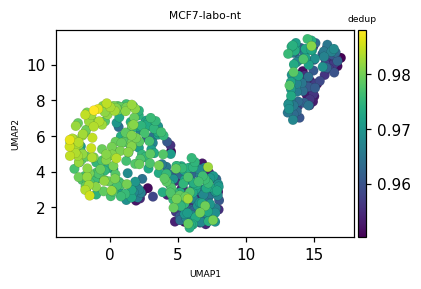

In [3385]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["dedup_per_cell"], \
    s = 40, xlabel="UMAP1", ylabel="UMAP2", color_title = "dedup", title = new_sample_name, linewidth=0.05,order_color = "ascending")

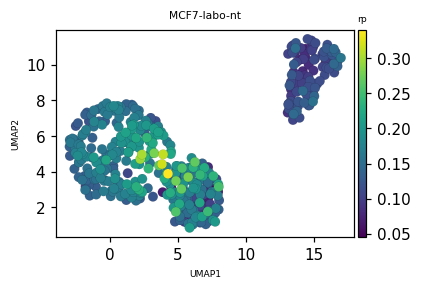

In [3389]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["rp_frac"], \
    s = 40, xlabel="UMAP1", ylabel="UMAP2", color_title = "rp", title = new_sample_name, linewidth=0.05,order_color = "ascending")

In [2589]:
rnaseq.setup.annotate_genes(sc, "external_gene_name", ow=True)
rnaseq.setup.annotate_genes(sc, "chromosome_name", ow=True)
rnaseq.setup.annotate_samples(sc, "mt_frac", ow=True)

Annotating chromosome_name using Biomart (Ensembl Genes 100, 'hsapiens_gene_ensembl')...
Annotating mt_frac...
chromosome_name already annotated. Set ow = True if you want to overwrite.


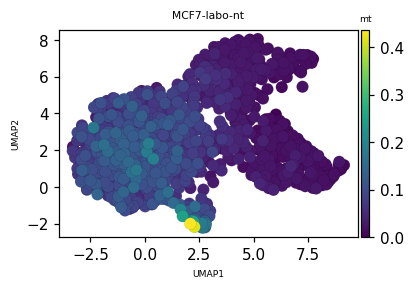

In [3295]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["mt_frac"], \
    s = 60, xlabel="UMAP1", ylabel="UMAP2", color_title = "mt", title = new_sample_name, linewidth=0.05,order_color = "ascending")

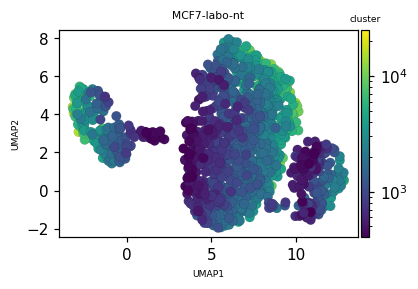

In [2461]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["total_UMIs"], \
    s = 40, norm=LogNorm(), xlabel="UMAP1", ylabel="UMAP2", color_title = "cluster", title = new_sample_name, linewidth=0.05)

In [466]:
scanpy.tl.leiden(sc, key_added="cnv_leiden", resolution = 0.19, directed=True)

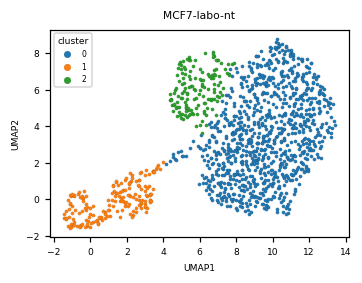

In [467]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["cnv_leiden"], \
    s = 5, xlabel="UMAP1", ylabel="UMAP2", color_title = "cluster", title = new_sample_name, linewidth=0.05)

In [227]:
sc._inplace_subset_obs(sc.obs["cnv_leiden"] != '2')

In [2902]:
i = np.argsort(sc.var["dedup_per_gene_1"] - sc.var["dedup_per_gene_0"])[-10:].values

In [2903]:
sc.var.loc[sc.var_names[i]]

,ensembl_gene_id,external_gene_name,dedup_per_gene,gene_biotype,chromosome_name,dedup_per_gene_0,dedup_per_gene_1,tot_umis_per_gene
29519,ENSG00000134461,ANKRD16,0.968300,protein_coding,10,0.600000,0.973684,11.0
57260,ENSG00000100196,KDELR3,0.973354,protein_coding,22,0.973684,0.973077,51.0
41605,ENSG00000203485,INF2,0.961538,protein_coding,14,0.949384,0.970106,68.0
22755,ENSG00000197008,ZNF138,0.970422,protein_coding,7,0.929688,0.978245,47.0
3444,ENSG00000143622,RIT1,0.974922,protein_coding,1,0.962536,0.977664,48.0
10114,ENSG00000170266,GLB1,0.980401,protein_coding,3,0.975256,0.982370,83.0
340,ENSG00000162441,LZIC,0.972359,protein_coding,1,0.966086,0.975029,101.0
5359,ENSG00000227953,LINC01341,0.966346,lncRNA,1,0.823529,0.979058,7.0
42878,ENSG00000069869,NEDD4,0.989161,protein_coding,15,0.980932,0.992194,19.0
39056,ENSG00000136111,TBC1D4,0.949367,protein_coding,13,0.953216,0.944828,16.0


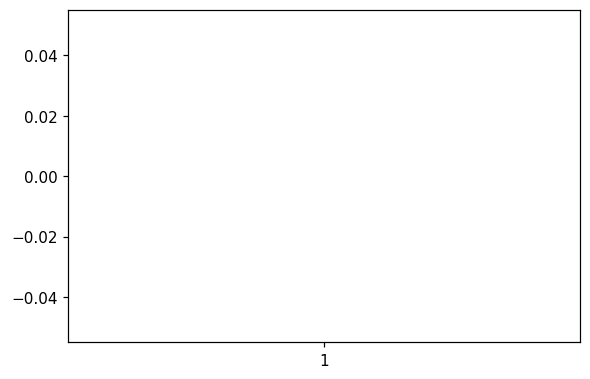

In [2906]:
plt.boxplot([sc.var["dedup_per_gene_0"].astype(float), sc.var["dedup_per_gene_1"]]);

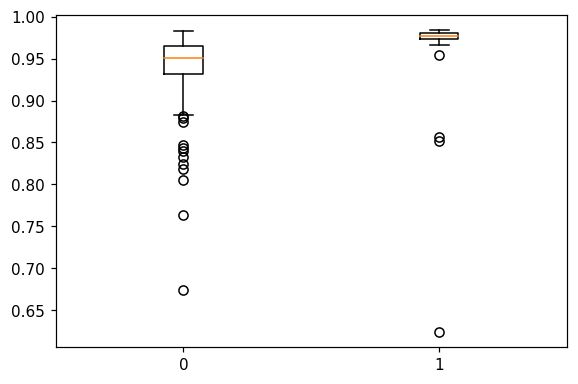

In [2483]:
clusters = np.unique(sc.obs["cnv_leiden"].values)
plt.boxplot([sc.obs["DedupRate"][sc.obs["cnv_leiden"].values==str(c)] \
             for c in range(len(clusters))], labels = clusters);

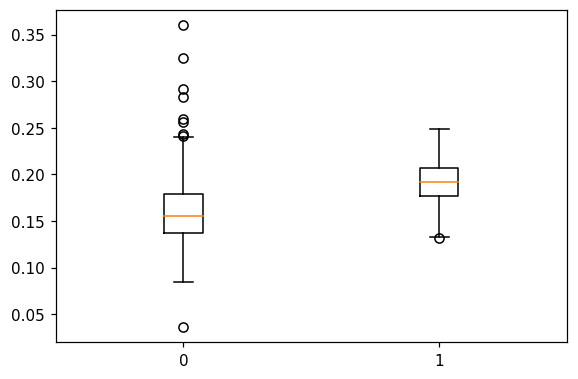

In [2484]:
clusters = np.unique(sc.obs["cnv_leiden"].values)
plt.boxplot([sc.obs["rp_frac"][sc.obs["cnv_leiden"].values==str(c)] \
             for c in range(len(clusters))], labels = clusters);

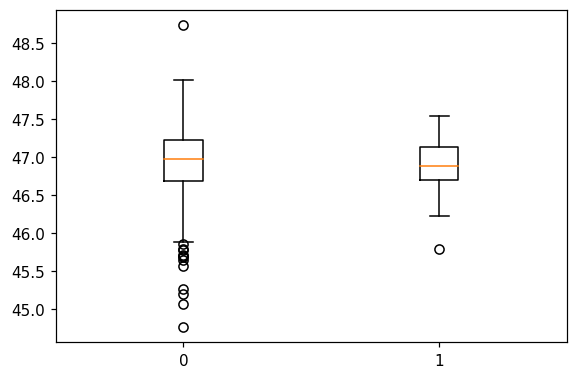

In [2485]:
clusters = np.unique(sc.obs["cnv_leiden"].values)
plt.boxplot([sc.obs["gc"][sc.obs["cnv_leiden"].values==str(c)] \
             for c in range(len(clusters))], labels = clusters);

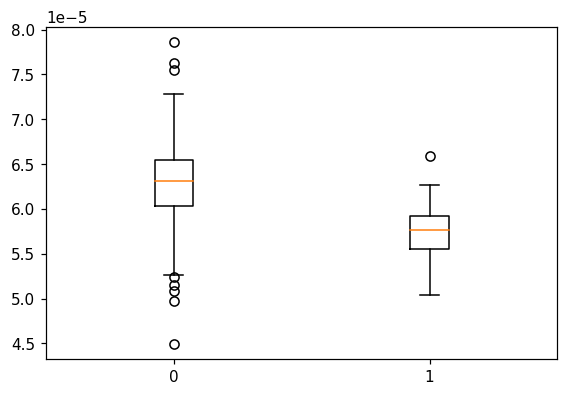

In [2487]:
clusters = np.unique(sc.obs["cnv_leiden"].values)
plt.boxplot([sc.obs["len"][sc.obs["cnv_leiden"].values==str(c)] \
             for c in range(len(clusters))], labels = clusters);

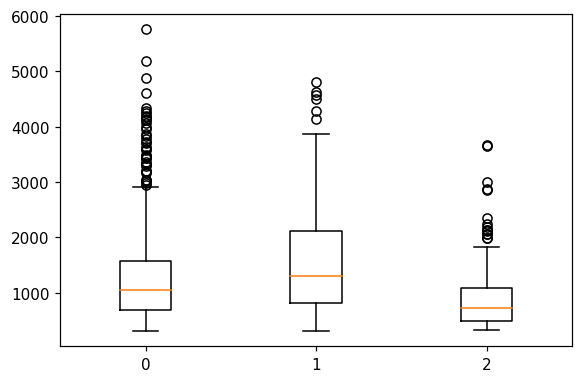

In [2387]:
clusters = np.unique(sc.obs["cnv_leiden"].values)
plt.boxplot([sc.obs["genes_w_UMIs"][sc.obs["cnv_leiden"].values==str(c)] \
             for c in range(len(clusters))], labels = clusters);

In [1557]:
for c in range(len(np.unique(sc.obs["cnv_leiden"]))):
    p = prob_mt_low[sc.obs["cnv_leiden"]==str(c)].mean()
    print(f"{c}, {p}")

0, 0.06601380746409573
1, 0.011550686835923349
2, 0.0218656395067709
3, 0.08491331031539719
4, 0.04129575332213712
5, 0.012865396190300792
6, 0.10247827981559142
7, 0.0156864825831142


In [ ]:
for cl in range(len(np.unique(sc.obs["cnv_leiden"]))):
    c = str(cl)
    p = prob_umis_low[sc.obs["cnv_leiden"]==c].mean()
    print(f"{c}, {p}")
#     if p > 0.5 :
#         prob_umis_high = prob_umis_high[sc.obs["cnv_leiden"] != c]
#         prob_umis_low = prob_umis_low[sc.obs["cnv_leiden"] != c]
#         prob_mt_high = prob_mt_high[sc.obs["cnv_leiden"] != c]
#         prob_mt_low = prob_mt_low[sc.obs["cnv_leiden"] != c]

#         sc._inplace_subset_obs(sc.obs["cnv_leiden"] != c)

In [1463]:
c = '1'

prob_umis_high = prob_umis_high[sc.obs["cnv_leiden"] != c]
prob_umis_low = prob_umis_low[sc.obs["cnv_leiden"] != c]
prob_mt_high = prob_mt_high[sc.obs["cnv_leiden"] != c]
prob_mt_low = prob_mt_low[sc.obs["cnv_leiden"] != c]

sc._inplace_subset_obs(sc.obs["cnv_leiden"] != c)

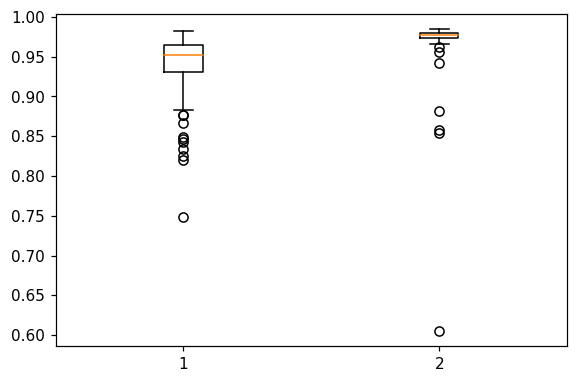

In [1584]:
plt.boxplot([sc.obs["DedupRate"].values[sc.obs["cnv_leiden"]=='0'], sc.obs["DedupRate"].values[sc.obs["cnv_leiden"]=='1']]);

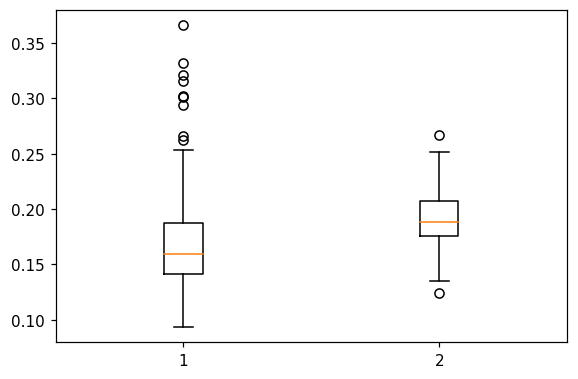

In [1585]:
plt.boxplot([sc.obs["rp_frac"].values[sc.obs["cnv_leiden"]=='0'], sc.obs["rp_frac"].values[sc.obs["cnv_leiden"]=='1']]);

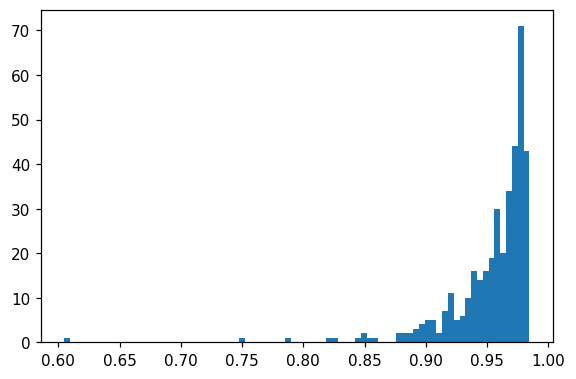

In [978]:
plt.hist(sc.obs["DedupRate"], bins=80);

In [2114]:
sc.var_names = sc.var["external_gene_name"]
sc.var_names_make_unique()
annot_path = "/home/arion/davidm/Data/references/human/assembly__GRCh38-hg38/annotation__gencode/gencode_34"
rnaseq.setup.annotate_genes(sc, "exon_chrom_end", save_path = annot_path + "/biomart_ens100")
rnaseq.setup.annotate_genes(sc, "exon_chrom_start", save_path = annot_path + "/biomart_ens100")
rnaseq.setup.annotate_genes(sc, "chromosome_name", save_path = annot_path + "/biomart_ens100")
cnv.io.genomic_position_from_gtf(f"{annot_path}/gencode.v34.basic.annotation.gtf", sc)

Annotating exon_chrom_end using /home/arion/davidm/Data/references/human/assembly__GRCh38-hg38/annotation__gencode/gencode_34/biomart_ens100/ensembl_gene_id-to-exon_chrom_end.csv...
Annotating exon_chrom_start using /home/arion/davidm/Data/references/human/assembly__GRCh38-hg38/annotation__gencode/gencode_34/biomart_ens100/ensembl_gene_id-to-exon_chrom_start.csv...
chromosome_name already annotated. Set ow = True if you want to overwrite.


/u/davidm/VirtualEns/python_3.9.5/lib/python3.9/site-packages/gtfparse/read_gtf.py:151: FutureWarning: The warn_bad_lines argument has been deprecated and will be removed in a future version.


  result = parse_gtf(
/u/davidm/VirtualEns/python_3.9.5/lib/python3.9/site-packages/gtfparse/read_gtf.py:151: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version.


  result = parse_gtf(


In [42]:
# sc.var.columns = ['ensembl_gene_id', 'chromosome', 'external_gene_name', 'end', 'start']

In [2119]:
import infercnvpy as cnv
cnv.tl.infercnv(
    sc,
    reference_key="cnv_leiden",
    reference_cat=[
        "0",
        "1",
        "2",
        "3",
    ],
    window_size=250,
)

  0%|          | 0/1 [00:00<?, ?it/s]

/u/davidm/VirtualEns/python_3.9.5/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'samples' as categorical
/u/davidm/VirtualEns/python_3.9.5/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'project_id' as categorical


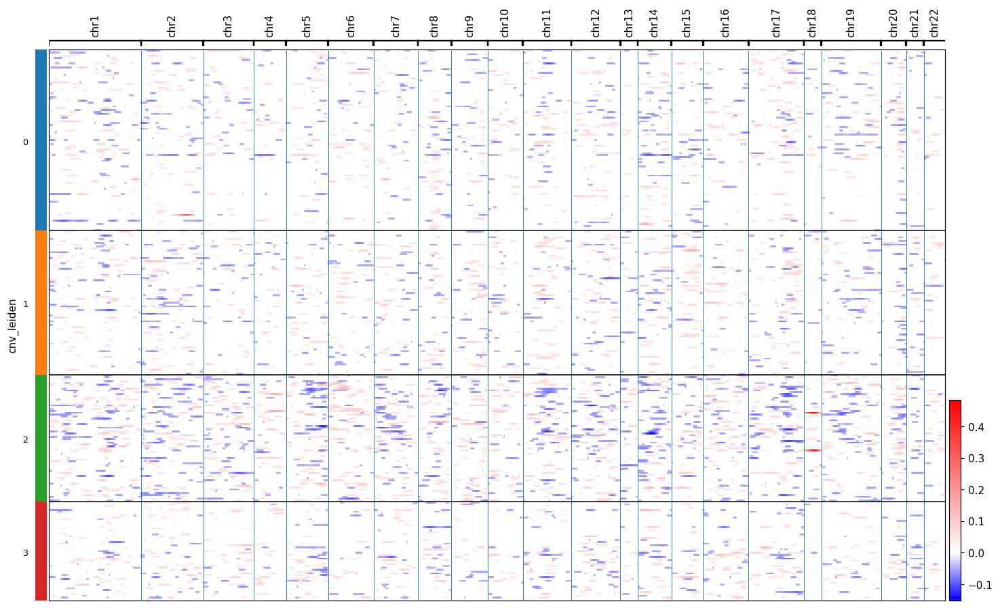

In [2120]:
cnv.pl.chromosome_heatmap(sc, groupby="cnv_leiden")

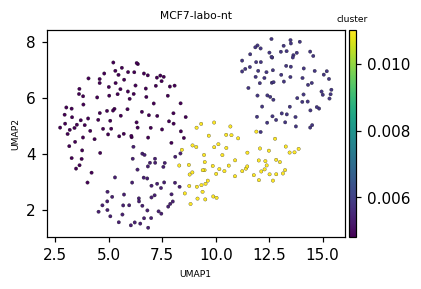

In [2121]:
cnv.tl.cnv_score(sc)
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["cnv_score"], \
    s = 5, xlabel="UMAP1", ylabel="UMAP2", color_title = "cluster", title = new_sample_name, linewidth=0.15)

#### CB patterns per cluster


In [2397]:
sc.obs_names[sc.obs["cnv_leiden"] == "0"]

Index(['ACTCAACTGTGC', 'CGACGGTGAATC', 'GTCCGTCATCCA', 'CCGGCTGGTGAC',
       'CGTCAGAGGAGT', 'GCCGGGTCCGAT', 'CGCGTGACTCCT', 'TGTGCTTTTACT',
       'GCCATGCCGCCT', 'TGACTAAAATAG',
       ...
       'AACCATCGGGAG', 'CGTATTAAACAC', 'TGAGCAAGATCA', 'TAAGATGGGTGA',
       'CTTTGGGGGAAA', 'GCGCACCTATGA', 'AATATAAGTACA', 'CATGGGTACGGA',
       'TTGTAGGACTGA', 'AACCACGGACTA'],
      dtype='object', name='CB', length=912)

In [2403]:
c = '2'
gc_content = []
for barcode in sc.obs_names[sc.obs["cnv_leiden"] == c] :
    tot = 0
    gc = 0
    for pos in np.arange(1,13) :
        if list(barcode)[pos-1] == "G" or list(barcode)[pos-1] == "C" :
            gc += 1
        tot +=1
    gc_content.append(gc/tot)
print(np.mean(gc_content))

0.4877777777777777


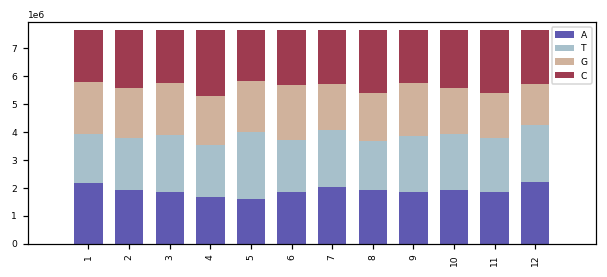

In [515]:
import seaborn as sb 

nucleotides = ["A","T","G","C"]
freq = {f"{pos}": {nt : 0 for nt in nucleotides} for pos in np.arange(1,13)}
c = '0'

for barcode in sc.obs_names[sc.obs["cnv_leiden"] == c] :
    for pos in np.arange(1,13) :
        nt = list(barcode)[pos-1]
        freq[f"{pos}"][nt] += sc.obs["raw_cb_freq"].loc[barcode]


counts = np.array([list(list(freq.values())[i].values()) for i in np.arange(12)])
fig, ax = plt.subplots(figsize=(5.5,2.5))
ax.set_prop_cycle('color', sb.color_palette("twilight_shifted", 4))
bottom = 0
for c in counts.T :
    ax.bar(np.arange(12), c, width = 0.7, bottom = bottom)
    bottom += c

ax.legend(labels = nucleotides)
plt.xticks(np.arange(12), labels = freq.keys(), rotation = 90)
plt.ylim(0,np.max(bottom)+np.max(bottom)/30)
plt.xlim(-1.5,12.5)
plt.tight_layout()

#### gsea

In [223]:
import gseapy as gp
importlib.reload(gp)

<module 'gseapy' from '/u/davidm/VirtualEns/python_3.9.5/lib/python3.9/site-packages/gseapy/__init__.py'>

In [474]:
rnaseq.setup.annotate_genes(sc, 'description')

Annotating description using Biomart (Ensembl Genes 100, 'hsapiens_gene_ensembl')...


In [472]:
gene_exp = pd.DataFrame(sc.X.toarray().T, columns = sc.obs["CB"].values)
class_vector = (sc.obs["cnv_leiden"].values == '2').astype(str)
class_vector = np.where(class_vector == 'True', "cluster", class_vector) 
class_vector = np.where(class_vector == 'False', "rest", class_vector) 

In [475]:
idx = np.argsort(class_vector)
gene_exp = gene_exp[gene_exp.columns[idx]]
gene_exp.insert(0, "DESCRIPTION", sc.var["description"].values, True)
gene_exp.insert(0, "NAME", sc.var["external_gene_name"].values, True)

class_vector = list(class_vector[idx])

In [476]:
gs_res = gp.gsea(gene_exp, # ordata='./P53_resampling_data.txt'
                 'MSigDB_Hallmark_2020', # enrichr library names
                  class_vector,
                 # set permutation_type to phenotype if samples >=15
                 permutation_type='phenotype',
                 permutation_num=100, # reduce number to speed up test
                 outdir=None,  # do not write output to disk
                 no_plot=True, # Skip plotting
                 method='signal_to_noise',
                 processes=4, seed= 7,
                 format='png')

2021-12-02 15:33:39,563 Warning: dropping duplicated gene names, only keep the first values


In [477]:
res = gs_res.res2d.sort_values(by='nes', ascending=False)
res = res.loc[res.index[(res['fdr'].values < 0.05) & (res['pval'].values < 0.05)]]

In [478]:
res

,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
Term,,,,,,,,
Fatty Acid Metabolism,0.368691,1.907406,0.000000,0.000000,158,126,LGALS1;ECH1;HSDL2;PDHB;CPOX;CYP1A1;SLC22A5;CCD...,LGALS1;ECH1;HSDL2;PDHB;CPOX;CYP1A1;SLC22A5;CCD...
Notch Signaling,0.495292,1.834178,0.000000,0.028477,32,23,LFNG;KAT2A;MAML2;SAP30;HES1;PPARD;RBX1;PSENEN;...,LFNG;KAT2A;MAML2;SAP30;HES1;PPARD;RBX1;PSENEN;...
Myc Targets V1,0.402778,1.787357,0.043478,0.037969,200,200,PPIA;MRPL23;RPL34;EPRS1;RPL6;CANX;ABCE1;DUT;RP...,PPIA;MRPL23;RPL34;EPRS1;RPL6;CANX;ABCE1;DUT;RP...
Androgen Response,0.357856,1.760782,0.000000,0.042715,100,88,SPDEF;MYL12A;HMGCS1;APPBP2;ANKH;ELL2;FADS1;H1-...,SPDEF;MYL12A;HMGCS1;APPBP2;ANKH;ELL2;FADS1;H1-...
IL-2/STAT5 Signaling,0.304021,1.614301,0.000000,0.047461,199,134,SCN9A;BMPR2;CSF1;GSTO1;CAPG;ECM1;XBP1;CCND2;GU...,SCN9A;BMPR2;CSF1;GSTO1;CAPG;ECM1;XBP1;CCND2;GU...


In [885]:
res

,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
Term,,,,,,,,
TNF-alpha Signaling via NF-kB,0.515889,2.450542,0.0,0.000000,200,127,SQSTM1;PMEPA1;KLF6;BTG1;JUN;ATP2B1;BTG2;FOS;JU...,SQSTM1;PMEPA1;KLF6;BTG1;JUN;ATP2B1;BTG2;FOS;JU...
Myogenesis,0.461941,2.340868,0.0,0.000000,200,95,APOD;CLU;GSN;NQO1;BAG1;ERBB3;AGRN;IGFBP3;CDKN1...,APOD;CLU;GSN;NQO1;BAG1;ERBB3;AGRN;IGFBP3;CDKN1...
Angiogenesis,0.664273,2.079489,0.0,0.000000,36,16,TNFRSF21;PTK2;APP;THBD;TIMP1;ITGAV;VEGFA;KCNJ8...,TNFRSF21;PTK2;APP;THBD;TIMP1;ITGAV;VEGFA;KCNJ8...
Apical Surface,0.649983,1.975543,0.0,0.000000,44,22,GATA3;APP;B4GALT1;ADAM10;EFNA5;EPHB4;LYPD3;CRY...,GATA3;APP;B4GALT1;ADAM10;EFNA5;EPHB4;LYPD3;CRY...
UV Response Dn,0.414603,1.916056,0.0,0.000000,144,106,ATP2B1;ICA1;SMAD3;PTPN21;LAMC1;CITED2;RND3;BHL...,ATP2B1;ICA1;SMAD3;PTPN21;LAMC1;CITED2;RND3;BHL...
p53 Pathway,0.369722,1.830161,0.0,0.000000,200,162,CDKN2B;ZFP36L1;S100A10;BTG1;DDIT4;JUN;XPC;BTG2...,CDKN2B;ZFP36L1;S100A10;BTG1;DDIT4;JUN;XPC;BTG2...
KRAS Signaling Dn,0.368274,1.735902,0.0,0.013455,200,52,BTG2;TGFB2;CAMK1D;UPK3B;MTHFR;SKIL;IDUA;PKP1;S...,BTG2;TGFB2;CAMK1D;UPK3B;MTHFR;SKIL;IDUA;PKP1;S...
Inflammatory Response,0.382226,1.670305,0.0,0.023547,200,73,KLF6;ATP2B1;BTG2;CDKN1A;TAPBP;CD55;SELENOS;FZD...,KLF6;ATP2B1;BTG2;CDKN1A;TAPBP;CD55;SELENOS;FZD...
Hypoxia,0.337656,1.599681,0.0,0.027907,200,139,KLF6;BTG1;DDIT4;NEDD4L;JUN;FOS;ZNF292;EFNA1;SE...,KLF6;BTG1;DDIT4;NEDD4L;JUN;FOS;ZNF292;EFNA1;SE...


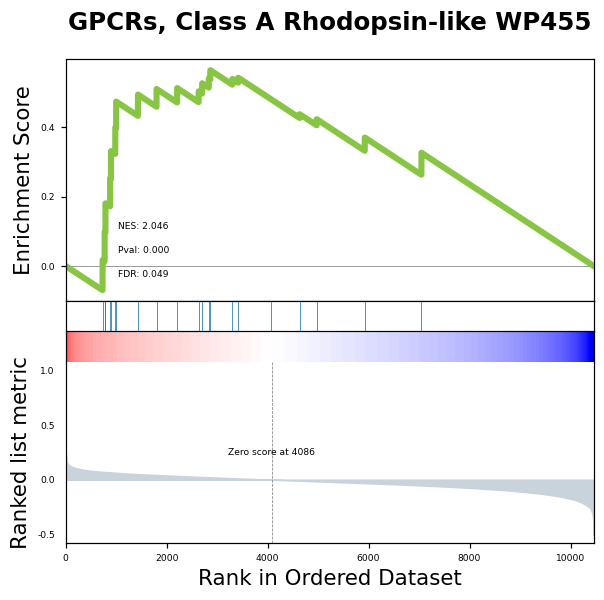

In [2152]:
from gseapy.plot import gseaplot, heatmap
terms = res.index
# Make sure that ``ofname`` is not None, if you want to save your figure to disk
gseaplot(gs_res.ranking, term=terms[0], **gs_res.results[terms[0]])

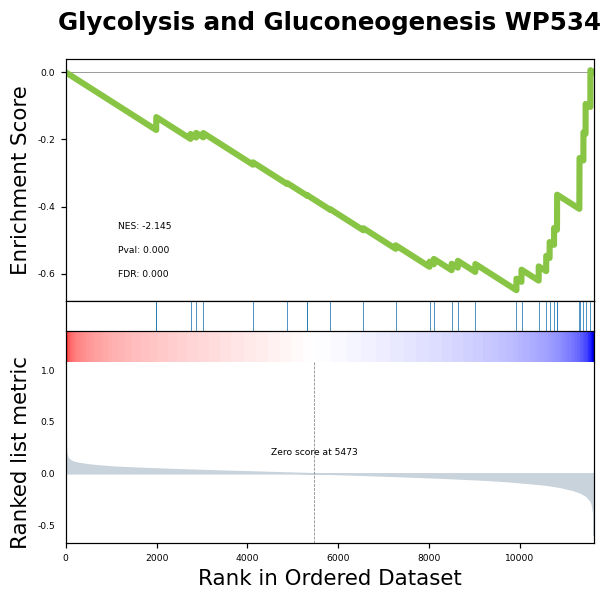

In [1338]:
from gseapy.plot import gseaplot, heatmap
terms = res.index
# Make sure that ``ofname`` is not None, if you want to save your figure to disk
gseaplot(gs_res.ranking, term=terms[14], **gs_res.results[terms[14]])

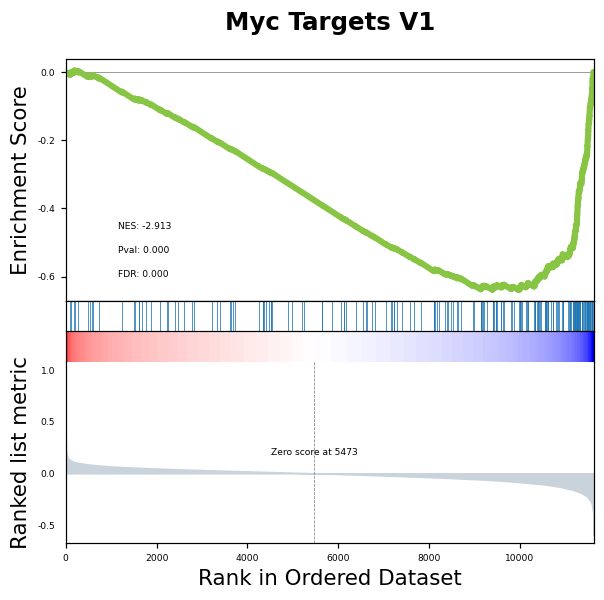

In [1329]:
from gseapy.plot import gseaplot, heatmap
terms = res.index
# Make sure that ``ofname`` is not None, if you want to save your figure to disk
gseaplot(gs_res.ranking, term=terms[-2], **gs_res.results[terms[-2]])

#### de

In [510]:
de = []

In [441]:
# sc.obs["select"] = ['0' if sc.obs["cnv_leiden"][i] in ['0','2','3'] else '1' for i in range(len(sc.obs_names))]
# sc.obs["select"] = ['2' if sc.obs["cnv_leiden"][i] == '4' else sc.obs["select"][i] for i in range(len(sc.obs_names))]

In [2374]:
sc._inplace_subset_var([not g.startswith('RP') for g in sc.var["external_gene_name"]]);

In [468]:
sc.var_names = sc.var["external_gene_name"].values
scanpy.tl.rank_genes_groups(sc, groupby="cnv_leiden", n_genes=len(sc.var_names),rankby_abs=True, method="wilcoxon")

/u/davidm/VirtualEns/python_3.9.5/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'samples' as categorical
/u/davidm/VirtualEns/python_3.9.5/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'project_id' as categorical
/u/davidm/VirtualEns/python_3.9.5/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in

In [519]:
# de += list(scanpy.get.rank_genes_groups_df(sc, pval_cutoff=0.05, group = "1", log2fc_min=1)["names"].values)

In [524]:
# np.savetxt("./g.txt",np.unique(de), fmt="%s")

In [1260]:
# rnaseq.dea.enrichr(sc, group='3')

Please specify some libraries. 

Genes_Associated_with_NIH_Grants
Cancer_Cell_Line_Encyclopedia
Achilles_fitness_decrease
Achilles_fitness_increase
Aging_Perturbations_from_GEO_down
Aging_Perturbations_from_GEO_up
Allen_Brain_Atlas_10x_scRNA_2021
Allen_Brain_Atlas_down
Allen_Brain_Atlas_up
ARCHS4_Cell-lines
ARCHS4_IDG_Coexp
ARCHS4_Kinases_Coexp
ARCHS4_TFs_Coexp
ARCHS4_Tissues
Azimuth_Cell_Types_2021
BioCarta_2013
BioCarta_2015
BioCarta_2016
BioPlanet_2019
BioPlex_2017
CCLE_Proteomics_2020
CellMarker_Augmented_2021
ChEA_2013
ChEA_2015
ChEA_2016
Chromosome_Location
Chromosome_Location_hg19
ClinVar_2019
CORUM
COVID-19_Related_Gene_Sets
COVID-19_Related_Gene_Sets_2021
Data_Acquisition_Method_Most_Popular_Genes
dbGaP
DepMap_WG_CRISPR_Screens_Broad_CellLines_2019
DepMap_WG_CRISPR_Screens_Sanger_CellLines_2019
Descartes_Cell_Types_and_Tissue_2021
Disease_Perturbations_from_GEO_down
Disease_Perturbations_from_GEO_up
Disease_Signatures_from_GEO_down_2014
Disease_Signatures_from_GEO_up_2014
DisG

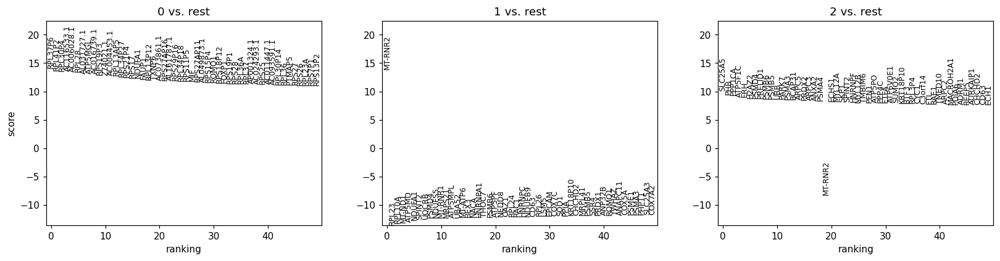

In [3393]:
scanpy.pl.rank_genes_groups(sc, n_genes=50)

In [2964]:
np.sum([g[0].startswith("AL") for g in sc.uns["rank_genes_groups"]["names"]])

9

In [2954]:
sc.var["external_gene_name"][sc.var["deg"]]

MTND1P23      MTND1P23
MTND2P28      MTND2P28
MTCO1P12      MTCO1P12
MTATP6P1      MTATP6P1
LINC01128    LINC01128
               ...    
LUZP1            LUZP1
HNRNPR          HNRNPR
ID3                ID3
RPL11            RPL11
ELOA              ELOA
Name: external_gene_name, Length: 172, dtype: category
Categories (11623, object): ['A4GALT', 'AAAS', 'AACS', 'AADAT', ..., 'ZXDC', 'ZYG11B', 'ZYX', 'ZZEF1']

{'whiskers': [<matplotlib.lines.Line2D at 0x7f4463f29370>,
 'caps': [<matplotlib.lines.Line2D at 0x7f4463f298b0>,
 'boxes': [<matplotlib.lines.Line2D at 0x7f449cd294f0>],
 'medians': [<matplotlib.lines.Line2D at 0x7f4463f15d00>],
 'fliers': [<matplotlib.lines.Line2D at 0x7f4463f15700>],
 'means': []}

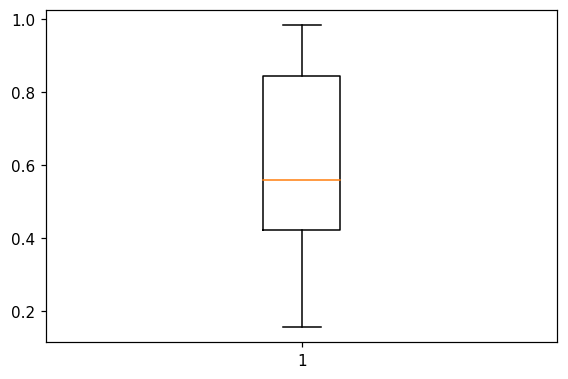

In [2967]:
plt.boxplot(sc.var["dedup_per_gene"][[g[0] for g in sc.uns["rank_genes_groups"]["names"]]])

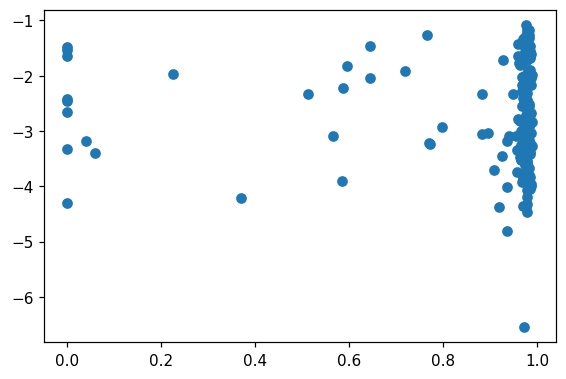

In [2953]:
# sc.var["deg"] = (np.abs([p[1] for p in sc.uns["rank_genes_groups"]["logfoldchanges"]])>1) & (np.array([p[1] for p in sc.uns["rank_genes_groups"]["pvals_adj"]])<0.0000000001)
sc.var_names = sc.var["external_gene_name"]
plt.scatter(sc.var["dedup_per_gene"][sc.uns["rank_genes_groups"]["names"]], np.array([p[0] for p in sc.uns["rank_genes_groups"]["logfoldchanges"]])[sc.var["deg"].values])

In [3096]:
sc.uns["rank_genes_groups"]["names"][:20]

rec.array([('RPS27', 'RPS27'), ('RPL37A', 'RPL37A'), ('RPL41', 'RPL41'),
           ('RPS29', 'RPS29'), ('RPL23A', 'RPL23A'), ('RPS25', 'RPS25'),
           ('RPS15', 'RPS15'), ('SLC25A5', 'SLC25A5'), ('HMGB1', 'HMGB1'),
           ('RPS21', 'RPS21'), ('RPL38', 'RPL38'), ('MT-ND4L', 'MT-ND4L'),
           ('TMA7', 'TMA7'), ('ATP5ME', 'ATP5ME'), ('RPS28', 'RPS28'),
           ('RPS18', 'RPS18'), ('ROMO1', 'ROMO1'), ('RPL37', 'RPL37'),
           ('RPL39', 'RPL39'), ('RPL26', 'RPL26')],
          dtype=[('0', 'O'), ('1', 'O')])

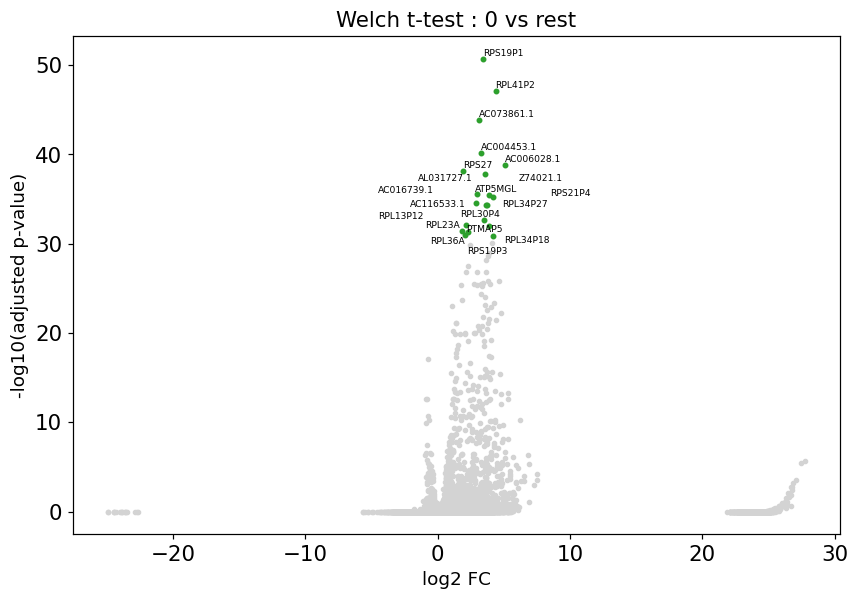

In [240]:
rnaseq.dea.volcano_plot(sc, group="0", top=20)

#### enrichr

In [ ]:
rnaseq.dea.enrichr(sc,group = "0")

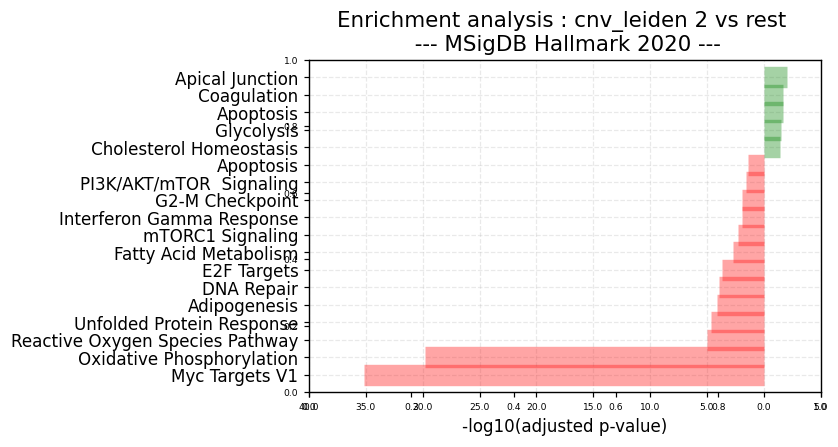

,index,Term,P-value,Z-score,Combined Score,Genes,Adjusted P-value,Old P-value,Old adjusted P-value,color
0,0,Myc Targets V1,0.0,14.358581,1218.763041,"[HSP90AB1, RPL34, RPLP0, RPL6, PSMD8, EEF1B2, FBL, PSMD7, SNRPD2, SNRPD1, RACK1, SNRPD3, RPS10, CCT2, RPS5, RPL22, RPS6, MRPS18B, NME1, PSMA6, PSMA4, PSMA2, SNRPG, NHP2, ERH, SNRPA1, PPIA, SET, U2AF1, COX5A, PSMA7, PRDX4, PSMB2, PSMB3, RPS3, RPL14, SNRPB2, RPS2, CYC1, RPL18, H2AZ1, RANBP1, NPM1, DUT, SSB, NOP16, NAP1L1, MRPL23, HSPE1, RSL1D1, NDUFAB1, SSBP1, RAN]",-35.181878,0,0,red
1,1,Oxidative Phosphorylation,0.0,12.444683,894.436858,"[COX7B, MRPS15, NDUFB8, ECHS1, UQCRB, NDUFB6, NDUFB5, MGST3, COX4I1, TIMM13, ATP5MC2, NDUFB2, ATP5MC3, UQCR11, COX7A2, ETFB, MRPL34, COX5B, COX6A1, COX5A, HSD17B10, UQCRFS1, CYC1, NDUFV2, ATP5MG, ATP6V1F, COX8A, ATP5PF, NDUFA8, ATP6V1G1, ATP6V0B, ATP6V0E1, GPX4, NDUFA4, NDUFC2, ATP5F1C, COX6C, ATP1B1, SDHB, ATP5F1E, NDUFS8, NDUFS7, UQCRQ, NDUFAB1, ATP5PO, NDUFS3, ATP6V0C, ISCU]",-29.833841,0,0,red
2,2,Reactive Oxygen Species Pathway,0.000001,9.432304,135.386843,"[NQO1, PRDX4, GPX4, PRDX1, MGST1, GLRX, TXN, FTL, SOD1, LAMTOR5]",-5.029538,0,0,red
3,3,Unfolded Protein Response,0.000002,5.225576,68.327039,"[NPM1, LSM1, LSM4, YIF1A, HSP90B1, CKS1B, RPS14, SERP1, SPCS1, EXOSC9, NHP2, EIF4EBP1, BANF1, SEC11A]",-4.599438,0,0,red
4,4,Adipogenesis,0.000008,3.666948,42.918,"[COX8A, RTN3, COX7B, MTCH2, ECHS1, GPX4, MGST3, AK2, UQCR11, ETFB, COX6A1, SDHB, SOD1, UQCRQ, NDUFAB1, ATP5PO, NDUFS3, CYC1]",-4.100716,0,0,red
5,5,DNA Repair,0.000013,4.106012,46.102802,"[GTF2A2, DUT, GPX4, AK1, TAF9, ADRM1, EDF1, RBX1, NME1, APRT, DGUOK, GUK1, DAD1, MPC2, POLR2G]",-3.973221,0,0,red
6,6,E2F Targets,0.000031,3.437515,35.719588,"[H2AZ1, JPT1, RANBP1, DUT, AK2, NAP1L1, NME1, CKS1B, PRDX4, PTTG1, UBE2T, STMN1, EXOSC8, CKS2, RAN, CDKN3, SNRPB]",-3.676657,0,0,red
7,7,Fatty Acid Metabolism,0.000355,3.298798,26.207574,"[H2AZ1, CBR1, HSP90AA1, ECHS1, MIF, HSD17B10, PTS, LGALS1, OSTC, PSME1, ERP29, BLVRA, S100A10]",-2.672137,0,0,red
8,8,mTORC1 Signaling,0.001076,2.768858,18.924322,"[ARPC5L, GLRX, HSPE1, HSP90B1, CCT6A, PSMA3, SERP1, PSMA4, PSMB5, PRDX1, EEF1E1, PPIA, GAPDH, SEC11A]",-2.241275,0,0,red
9,10,Interferon Gamma Response,0.003067,2.55233,14.770565,"[IFITM3, IFITM2, SRI, BST2, VAMP8, NFKBIA, MT2A, PSMA3, PSMB2, PSMA2, PSME1, PSME2, B2M]",-1.873453,0,0,red


/u/davidm/Documents/Master-thesis/Scripts/RNA-seq/python/rnaseq/dea.py:38: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = pd.DataFrame(np.array(data[gene_set_library])[:,1:], columns=["Term", "P-value", "Z-score", "Combined Score", "Genes", "Adjusted P-value", "Old P-value", "Old adjusted P-value"])


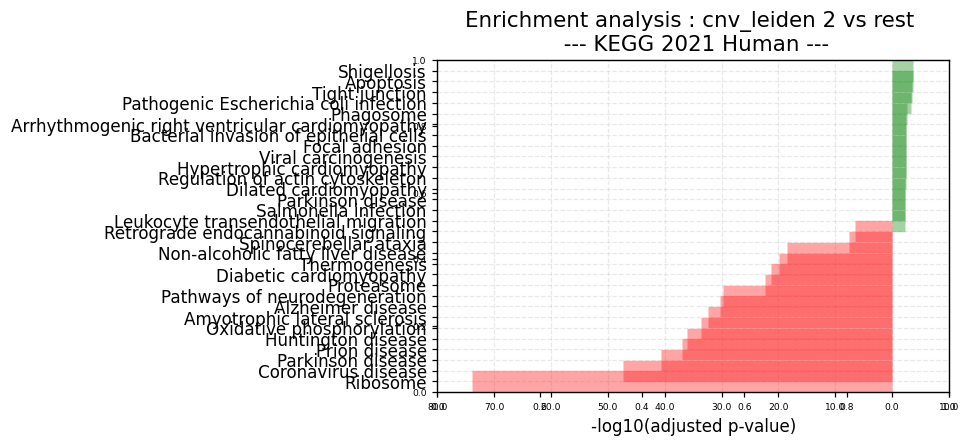

,index,Term,P-value,Z-score,Combined Score,Genes,Adjusted P-value,Old P-value,Old adjusted P-value,color
0,0,Ribosome,0.0,38.878682,6822.461108,"[RPL5, RPL30, MRPS15, RPL32, RPL31, RPL34, RPLP1, RPLP0, RPL10A, RPL8, MRPL34, RPL9, RPL6, MRPL32, RPL7, RPS15, RPS4X, RPS14, RPL7A, RPS17, RPS16, RPL18A, RPS19, RPL36AL, RPS18, RPL35, RPLP2, RPS11, RPS10, RPS13, RPS12, RPS9, RPL21, RPS7, RPS8, RPL23, RPS5, RPL22, RPS6, RPL13A, RPSA, RPS3A, RPL24, RPL27, RPL26, UBA52, RPL10, MRPL18, RPL12, RPL11, RPL36A, MRPL14, MRPL13, MRPL20, RPS15A, RPL14, RPS3, RPL13, RPL15, RPS2, RPL18, RPS27A, RPL17, RPL19, RPL41, RPL35A, RPL23A, MRPL23, MRPL24, MRPL22, RPS25, RPS27, RPL27A, FAU, RPS24, RPS23]",-73.848602,0,0,red
1,1,Coronavirus disease,0.0,16.636415,1892.20516,"[RPL5, RPL30, RPL32, RPL31, RPL34, RPLP1, RPLP0, RPL8, RPL10A, RPL9, RPL6, RPL7, RPS15, RPS4X, RPS14, RPL7A, RPS17, RPS16, RPL18A, RPS19, RPL36AL, RPS18, RPL35, RPLP2, RPS11, RPS10, RPS13, RPS12, RPS9, RPL21, RPS7, RPS8, RPL23, RPS5, RPL22, RPS6, RPL13A, RPSA, RPS3A, RPL24, RPL27, RPL26, UBA52, RPL10, RPL12, RPL11, RPL36A, RPS15A, RPL14, RPS3, RPL13, RPL15, RPS2, RPL18, RPS27A, RPL17, RPL19, RPL41, RPL35A, RPL23A, NFKBIA, RPS25, RPS27, RPL27A, FAU, RPS24, RPS23]",-47.335416,0,0,red
2,2,Parkinson disease,0.0,13.745195,1345.78863,"[COX7B, NDUFA13, NDUFA11, NDUFA12, COX4I1, PARK7, COX6A1, PSMD8, PSMD9, PSMD7, PSMD4, UQCRFS1, COX8A, NDUFC2, SDHB, PSMA5, PSMA6, PSMA3, PSMA4, NDUFS8, NDUFS7, PSMA2, NDUFS5, NDUFS3, UBA52, NDUFB8, NDUFB10, UQCRB, NDUFB6, NDUFB5, ATP5MC2, NDUFB2, ATP5MC3, UQCR11, COX7A2, TXN, COX5B, COX5A, PSMA7, PSMB6, PSMB7, PSMB4, PSMB5, PSMB2, UBB, PSMB3, PSMB1, CYC1, RPS27A, NDUFV2, ATP5PF, NDUFA8, NDUFA4, ADRM1, ATP5F1C, COX6C, ATP5F1E, SEM1, PSMC5, UQCRQ, NDUFAB1, ATP5PO, CALM1]",-40.637058,0,0,red
3,3,Prion disease,0.0,11.883807,1062.038891,"[COX7B, NDUFA13, NDUFA11, NDUFA12, COX4I1, COX6A1, PSMD8, PSMD9, PSMD7, PSMD4, UQCRFS1, RAC1, COX8A, NDUFC2, SDHB, PSMA5, PSMA6, PSMA3, PSMA4, NDUFS8, NDUFS7, PSMA2, NDUFS5, CSNK2B, NDUFS3, NDUFB8, NDUFB10, UQCRB, NDUFB6, NDUFB5, ATP5MC2, NDUFB2, ATP5MC3, UQCR11, COX7A2, COX5B, COX5A, PSMA7, PSMB6, PSMB7, PSMB4, PSMB5, PSMB2, PSMB3, PSMB1, CYC1, NDUFV2, ATP5PF, NDUFA8, BAD, NDUFA4, CAV1, ADRM1, ATP5F1C, COX6C, ATP5F1E, SOD1, SEM1, PSMC5, UQCRQ, NDUFAB1, ATP5PO]",-37.052612,0,0,red
4,4,Huntington disease,0.0,10.723576,932.16803,"[COX7B, NDUFA13, NDUFA11, NDUFA12, COX4I1, CLTB, COX6A1, PSMD8, PSMD9, PSMD7, PSMD4, UQCRFS1, COX8A, GPX1, NDUFC2, SDHB, PSMA5, PSMA6, PSMA3, PSMA4, NDUFS8, NDUFS7, PSMA2, NDUFS5, NDUFS3, NDUFB8, NDUFB10, UQCRB, NDUFB6, NDUFB5, DCTN3, ATP5MC2, NDUFB2, ATP5MC3, UQCR11, COX7A2, COX5B, COX5A, PSMA7, PSMB6, PSMB7, PSMB4, PSMB5, PSMB2, PSMB3, PSMB1, AP2S1, POLR2G, CYC1, NDUFV2, POLR2L, ATP5PF, NDUFA8, NDUFA4, ADRM1, ATP5F1C, COX6C, ATP5F1E, SOD1, SEM1, PSMC5, UQCRQ, NDUFAB1, ATP5PO]",-36.089147,0,0,red
5,5,Oxidative phosphorylation,0.0,19.387982,1574.777603,"[NDUFA13, COX7B, NDUFB8, NDUFA11, NDUFB10, UQCRB, NDUFB6, NDUFA12, NDUFB5, COX4I1, ATP5MC2, NDUFB2, ATP5MC3, COX7A2, UQCR11, COX6A1, COX5B, COX5A, UQCRFS1, CYC1, NDUFV2, ATP5MG, ATP6V1F, COX8A, ATP5PF, NDUFA8, ATP6V1G1, ATP6V0B, ATP6V0E1, NDUFA4, NDUFC2, ATP5F1C, COX6C, SDHB, ATP5F1E, NDUFS8, PPA2, NDUFS7, UQCRQ, NDUFS5, NDUFAB1, NDUFS3, ATP5PO, ATP6V0C]",-33.691742,0,0,red
6,6,Amyotrophic lateral sclerosis,0.0,8.807335,688.511829,"[COX7B, NDUFA13, NXT1, NDUFA11, NDUFA12, COX4I1, COX6A1, PSMD8, PSMD9, PSMD7, PSMD4, UQCRFS1, RAC1, COX8A, GPX1, NDUFC2, SDHB, PSMA5, PSMA6, PSMA3, PSMA4, NDUFS8, NDUFS7, PSMA2, NDUFS5, NDUFS3, PFN1, NDUFB8, NDUFB10, UQCRB, NDUFB6, NDUFB5, DCTN3, ATP5MC2, NDUFB2, ATP5MC3, UQCR11, COX7A2, COX5B, COX5A, GABARAP, PSMA7, PSMB6, PSMB7, PSMB4, PSMB5, PSMB2, PSMB3, PSMB1, CYC1, NDUFV2, ATP5PF, NDUFA8, BAD, NDUFA4, ADRM1, ATP5F1C, COX6C, ATP5F1E, SOD1, SEM1, PSMC5, UQCRQ, NDUFAB1, ATP5PO]",-32.434262,0,0,red
7,7,Alzheimer disease,0.0,8.30291,606.348011,"[COX7B, NDUFA13, NDUFA11, NDUFA12, COX4I1, COX6A1, PSMD8, PSMD9, PSMD7, PSMD4, UQCRFS1, CO

/u/davidm/Documents/Master-thesis/Scripts/RNA-seq/python/rnaseq/dea.py:38: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = pd.DataFrame(np.array(data[gene_set_library])[:,1:], columns=["Term", "P-value", "Z-score", "Combined Score", "Genes", "Adjusted P-value", "Old P-value", "Old adjusted P-value"])


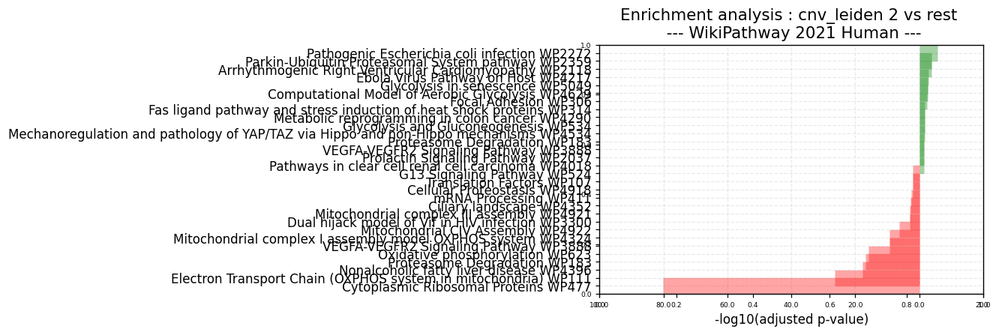

,index,Term,P-value,Z-score,Combined Score,Genes,Adjusted P-value,Old P-value,Old adjusted P-value,color
0,0,Cytoplasmic Ribosomal Proteins WP477,0.0,111.299331,21147.085349,"[RPL5, RPL30, RPL32, RPL31, RPL34, RPLP1, RPLP0, RPL10A, RPL8, RPL9, RPL6, RPL7, RPS4X, RPS15, RPL7A, RPS14, RPS17, RPS16, RPL18A, RPS19, RPS18, RPL35, RPLP2, RPS11, RPS10, RPS13, RPS12, RPS9, RPS7, RPL21, RPS8, RPL23, RPS5, RPS6, RPL22, RPL13A, RPSA, RPS3A, RPL24, RPL27, RPL26, UBA52, RPL10, RPL12, RPL11, RPL36A, RPS15A, RPL14, RPS3, RPL13, RPS2, RPL15, RPS27A, RPL18, RPL17, RPL19, RPL41, RPL35A, RPL23A, RPS25, RPS27, RPL27A, FAU, RPS24, RPS23]",-80.058899,0,0,red
1,1,Electron Transport Chain (OXPHOS system in mitochondria) WP111,0.0,19.84534,1306.143115,"[COX7B, NDUFB8, UQCRB, NDUFB10, NDUFB6, NDUFA12, NDUFB5, COX4I1, ATP5MC2, NDUFB2, ATP5MC3, COX7A2, UQCR11, COX6A1, COX5B, COX5A, UQCRFS1, NDUFV2, ATP5MG, COX8A, ATP5PF, NDUFA8, NDUFA4, NDUFC2, COX6C, ATP5F1C, SDHB, ATP5F1E, NDUFS8, NDUFS7, UQCRQ, NDUFS5, NDUFAB1, NDUFS3, ATP5PO]",-26.426723,0,0,red
2,2,Nonalcoholic fatty liver disease WP4396,0.0,10.359033,472.617126,"[NDUFA13, COX7B, NDUFB8, NDUFA11, UQCRB, NDUFB10, NDUFB6, NDUFA12, NDUFB5, COX4I1, NDUFB2, COX7A2, UQCR11, COX6A1, COX5B, COX5A, CDC42, UQCRFS1, CYC1, RAC1, NDUFV2, COX8A, NDUFA8, NDUFA4, NDUFC2, COX6C, SDHB, NDUFS8, NDUFS7, UQCRQ, NDUFS5, NDUFAB1, NDUFS3]",-17.833349,0,0,red
3,3,Proteasome Degradation WP183,0.0,20.701744,887.993357,"[UCHL3, PSMA7, PSMD8, PSMA5, PSMB6, PSMD9, PSMA6, PSMB7, PSMA3, PSMB4, PSMC5, PSMD7, PSMA4, PSMB5, PSMD4, PSMB2, UBB, PSMA2, PSMB3, PSMB1, PSME1, PSME2]",-16.773073,0,0,red
4,4,Oxidative phosphorylation WP623,0.0,20.229281,822.784275,"[ATP5PF, NDUFA8, NDUFB8, NDUFA11, NDUFB10, NDUFB6, NDUFB5, NDUFA4, ATP5MC2, NDUFB2, NDUFC2, ATP5MC3, ATP5F1E, NDUFS8, NDUFS7, NDUFS5, NDUFAB1, NDUFS3, ATP5PO, NDUFV2, ATP5MG]",-15.905120,0,0,red
5,5,VEGFA-VEGFR2 Signaling Pathway WP3888,0.0,3.907467,98.623521,"[RPL5, SET, ARPC5L, HSPB1, TXN, HMGB1, RPL10A, RPL7, CDC42, PSMD4, CAPZB, RPL18A, TMSB4X, CFL1, RACK1, AP2S1, RPLP2, SH3BGRL3, IGFBP7, ELOC, RAC1, RPS11, TMSB10, CLIC1, HSP90AA1, GPX1, SSR4, CAV1, RPS6, RPL13A, NAP1L1, RHOC, NFKBIA, NCL, RPL27, RPL26, EIF3F, PFN1, GAPDH, PTMA]",-9.281758,0,0,red
6,6,Mitochondrial complex I assembly model OXPHOS system WP4324,0.0,13.585552,339.970537,"[NDUFA8, NDUFA13, NDUFB8, NDUFB10, NDUFB6, NDUFA12, NDUFB5, NDUFB2, NDUFC2, NDUFS5, NDUFAB1, NDUFS3, NDUFAF3, TMEM126B, NDUFV2]",-9.255183,0,0,red
7,7,Mitochondrial CIV Assembly WP4922,0.0,14.725,262.349192,"[COX8A, COA3, COX7B, NDUFA4, COX4I1, COX7A2, COX6A1, COX5B, COX6C, COX5A]",-6.182852,0,0,red
8,8,Dual hijack model of Vif in HIV infection WP3300,0.000033,36.438202,375.72226,"[UBB, ELOB, ELOC, RBX1]",-2.974466,0,0,red
9,9,Mitochondrial complex III assembly WP4921,0.000047,16.587924,165.225872,"[UQCRB, UQCRQ, UQCRFS1, UQCR11, CYC1]",-2.867957,0,0,red


/u/davidm/Documents/Master-thesis/Scripts/RNA-seq/python/rnaseq/dea.py:38: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = pd.DataFrame(np.array(data[gene_set_library])[:,1:], columns=["Term", "P-value", "Z-score", "Combined Score", "Genes", "Adjusted P-value", "Old P-value", "Old adjusted P-value"])


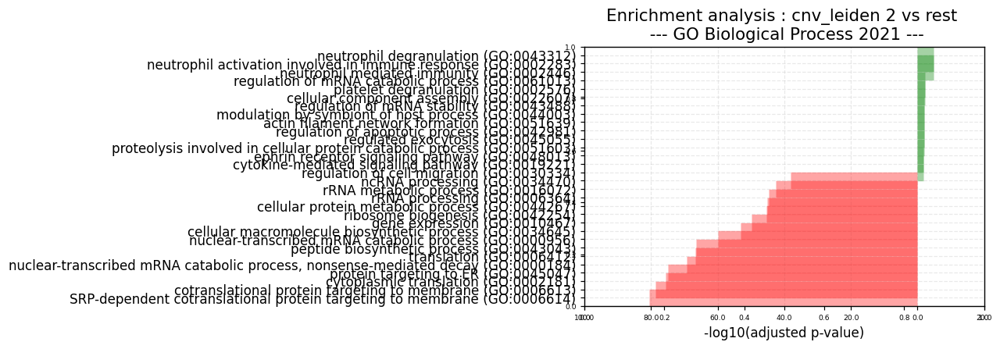

,index,Term,P-value,Z-score,Combined Score,Genes,Adjusted P-value,Old P-value,Old adjusted P-value,color
0,0,SRP-dependent cotranslational protein targeting to membrane (GO:0006614),0.0,113.251059,21906.431668,"[RPL5, RPL30, RPL32, RPL31, RPL34, RPLP1, RPLP0, RPL10A, RPL8, SRP14, RPL9, RPL6, RPL7, RPS15, RPS4X, RPL7A, RPS14, RPS17, RPS16, RPL18A, RPS19, RPS18, RPL35, RPLP2, SEC61B, RPS11, RPS10, RPS13, RPS12, RPS9, RPL21, RPS7, RPS8, RPL23, RPS5, RPL22, RPS6, RPL13A, RPS3A, RPSA, RPL24, RPL27, RPL26, UBA52, RPL10, RPL12, RPL11, RPL36A, RPS15A, RPL14, RPS3, RPL13, RPL15, RPS2, RPL18, RPS27A, RPL17, RPL19, RPL41, RPL35A, RPL23A, RPS25, RPS27, RPL27A, RPS24, RPS23]",-80.634846,0,0,red
1,1,cotranslational protein targeting to membrane (GO:0006613),0.0,97.052361,18296.559094,"[RPL5, RPL30, RPL32, RPL31, RPL34, RPLP1, RPLP0, RPL10A, RPL8, SRP14, RPL9, RPL6, RPL7, RPS15, RPS4X, RPL7A, RPS14, RPS17, RPS16, RPL18A, RPS19, RPS18, RPL35, RPLP2, RPS11, RPS10, RPS13, RPS12, RPS9, RPL21, RPS7, RPS8, RPL23, RPS5, SSR2, RPL22, RPS6, RPL13A, RPS3A, RPSA, RPL24, RPL27, RPL26, UBA52, RPL10, RPL12, RPL11, RPL36A, RPS15A, RPL14, RPS3, RPL13, RPL15, RPS2, RPL18, RPS27A, RPL17, RPL19, RPL41, RPL35A, RPL23A, RPS25, RPS27, RPL27A, RPS24, RPS23]",-78.803529,0,0,red
2,2,cytoplasmic translation (GO:0002181),0.0,90.478103,16341.582159,"[RPL5, RPL30, RPL32, RPL31, RPL34, RPLP1, RPLP0, RPL10A, RPL8, RPL9, RPL6, RPL7, RPS15, RPS4X, RPL7A, RPS14, RPS17, RPS16, RPL18A, RPS19, RPS18, RPL35, RPS11, RPS10, RPS13, RPS12, RPS9, RPL21, RPS7, RPS8, RPL23, RPS5, RPL22, RPS6, RPL13A, RPS3A, RPSA, RPL24, RPL27, RPL26, UBA52, RPL10, RPL12, RPL11, RPL36A, RPS15A, RPL14, RPS3, RPL13, RPL15, RPS2, RPL18, RPS27A, RPL17, RPL19, RPL41, TMA7, RPL35A, RPL23A, RPS25, RPS27, RPL27A, RPS24, RPS23]",-75.544835,0,0,red
3,3,protein targeting to ER (GO:0045047),0.0,73.411017,13127.462648,"[RPL5, RPL30, RPL32, RPL31, RPL34, RPLP1, RPLP0, RPL10A, RPL8, SRP14, RPL9, RPL6, RPL7, RPS15, RPS4X, RPS14, RPL7A, RPS17, RPS16, RPL18A, RPS19, RPS18, RPL35, RPLP2, RPS11, RPS10, RPS13, RPS12, RPS9, RPL21, RPS7, RPS8, RPL23, RPS5, RPL22, RPS6, RPL13A, RPSA, RPS3A, RPL24, RPL27, RPL26, UBA52, RPL10, RPL12, RPL11, RPL36A, RPS15A, RPL14, RPS3, RPL13, RPL15, RPS2, RPL18, RPS27A, RPL17, RPL19, RPL41, RPL35A, RPL23A, RPS25, RPS27, SPCS1, RPL27A, RPS24, RPS23]",-74.891412,0,0,red
4,4,"nuclear-transcribed mRNA catabolic process, nonsense-mediated decay (GO:0000184)",0.0,55.580955,9205.872833,"[RPL5, RPL30, RPL32, RPL31, RPL34, RPLP1, RPLP0, RPL10A, RPL8, RPL9, RPL6, RPL7, RPS15, RPS4X, RPS14, RPL7A, RPS17, RPS16, RPL18A, RPS19, RPS18, RPL35, RPLP2, RPS11, RPS10, RPS13, RPS12, RPS9, RPL21, RPS7, RPS8, RPL23, RPS5, RPL22, RPS6, RPL13A, RPSA, RPS3A, RPL24, RPL27, RPL26, UBA52, RBM8A, RPL10, RPL12, RPL11, RPL36A, RPS15A, RPL14, RPS3, RPL13, RPL15, RPS2, RPL18, RPS27A, RPL17, RPL19, RPL41, RPL35A, RPL23A, RPS25, RPS27, RPL27A, RPS24, RPS23]",-69.259353,0,0,red
5,5,translation (GO:0006412),0.0,25.194551,4026.320669,"[RPL5, RPL30, MRPS15, RPL32, RPL31, RPL34, RPLP1, RPLP0, RPL8, MRPL34, RPL10A, RPL9, RPL6, MRPL32, RPL7, RPS15, EEF1B2, RPS4X, RPS14, TRMT112, RPL7A, RPS17, RPS16, RPL18A, RPS19, RPS18, RPL35, RPLP2, RPS11, RPS10, RPS13, RPS12, RPS9, RPL21, RPS7, RPS8, RPL23, RPS5, RPL22, RPS6, MRPS18B, RPL13A, RPSA, RPS3A, MRPL51, PPA2, EEF1D, RPL24, RPL27, RPL26, EEF1E1, UBA52, RPL10, MRPL18, RPL12, MRPS34, RPL11, RPL36A, MRPL13, RPS15A, RPL14, RPS3, RPL13, RPL15, RPS2, RPL18, RPS27A, RPL17, RPL19, RPL41, TMA7, RPL35A, RPL23A, MRPL23, MRPL24, RPS25, RPS27, RPL27A, RPS24, RPS23]",-66.810591,0,0,red
6,6,peptide biosynthetic process (GO:0043043),0.0,33.256652,5280.074613,"[RPL5, RPL30, MRPS15, RPL32, RPL31, RPL34, RPLP1, RPLP0, RPL10A, RPL8, MRPL34, RPL9, RPL6, MRPL32, RPL7, RPS15, RPS4X, RPS14, RPL7A, RPS17, RPS16, RPL18A, RPS19, RPS18, RPL35, RPLP2, RPS11, RPS10, RPS13, RPS12, RPS9, RPL21, RPS7, RPS8, RPL23, RPS5, RPL22, RPS6, MRPS18B, RPL13A, RPSA, RPS3A, MRPL51, RPL24, RPL27, RPL26, RPL10, MRPL18, RPL12, RPL11, RPL3

/u/davidm/Documents/Master-thesis/Scripts/RNA-seq/python/rnaseq/dea.py:38: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = pd.DataFrame(np.array(data[gene_set_library])[:,1:], columns=["Term", "P-value", "Z-score", "Combined Score", "Genes", "Adjusted P-value", "Old P-value", "Old adjusted P-value"])


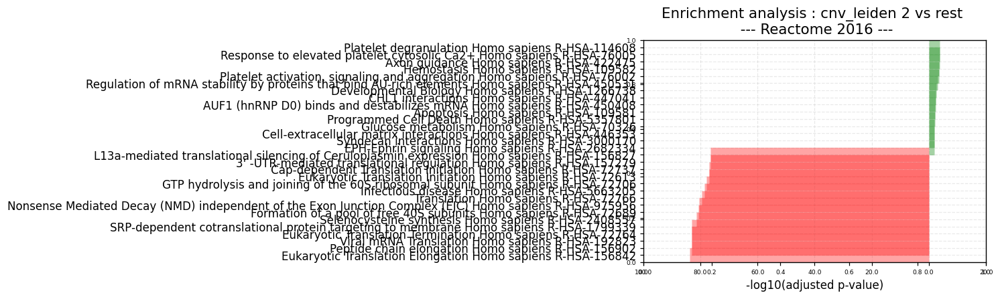

,index,Term,P-value,Z-score,Combined Score,Genes,Adjusted P-value,Old P-value,Old adjusted P-value,color
0,0,Eukaryotic Translation Elongation Homo sapiens R-HSA-156842,0.0,125.697742,25079.156144,"[RPL5, RPL30, RPL32, RPL31, RPL34, RPLP1, RPLP0, RPL10A, RPL8, RPL9, RPL6, RPL7, EEF1B2, RPS4X, RPS15, RPL7A, RPS14, RPS17, RPS16, RPL18A, RPS19, RPS18, RPL35, RPLP2, RPS11, RPS10, RPS13, RPS12, RPS9, RPL21, RPS7, RPS8, RPL23, RPS5, RPL22, RPS6, RPL13A, RPS3A, RPSA, EEF1D, RPL24, RPL27, RPL26, UBA52, RPL10, RPL12, RPL11, RPL36A, RPS15A, RPL14, RPS3, RPL13, RPL15, RPS2, RPL18, RPS27A, RPL17, RPL19, RPL41, RPL35A, RPL23A, RPS25, RPS27, RPL27A, FAU, RPS24, RPS23]",-83.712719,0,0,red
1,3,Peptide chain elongation Homo sapiens R-HSA-156902,0.0,140.624791,27670.57929,"[RPL5, RPL30, RPL32, RPL31, RPL34, RPLP1, RPLP0, RPL10A, RPL8, RPL9, RPL6, RPL7, RPS4X, RPS15, RPL7A, RPS14, RPS17, RPS16, RPL18A, RPS19, RPS18, RPL35, RPLP2, RPS11, RPS10, RPS13, RPS12, RPS9, RPL21, RPS7, RPS8, RPL23, RPS5, RPL22, RPS6, RPL13A, RPS3A, RPSA, RPL24, RPL27, RPL26, UBA52, RPL10, RPL12, RPL11, RPL36A, RPS15A, RPL14, RPS3, RPL13, RPL15, RPS2, RPL18, RPS27A, RPL17, RPL19, RPL41, RPL35A, RPL23A, RPS25, RPS27, RPL27A, FAU, RPS24, RPS23]",-83.120170,0,0,red
2,2,Viral mRNA Translation Homo sapiens R-HSA-192823,0.0,140.624791,27670.57929,"[RPL5, RPL30, RPL32, RPL31, RPL34, RPLP1, RPLP0, RPL10A, RPL8, RPL9, RPL6, RPL7, RPS4X, RPS15, RPL7A, RPS14, RPS17, RPS16, RPL18A, RPS19, RPS18, RPL35, RPLP2, RPS11, RPS10, RPS13, RPS12, RPS9, RPL21, RPS7, RPS8, RPL23, RPS5, RPL22, RPS6, RPL13A, RPS3A, RPSA, RPL24, RPL27, RPL26, UBA52, RPL10, RPL12, RPL11, RPL36A, RPS15A, RPL14, RPS3, RPL13, RPL15, RPS2, RPL18, RPS27A, RPL17, RPL19, RPL41, RPL35A, RPL23A, RPS25, RPS27, RPL27A, FAU, RPS24, RPS23]",-83.120170,0,0,red
3,1,Eukaryotic Translation Termination Homo sapiens R-HSA-72764,0.0,129.449758,25556.427964,"[RPL5, RPL30, RPL32, RPL31, RPL34, RPLP1, RPLP0, RPL10A, RPL8, RPL9, RPL6, RPL7, RPS4X, RPS15, TRMT112, RPL7A, RPS14, RPS17, RPS16, RPL18A, RPS19, RPS18, RPL35, RPLP2, RPS11, RPS10, RPS13, RPS12, RPS9, RPL21, RPS7, RPS8, RPL23, RPS5, RPL22, RPS6, RPL13A, RPS3A, RPSA, RPL24, RPL27, RPL26, UBA52, RPL10, RPL12, RPL11, RPL36A, RPS15A, RPL14, RPS3, RPL13, RPL15, RPS2, RPL18, RPS27A, RPL17, RPL19, RPL41, RPL35A, RPL23A, RPS25, RPS27, RPL27A, FAU, RPS24, RPS23]",-83.120170,0,0,red
4,4,SRP-dependent cotranslational protein targeting to membrane Homo sapiens R-HSA-1799339,0.0,82.039377,16116.935953,"[RPL5, RPL30, RPL32, RPL31, RPL34, RPLP1, RPLP0, SRP14, RPL8, RPL10A, RPL9, RPL6, RPL7, RPS15, RPS4X, RPS14, RPL7A, RPS17, RPS16, RPS19, RPL18A, RPS18, RPL35, RPLP2, SEC61B, RPS11, RPS10, RPS13, RPS12, RPS9, RPL21, RPS7, SSR4, RPS8, RPL23, RPS5, SSR2, RPL22, RPS6, RPL13A, RPSA, RPS3A, RPL24, RPL27, RPL26, UBA52, RPL10, RPL12, RPL11, RPL36A, RPS15A, RPL14, RPS3, RPL13, RPL15, RPS2, RPL18, RPS27A, RPL17, SEC11A, RPL19, RPL41, RPL35A, RPL23A, RPS25, RPS27, SPCS1, RPL27A, FAU, RPS24, RPS23]",-83.080193,0,0,red
5,5,Selenocysteine synthesis Homo sapiens R-HSA-2408557,0.0,121.429944,23388.314645,"[RPL5, RPL30, RPL32, RPL31, RPL34, RPLP1, RPLP0, RPL10A, RPL8, RPL9, RPL6, RPL7, RPS4X, RPS15, RPL7A, RPS14, RPS17, RPS16, RPL18A, RPS19, RPS18, RPL35, RPLP2, RPS11, RPS10, RPS13, RPS12, RPS9, RPL21, RPS7, RPS8, RPL23, RPS5, RPL22, RPS6, RPL13A, RPS3A, RPSA, RPL24, RPL27, RPL26, UBA52, RPL10, RPL12, RPL11, RPL36A, RPS15A, RPL14, RPS3, RPL13, RPL15, RPS2, RPL18, RPS27A, RPL17, RPL19, RPL41, RPL35A, RPL23A, RPS25, RPS27, RPL27A, FAU, RPS24, RPS23]",-81.488996,0,0,red
6,6,Formation of a pool of free 40S subunits Homo sapiens R-HSA-72689,0.0,95.322571,18182.044257,"[RPL5, RPL30, RPL32, RPL31, RPL34, RPLP1, RPLP0, RPL10A, RPL8, RPL9, RPL6, RPL7, RPS4X, RPS15, RPL7A, RPS14, RPS17, RPS16, RPL18A, RPS19, RPS18, RPL35, RPLP2, RPS11, RPS10, RPS13, RPS12, RPS9, RPL21, RPS7, RPS8, RPL23, RPS5, RPL22, RPS6, RPL13A, RPS3A, RPSA, RPL24, RPL27, RPL26, UBA52, RPL10, RPL12, RPL11, RPL36A, RPS15A, RPL14, RPS3, RPL13, RPL15, RPS2, 

In [471]:
rnaseq.dea.enrichr(sc, group = "2", libraries=["MSigDB_Hallmark_2020","KEGG_2021_Human","WikiPathway_2021_Human","GO_Biological_Process_2021", "Reactome_2016"], lfc_cutoff=0.5, top = 15, pval_cutoff_enr = 0.05,  pval_cutoff_de = 0.05)

#### cell cycle score

In [237]:
sc.var_names = sc.var["external_gene_name"].values
sc.var_names = np.array(sc.var_names.values)
sc.var_names_make_unique()
scanpy.tl.score_genes_cell_cycle(sc, s_genes=s_genes, g2m_genes=g2m_genes)

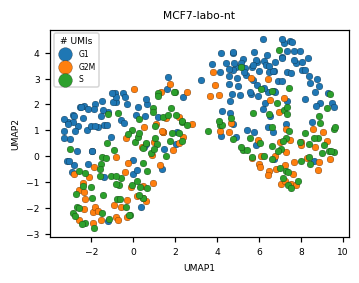

In [238]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["phase"], \
    s = 20, norm = LogNorm(), palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/ns_umap_umis.pdf", linewidth=0.15)

In [1662]:
np.unique(sc.var.loc[[g[0] for g in sc.uns["rank_genes_groups"]["names"]]]["chromosome_name"].values,return_counts=True)

(array(['1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19',
        '2', '20', '21', '22', '3', '4', '5', '6', '7', '8', '9', 'MT',
        'X'], dtype=object),
 array([211,  79,  95, 111,  28, 103,  67,  73, 120,  24, 118, 147,  58,
         19,  27, 115,  57, 104,  90, 110,  84,  75,   7,  79]))

### Stringent filtering

#### Filtering cells

In [316]:
rnaseq.pp.filter_cells(sc, n_counts_min = 1300, mt_max = 0.05, inplace = False)

#### Number of cells after manual filtering

In [317]:
(sc.obs["keep"] == "True").sum()

1223

#### QC after filtering

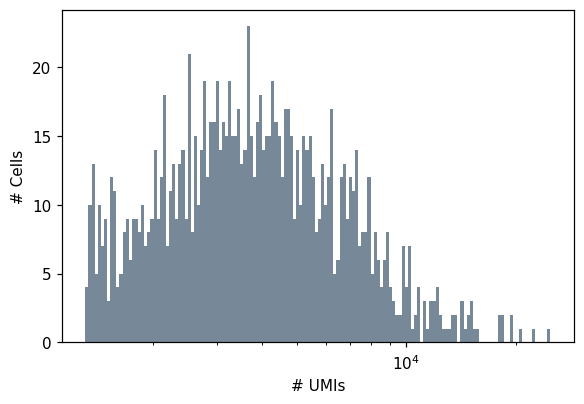

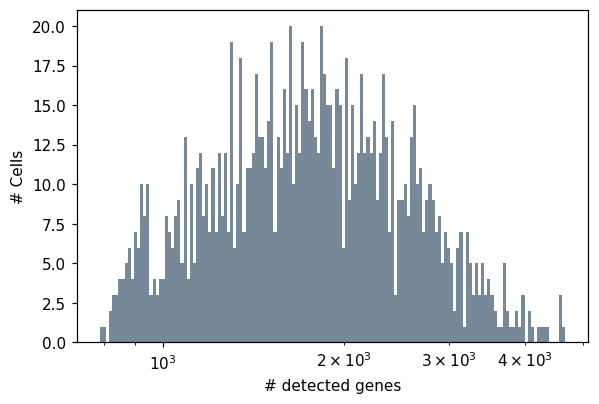

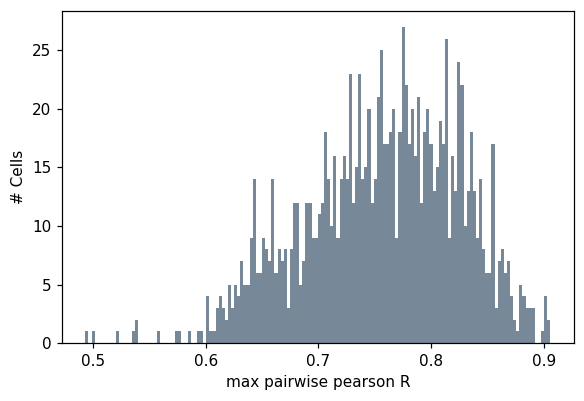

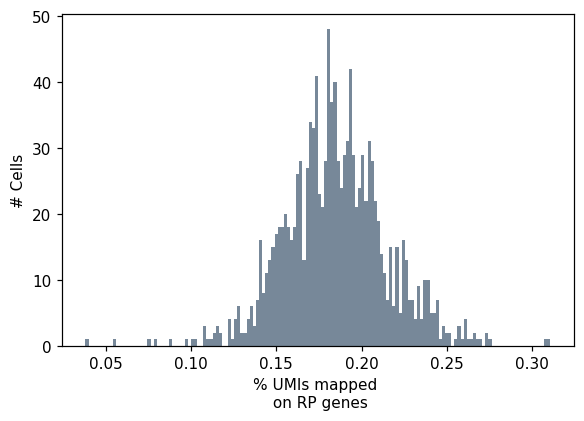

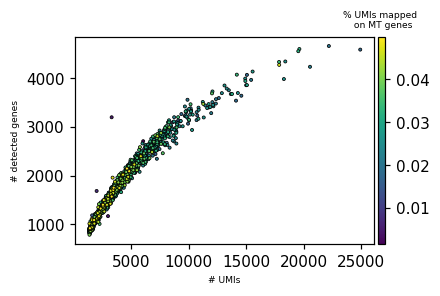

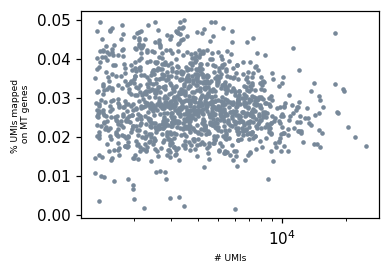

In [318]:
rnaseq.pp.plot_qc(sc[sc.obs["keep"] == "True"])

#### Umap

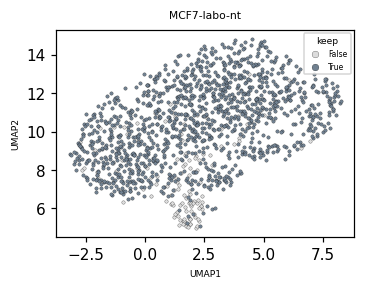

In [321]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.obs["keep"], \
    s = 5, norm = LogNorm(), palette = {"True" : "slategray", "False" : "gainsboro"}, xlabel="UMAP1", ylabel="UMAP2", color_title = "keep",\
    title = new_sample_name, save = "./figs/ns_umap_s.pdf", linewidth=0.15)

#### New Umap

Normalization by total UMIs...
Log2 + 1 tranformation...


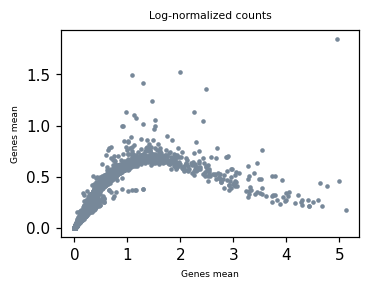

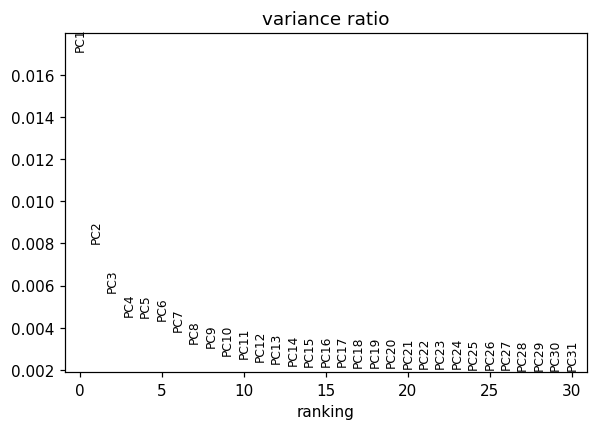

In [322]:
sc_s = sc.copy()
sc_s._inplace_subset_obs(sc_s.obs["keep"] == "True")

rnaseq.pp.log_norm(sc_s, plot=True, inplace=True, ow = True)
scanpy.pp.pca(sc_s)
scanpy.pl.pca_variance_ratio(sc_s)

In [323]:
scanpy.pp.neighbors(sc_s, n_pcs = 15, n_neighbors = 25)
scanpy.tl.umap(sc_s)

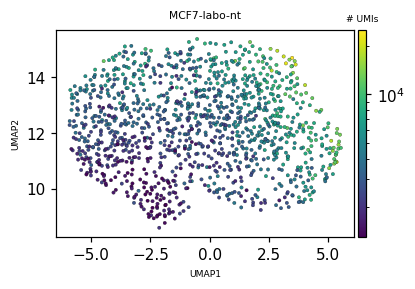

In [326]:
rnaseq.plotting.scatter(sc_s.obsm["X_umap"][:,0], sc_s.obsm["X_umap"][:,1], color = sc_s.obs["total_UMIs"], \
    s = 5, norm = LogNorm(), palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "# UMIs",\
    title = new_sample_name, save = "./figs/s_umap_umis.pdf", linewidth=0.15)

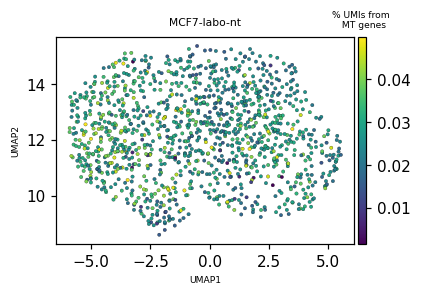

In [329]:
rnaseq.plotting.scatter(sc_s.obsm["X_umap"][:,0], sc_s.obsm["X_umap"][:,1], color = sc_s.obs["mt_frac"], \
    s = 5, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "% UMIs from \n MT genes",\
    title = new_sample_name, save = "./figs/s_umap_mt.pdf", linewidth=0.15)

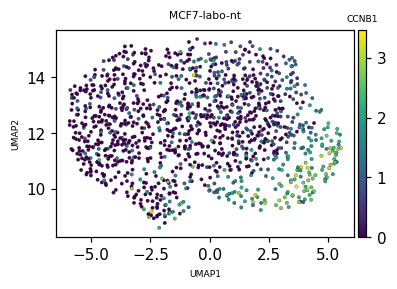

In [330]:
rnaseq.plotting.scatter(sc_s.obsm["X_umap"][:,0], sc_s.obsm["X_umap"][:,1], color = sc_s.X.toarray()[:, sc_s.var["external_gene_name"].values == "CCNB1"], \
    s = 5, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "CCNB1",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15)

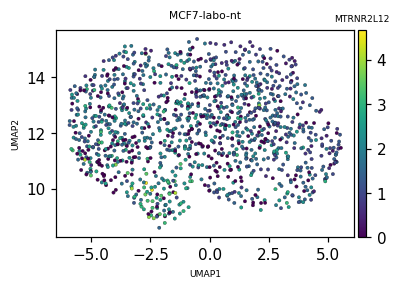

In [350]:
rnaseq.plotting.scatter(sc_s.obsm["X_umap"][:,0], sc_s.obsm["X_umap"][:,1], color = sc_s.X.toarray()[:, sc_s.var["external_gene_name"].values == "MTRNR2L12"], \
    s = 5, palette = "viridis", xlabel="UMAP1", ylabel="UMAP2", color_title = "MTRNR2L12",\
    title = new_sample_name, save = "./figs/s_umap_CCNB1.pdf", linewidth=0.15)

In [343]:
scanpy.tl.louvain(sc_s, key_added="louvain", resolution = 0.55, directed=False)

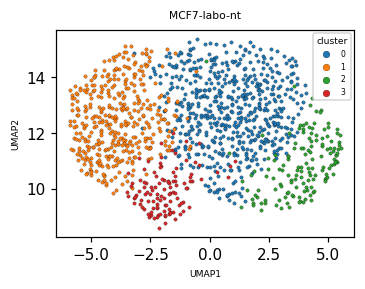

In [344]:
rnaseq.plotting.scatter(sc_s.obsm["X_umap"][:,0], sc_s.obsm["X_umap"][:,1], color = sc_s.obs["louvain"], \
    s = 5, xlabel="UMAP1", ylabel="UMAP2", color_title = "cluster", title = new_sample_name, linewidth=0.15)

In [345]:
sc.var_names = sc.var["external_gene_name"].values
scanpy.tl.rank_genes_groups(sc, groupby="louvain", groups = ["3"], reference = "rest", method = "wilcoxon", n_genes=2000, rankby_abs=True)

... storing 'samples' as categorical
... storing 'project_id' as categorical
... storing 'conditions' as categorical
... storing 'cell_lines' as categorical
... storing 'source' as categorical
... storing 'keep' as categorical
... storing 'chromosome_name' as categorical
... storing 'external_gene_name' as categorical


/u/davidm/Documents/Master-thesis/Scripts/RNA-seq/python/rnaseq/dea.py:37: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  x = pd.DataFrame(np.array(data[gene_set_library])[:,1:], columns=["Term", "P-value", "Z-score", "Combined Score", "Genes", "Adjusted P-value", "Old P-value", "Old adjusted P-value"])
/u/davidm/Documents/Master-thesis/Scripts/RNA-seq/python/rnaseq/dea.py:89: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = plt.axes()


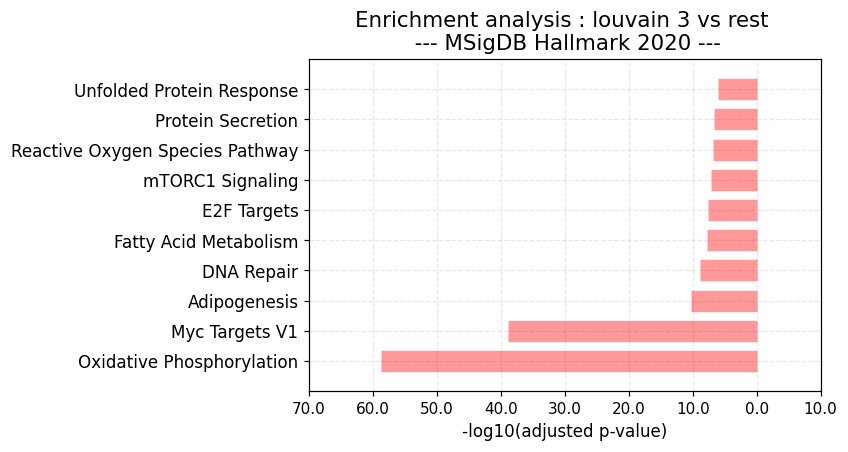

In [347]:
rnaseq.dea.enrichr(sc, group = "3", libraries="MSigDB_Hallmark_2020", lfc_cutoff=0.5);

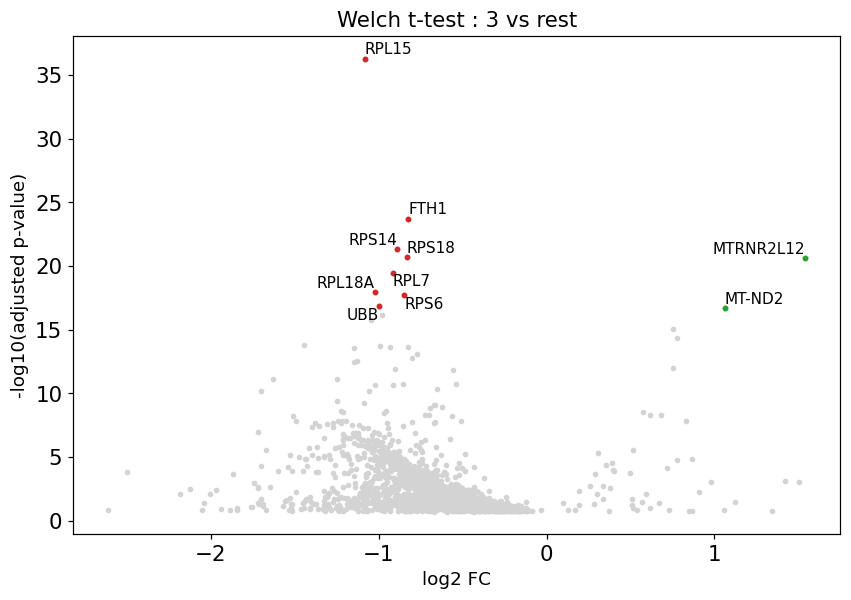

In [348]:
rnaseq.dea.volcano_plot(sc, group="3", top = 10)

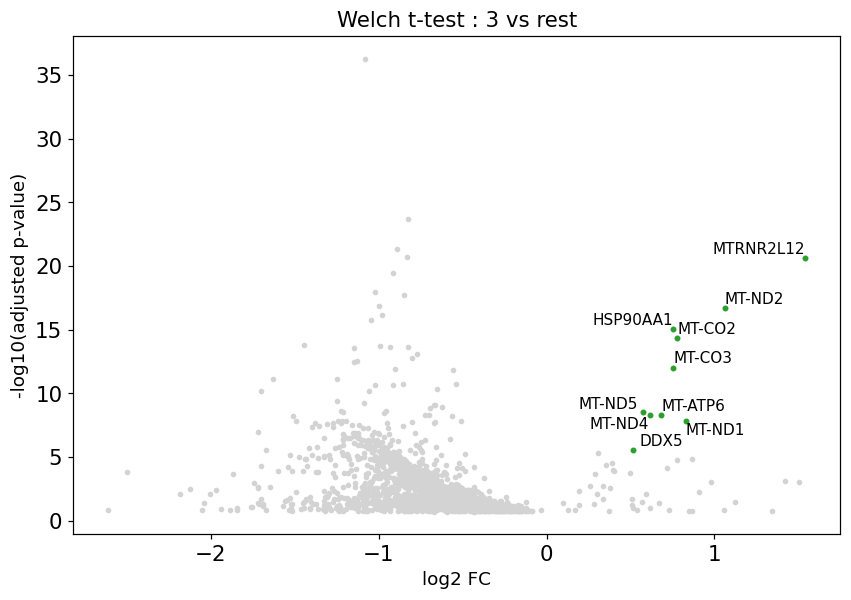

In [352]:
rnaseq.dea.volcano_plot(sc, group="3", top = 10, show_genes = "up")

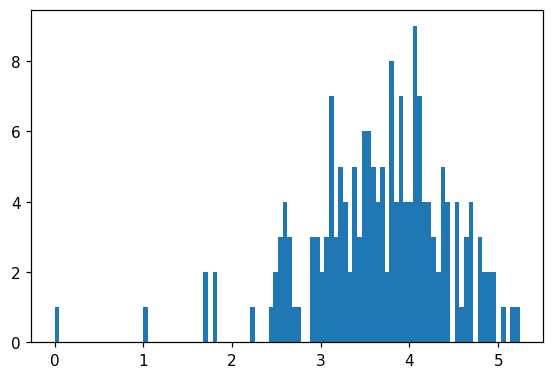

In [355]:
plt.hist(sc.X.toarray()[sc.obs["louvain"] == "3", sc.var["external_gene_name"] == "HSP90AA1"].ravel(), bins=100);

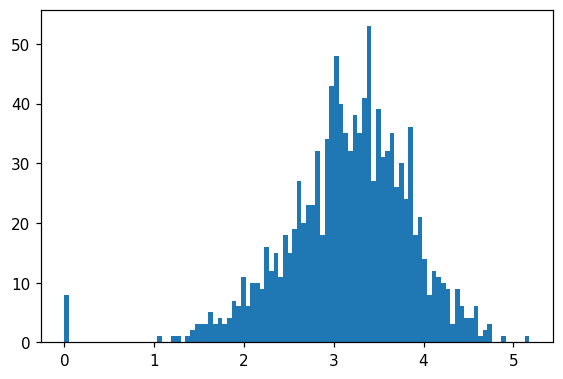

In [356]:
plt.hist(sc.X.toarray()[~(sc.obs["louvain"] == "3"), sc.var["external_gene_name"] == "HSP90AA1"].ravel(), bins=100);

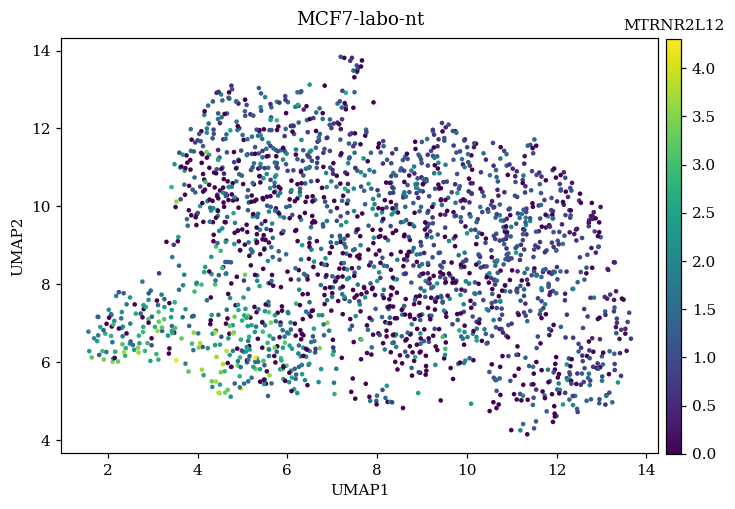

In [148]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"] == "MTRNR2L12"].ravel(), \
    s = 4, xlabel="UMAP1", ylabel="UMAP2", color_title = "MTRNR2L12", title = new_sample_name)

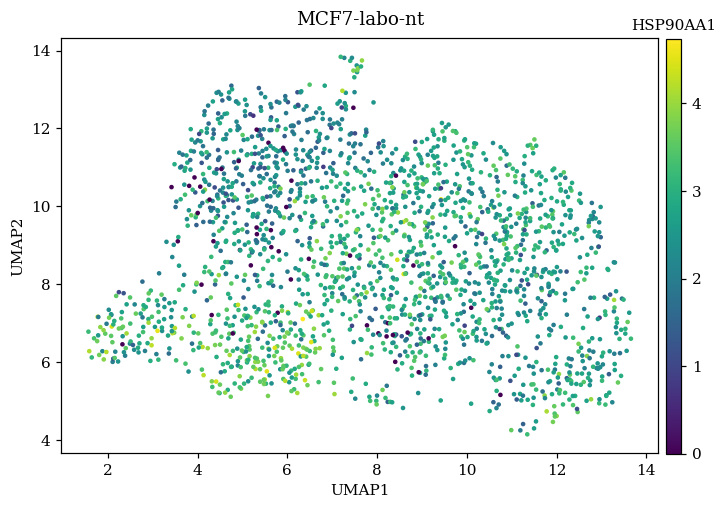

In [149]:
rnaseq.plotting.scatter(sc.obsm["X_umap"][:,0], sc.obsm["X_umap"][:,1], color = sc.X.toarray()[:, sc.var["external_gene_name"] == "HSP90AA1"].ravel(), \
    s = 4, xlabel="UMAP1", ylabel="UMAP2", color_title = "HSP90AA1", title = new_sample_name)

In [252]:
# del sc.layers["log_norm"]
# rnaseq.setup.load_layer(sc, "raw")
# sc._inplace_subset_obs(sc.obs["keep"] == "True")

# rnaseq.readwrite.write_filtered(sc, "/home/arion/davidm/Data/datasets/processed/Projects/scBC-Analysis/filtered_data")

/u/davidm/VirtualEns/python_3.6.8/lib64/python3.6/site-packages/anndata/_core/anndata.py:119: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


### Write filtered anndata

In [60]:
%%bash
tar czf ./figs.tar.gz ./figs/*.pdf